# 0. Load functions

In [21]:
# %matplotlib notebook

import os, h5py, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from tqdm import tqdm

import wandb
import torch
import torchvision
import torch.nn as nn
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms, models

sys.path.append('../')
from visualize_functions import visualize_predictions, label_violinplot 
from fitting_functions import load_multiple_curves, remove_outlier
from DL_functions import prepare_dataloader, linear_fit_model, train, analyze_curves_dl, visualize_predictions

plt.rcParams.update(mpl.rcParamsDefault)

color_green = (27/255,158/255,119/255)
color_orange = (217/255,95/255,2/255)
color_purple = (117/255,112/255,179/255)

rc_plot = {'figure.figsize':(12,2.5),
          'axes.facecolor':'white',
          'axes.grid': False,
          'axes.titlesize': 18,
          'axes.labelsize': 18,

          'xtick.labelsize': 14,
          'xtick.direction': 'in',
          'xtick.top': True,
          'xtick.bottom': True,
          'xtick.labelbottom': True,
          'xtick.labeltop': False,
          
          'ytick.labelsize': 14,
          'ytick.direction': 'in',
          'ytick.right': True,
          'ytick.left': True,
          'ytick.labelleft': True,
          'ytick.labelright': False,

          'legend.fontsize': 10,
          'font.family': 'sans-serif'}

rc_img = {'figure.figsize':(8,8),
          'axes.facecolor':'white',
          'axes.grid': False,
          'axes.titlesize': 18,
          'axes.labelsize': 14,
          
          'xtick.labelsize': 12,
          'xtick.direction': 'in',
          'xtick.top': False,
          'xtick.bottom': False,
          'xtick.labelbottom': False,
          'xtick.labeltop': False,
          
          'ytick.labelsize': 12,
          'ytick.direction': 'in',
          'ytick.right': False,
          'ytick.left': False,
          'ytick.labelleft': False,
          'ytick.labelright': False,

          'legend.fontsize': 8,
          'font.family': 'sans-serif'}

# 1. Test 6

In [2]:
h5_para_file = '../../data/test6_gaussian_fit_parameters_all.h5'
spot = 'spot_2'
metric = 'img_intensity'
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3}
length = 500
I_diff = 12000

## 1.1 Train model

In [3]:
dl, xs_processed, ys_nor_all = prepare_dataloader(h5_para_file, spot, metric, growth_dict, camera_freq=500, 
                                                  length=length, I_diff=I_diff, unify=True, batch_size=32, 
                                                  savgol_window_order=None, pca_component=None, visualize=True)
model = linear_fit_model()
y_fit, parameters = model(torch.randn(32, 1, 500))
print(y_fit.shape, parameters.shape)

NAME = f'test6_model-baseline'
model_path = '../models/'+NAME+'.pt'
wandb.init(project='RHEED_model', entity='yig319', name=NAME, id=NAME)

device = torch.device('cpu')

lr = 1e-3
loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

start = 0
epochs = 500
scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, epochs=epochs, max_lr=lr, 
                            steps_per_epoch=len(dl))

train(model, dl, epochs, start, device, loss_func, optimizer, scheduler, model_path, tracking=True)

torch.Size([32, 1, 500]) torch.Size([32, 3])


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: yig319. Use `wandb login --relogin` to force relogin


Epoch: 1/500


100%|██████████| 7/7 [00:00<00:00, 15.61it/s]


Training Loss: 0.0902
Epoch: 2/500


100%|██████████| 7/7 [00:00<00:00, 30.49it/s]


Training Loss: 0.0081
Epoch: 3/500


100%|██████████| 7/7 [00:00<00:00, 30.47it/s]


Training Loss: 0.0064
Epoch: 4/500


100%|██████████| 7/7 [00:00<00:00, 33.19it/s]


Training Loss: 0.0056
Epoch: 5/500


100%|██████████| 7/7 [00:00<00:00, 30.38it/s]


Training Loss: 0.0058
Epoch: 6/500


100%|██████████| 7/7 [00:00<00:00, 25.57it/s]


Training Loss: 0.0046
Epoch: 7/500


100%|██████████| 7/7 [00:00<00:00, 35.92it/s]


Training Loss: 0.0042
Epoch: 8/500


100%|██████████| 7/7 [00:00<00:00, 39.46it/s]


Training Loss: 0.0034
Epoch: 9/500


100%|██████████| 7/7 [00:00<00:00, 38.96it/s]


Training Loss: 0.0038
Epoch: 10/500


100%|██████████| 7/7 [00:00<00:00, 40.13it/s]


Training Loss: 0.0035
Epoch: 11/500


100%|██████████| 7/7 [00:00<00:00, 42.02it/s]


Training Loss: 0.0028
Epoch: 12/500


100%|██████████| 7/7 [00:00<00:00, 40.83it/s]


Training Loss: 0.0029
Epoch: 13/500


100%|██████████| 7/7 [00:00<00:00, 44.60it/s]


Training Loss: 0.0025
Epoch: 14/500


100%|██████████| 7/7 [00:00<00:00, 42.83it/s]


Training Loss: 0.0025
Epoch: 15/500


100%|██████████| 7/7 [00:00<00:00, 25.77it/s]


Training Loss: 0.0030
Epoch: 16/500


100%|██████████| 7/7 [00:00<00:00, 32.19it/s]


Training Loss: 0.0024
Epoch: 17/500


100%|██████████| 7/7 [00:00<00:00, 37.66it/s]


Training Loss: 0.0023
Epoch: 18/500


100%|██████████| 7/7 [00:00<00:00, 42.40it/s]


Training Loss: 0.0023
Epoch: 19/500


100%|██████████| 7/7 [00:00<00:00, 47.14it/s]


Training Loss: 0.0024
Epoch: 20/500


100%|██████████| 7/7 [00:00<00:00, 45.87it/s]


Training Loss: 0.0024
Epoch: 21/500


100%|██████████| 7/7 [00:00<00:00, 49.53it/s]


Training Loss: 0.0025
Epoch: 22/500


100%|██████████| 7/7 [00:00<00:00, 48.93it/s]


Training Loss: 0.0023
Epoch: 23/500


100%|██████████| 7/7 [00:00<00:00, 25.42it/s]


Training Loss: 0.0027
Epoch: 24/500


100%|██████████| 7/7 [00:00<00:00, 43.87it/s]


Training Loss: 0.0021
Epoch: 25/500


100%|██████████| 7/7 [00:00<00:00, 25.64it/s]


Training Loss: 0.0026
Epoch: 26/500


100%|██████████| 7/7 [00:00<00:00, 31.32it/s]


Training Loss: 0.0023
Epoch: 27/500


100%|██████████| 7/7 [00:00<00:00, 45.69it/s]


Training Loss: 0.0029
Epoch: 28/500


100%|██████████| 7/7 [00:00<00:00, 45.49it/s]

Training Loss: 0.0023


Epoch: 29/500


100%|██████████| 7/7 [00:00<00:00, 35.73it/s]


Training Loss: 0.0027
Epoch: 30/500


100%|██████████| 7/7 [00:00<00:00, 47.38it/s]


Training Loss: 0.0038
Epoch: 31/500


100%|██████████| 7/7 [00:00<00:00, 42.15it/s]


Training Loss: 0.0026
Epoch: 32/500


100%|██████████| 7/7 [00:00<00:00, 43.49it/s]


Training Loss: 0.0028
Epoch: 33/500


100%|██████████| 7/7 [00:00<00:00, 42.50it/s]


Training Loss: 0.0028
Epoch: 34/500


100%|██████████| 7/7 [00:00<00:00, 48.52it/s]


Training Loss: 0.0025
Epoch: 35/500


100%|██████████| 7/7 [00:00<00:00, 22.98it/s]


Training Loss: 0.0024
Epoch: 36/500


100%|██████████| 7/7 [00:00<00:00, 42.51it/s]


Training Loss: 0.0025
Epoch: 37/500


100%|██████████| 7/7 [00:00<00:00, 43.08it/s]

Training Loss: 0.0027


Epoch: 38/500


100%|██████████| 7/7 [00:00<00:00, 48.10it/s]


Training Loss: 0.0023
Epoch: 39/500


100%|██████████| 7/7 [00:00<00:00, 42.68it/s]


Training Loss: 0.0026
Epoch: 40/500


100%|██████████| 7/7 [00:00<00:00, 44.14it/s]


Training Loss: 0.0026
Epoch: 41/500


100%|██████████| 7/7 [00:00<00:00, 45.83it/s]


Training Loss: 0.0028
Epoch: 42/500


100%|██████████| 7/7 [00:00<00:00, 47.57it/s]


Training Loss: 0.0029
Epoch: 43/500


100%|██████████| 7/7 [00:00<00:00, 34.63it/s]


Training Loss: 0.0026
Epoch: 44/500


100%|██████████| 7/7 [00:00<00:00, 29.48it/s]


Training Loss: 0.0031
Epoch: 45/500


100%|██████████| 7/7 [00:00<00:00, 45.78it/s]


Training Loss: 0.0029
Epoch: 46/500


100%|██████████| 7/7 [00:00<00:00, 44.05it/s]


Training Loss: 0.0043
Epoch: 47/500


100%|██████████| 7/7 [00:00<00:00, 24.03it/s]


Training Loss: 0.0028
Epoch: 48/500


100%|██████████| 7/7 [00:00<00:00, 28.69it/s]


Training Loss: 0.0028
Epoch: 49/500


100%|██████████| 7/7 [00:00<00:00, 46.23it/s]


Training Loss: 0.0028
Epoch: 50/500


100%|██████████| 7/7 [00:00<00:00, 47.55it/s]


Training Loss: 0.0032
Epoch: 51/500


100%|██████████| 7/7 [00:00<00:00, 43.26it/s]


Training Loss: 0.0036
Epoch: 52/500


100%|██████████| 7/7 [00:00<00:00, 43.29it/s]

Training Loss: 0.0029


Epoch: 53/500


100%|██████████| 7/7 [00:00<00:00, 29.43it/s]


Training Loss: 0.0030
Epoch: 54/500


100%|██████████| 7/7 [00:00<00:00, 47.40it/s]


Training Loss: 0.0026
Epoch: 55/500


100%|██████████| 7/7 [00:00<00:00, 45.49it/s]


Training Loss: 0.0034
Epoch: 56/500


100%|██████████| 7/7 [00:00<00:00, 45.56it/s]

Training Loss: 0.0024


Epoch: 57/500


100%|██████████| 7/7 [00:00<00:00, 46.77it/s]


Training Loss: 0.0026
Epoch: 58/500


100%|██████████| 7/7 [00:00<00:00, 36.08it/s]


Training Loss: 0.0023
Epoch: 59/500


100%|██████████| 7/7 [00:00<00:00, 23.42it/s]


Training Loss: 0.0036
Epoch: 60/500


100%|██████████| 7/7 [00:00<00:00, 44.81it/s]


Training Loss: 0.0024
Epoch: 61/500


100%|██████████| 7/7 [00:00<00:00, 33.30it/s]


Training Loss: 0.0030
Epoch: 62/500


100%|██████████| 7/7 [00:00<00:00, 43.11it/s]


Training Loss: 0.0026
Epoch: 63/500


100%|██████████| 7/7 [00:00<00:00, 44.67it/s]


Training Loss: 0.0021
Epoch: 64/500


100%|██████████| 7/7 [00:00<00:00, 45.18it/s]

Training Loss: 0.0021


Epoch: 65/500


100%|██████████| 7/7 [00:00<00:00, 43.70it/s]


Training Loss: 0.0021
Epoch: 66/500


100%|██████████| 7/7 [00:00<00:00, 46.09it/s]


Training Loss: 0.0034
Epoch: 67/500


100%|██████████| 7/7 [00:00<00:00, 40.49it/s]

Training Loss: 0.0021


Epoch: 68/500


100%|██████████| 7/7 [00:00<00:00, 48.40it/s]


Training Loss: 0.0024
Epoch: 69/500


100%|██████████| 7/7 [00:00<00:00, 46.31it/s]


Training Loss: 0.0025
Epoch: 70/500


100%|██████████| 7/7 [00:00<00:00, 44.57it/s]


Training Loss: 0.0025
Epoch: 71/500


100%|██████████| 7/7 [00:00<00:00, 33.00it/s]


Training Loss: 0.0022
Epoch: 72/500


100%|██████████| 7/7 [00:00<00:00, 21.66it/s]


Training Loss: 0.0021
Epoch: 73/500


100%|██████████| 7/7 [00:00<00:00, 44.32it/s]


Training Loss: 0.0025
Epoch: 74/500


100%|██████████| 7/7 [00:00<00:00, 45.66it/s]


Training Loss: 0.0026
Epoch: 75/500


100%|██████████| 7/7 [00:00<00:00, 45.76it/s]


Training Loss: 0.0026
Epoch: 76/500


100%|██████████| 7/7 [00:00<00:00, 45.25it/s]


Training Loss: 0.0021
Epoch: 77/500


100%|██████████| 7/7 [00:00<00:00, 39.94it/s]

Training Loss: 0.0022


Epoch: 78/500


100%|██████████| 7/7 [00:00<00:00, 45.39it/s]


Training Loss: 0.0024
Epoch: 79/500


100%|██████████| 7/7 [00:00<00:00, 44.98it/s]

Training Loss: 0.0022


Epoch: 80/500


100%|██████████| 7/7 [00:00<00:00, 43.59it/s]


Training Loss: 0.0023
Epoch: 81/500


100%|██████████| 7/7 [00:00<00:00, 34.39it/s]


Training Loss: 0.0025
Epoch: 82/500


100%|██████████| 7/7 [00:00<00:00, 46.16it/s]


Training Loss: 0.0024
Epoch: 83/500


100%|██████████| 7/7 [00:00<00:00, 26.50it/s]


Training Loss: 0.0031
Epoch: 84/500


100%|██████████| 7/7 [00:00<00:00, 32.31it/s]


Training Loss: 0.0030
Epoch: 85/500


100%|██████████| 7/7 [00:00<00:00, 36.31it/s]


Training Loss: 0.0033
Epoch: 86/500


100%|██████████| 7/7 [00:00<00:00, 35.45it/s]


Training Loss: 0.0028
Epoch: 87/500


100%|██████████| 7/7 [00:00<00:00, 44.72it/s]


Training Loss: 0.0025
Epoch: 88/500


100%|██████████| 7/7 [00:00<00:00, 38.18it/s]

Training Loss: 0.0021


Epoch: 89/500


100%|██████████| 7/7 [00:00<00:00, 29.37it/s]


Training Loss: 0.0031
Epoch: 90/500


100%|██████████| 7/7 [00:00<00:00, 47.25it/s]


Training Loss: 0.0036
Epoch: 91/500


100%|██████████| 7/7 [00:00<00:00, 43.58it/s]

Training Loss: 0.0027


Epoch: 92/500


100%|██████████| 7/7 [00:00<00:00, 43.55it/s]


Training Loss: 0.0027
Epoch: 93/500


100%|██████████| 7/7 [00:00<00:00, 46.17it/s]


Training Loss: 0.0028
Epoch: 94/500


100%|██████████| 7/7 [00:00<00:00, 47.52it/s]


Training Loss: 0.0041
Epoch: 95/500


100%|██████████| 7/7 [00:00<00:00, 28.03it/s]


Training Loss: 0.0027
Epoch: 96/500


100%|██████████| 7/7 [00:00<00:00, 44.41it/s]


Training Loss: 0.0036
Epoch: 97/500


100%|██████████| 7/7 [00:00<00:00, 39.76it/s]


Training Loss: 0.0028
Epoch: 98/500


100%|██████████| 7/7 [00:00<00:00, 32.51it/s]


Training Loss: 0.0021
Epoch: 99/500


100%|██████████| 7/7 [00:00<00:00, 43.78it/s]


Training Loss: 0.0031
Epoch: 100/500


100%|██████████| 7/7 [00:00<00:00, 35.19it/s]


Training Loss: 0.0024
Epoch: 101/500


100%|██████████| 7/7 [00:00<00:00, 46.52it/s]


Training Loss: 0.0025
Epoch: 102/500


100%|██████████| 7/7 [00:00<00:00, 46.76it/s]


Training Loss: 0.0020
Epoch: 103/500


100%|██████████| 7/7 [00:00<00:00, 42.02it/s]

Training Loss: 0.0021


Epoch: 104/500


100%|██████████| 7/7 [00:00<00:00, 46.89it/s]


Training Loss: 0.0027
Epoch: 105/500


100%|██████████| 7/7 [00:00<00:00, 44.02it/s]


Training Loss: 0.0037
Epoch: 106/500


100%|██████████| 7/7 [00:00<00:00, 41.14it/s]


Training Loss: 0.0028
Epoch: 107/500


100%|██████████| 7/7 [00:00<00:00, 23.53it/s]


Training Loss: 0.0028
Epoch: 108/500


100%|██████████| 7/7 [00:00<00:00, 44.69it/s]


Training Loss: 0.0024
Epoch: 109/500


100%|██████████| 7/7 [00:00<00:00, 44.80it/s]


Training Loss: 0.0024
Epoch: 110/500


100%|██████████| 7/7 [00:00<00:00, 29.94it/s]


Training Loss: 0.0021
Epoch: 111/500


100%|██████████| 7/7 [00:00<00:00, 46.73it/s]


Training Loss: 0.0022
Epoch: 112/500


100%|██████████| 7/7 [00:00<00:00, 45.24it/s]


Training Loss: 0.0021
Epoch: 113/500


100%|██████████| 7/7 [00:00<00:00, 45.80it/s]


Training Loss: 0.0023
Epoch: 114/500


100%|██████████| 7/7 [00:00<00:00, 45.96it/s]

Training Loss: 0.0024


Epoch: 115/500


100%|██████████| 7/7 [00:00<00:00, 34.45it/s]


Training Loss: 0.0023
Epoch: 116/500


100%|██████████| 7/7 [00:00<00:00, 41.95it/s]


Training Loss: 0.0024
Epoch: 117/500


100%|██████████| 7/7 [00:00<00:00, 43.81it/s]

Training Loss: 0.0023


Epoch: 118/500


100%|██████████| 7/7 [00:00<00:00, 35.59it/s]


Training Loss: 0.0024
Epoch: 119/500


100%|██████████| 7/7 [00:00<00:00, 35.93it/s]


Training Loss: 0.0025
Epoch: 120/500


100%|██████████| 7/7 [00:00<00:00, 36.15it/s]


Training Loss: 0.0026
Epoch: 121/500


100%|██████████| 7/7 [00:00<00:00, 39.59it/s]


Training Loss: 0.0027
Epoch: 122/500


100%|██████████| 7/7 [00:00<00:00, 38.62it/s]


Training Loss: 0.0031
Epoch: 123/500


100%|██████████| 7/7 [00:00<00:00, 42.59it/s]


Training Loss: 0.0025
Epoch: 124/500


100%|██████████| 7/7 [00:00<00:00, 46.62it/s]


Training Loss: 0.0023
Epoch: 125/500


100%|██████████| 7/7 [00:00<00:00, 46.44it/s]


Training Loss: 0.0022
Epoch: 126/500


100%|██████████| 7/7 [00:00<00:00, 46.66it/s]


Training Loss: 0.0022
Epoch: 127/500


100%|██████████| 7/7 [00:00<00:00, 46.05it/s]

Training Loss: 0.0023


Epoch: 128/500


100%|██████████| 7/7 [00:00<00:00, 44.48it/s]


Training Loss: 0.0029
Epoch: 129/500


100%|██████████| 7/7 [00:00<00:00, 35.81it/s]


Training Loss: 0.0022
Epoch: 130/500


100%|██████████| 7/7 [00:00<00:00, 39.82it/s]


Training Loss: 0.0024
Epoch: 131/500


100%|██████████| 7/7 [00:00<00:00, 25.82it/s]


Training Loss: 0.0023
Epoch: 132/500


100%|██████████| 7/7 [00:00<00:00, 36.12it/s]


Training Loss: 0.0022
Epoch: 133/500


100%|██████████| 7/7 [00:00<00:00, 46.44it/s]


Training Loss: 0.0030
Epoch: 134/500


100%|██████████| 7/7 [00:00<00:00, 48.51it/s]


Training Loss: 0.0031
Epoch: 135/500


100%|██████████| 7/7 [00:00<00:00, 46.35it/s]


Training Loss: 0.0023
Epoch: 136/500


100%|██████████| 7/7 [00:00<00:00, 47.82it/s]


Training Loss: 0.0024
Epoch: 137/500


100%|██████████| 7/7 [00:00<00:00, 47.26it/s]


Training Loss: 0.0041
Epoch: 138/500


100%|██████████| 7/7 [00:00<00:00, 47.41it/s]


Training Loss: 0.0027
Epoch: 139/500


100%|██████████| 7/7 [00:00<00:00, 44.88it/s]

Training Loss: 0.0027


Epoch: 140/500


100%|██████████| 7/7 [00:00<00:00, 28.82it/s]


Training Loss: 0.0026
Epoch: 141/500


100%|██████████| 7/7 [00:00<00:00, 47.45it/s]


Training Loss: 0.0034
Epoch: 142/500


100%|██████████| 7/7 [00:00<00:00, 36.09it/s]

Training Loss: 0.0024


Epoch: 143/500


100%|██████████| 7/7 [00:00<00:00, 27.03it/s]


Training Loss: 0.0025
Epoch: 144/500


100%|██████████| 7/7 [00:00<00:00, 30.69it/s]


Training Loss: 0.0031
Epoch: 145/500


100%|██████████| 7/7 [00:00<00:00, 45.06it/s]


Training Loss: 0.0032
Epoch: 146/500


100%|██████████| 7/7 [00:00<00:00, 44.80it/s]


Training Loss: 0.0022
Epoch: 147/500


100%|██████████| 7/7 [00:00<00:00, 45.63it/s]


Training Loss: 0.0022
Epoch: 148/500


100%|██████████| 7/7 [00:00<00:00, 35.45it/s]

Training Loss: 0.0025


Epoch: 149/500


100%|██████████| 7/7 [00:00<00:00, 41.29it/s]


Training Loss: 0.0024
Epoch: 150/500


100%|██████████| 7/7 [00:00<00:00, 43.02it/s]

Training Loss: 0.0026


Epoch: 151/500


100%|██████████| 7/7 [00:00<00:00, 45.51it/s]


Training Loss: 0.0031
Epoch: 152/500


100%|██████████| 7/7 [00:00<00:00, 43.79it/s]


Training Loss: 0.0031
Epoch: 153/500


100%|██████████| 7/7 [00:00<00:00, 49.19it/s]


Training Loss: 0.0024
Epoch: 154/500


100%|██████████| 7/7 [00:00<00:00, 22.74it/s]


Training Loss: 0.0026
Epoch: 155/500


100%|██████████| 7/7 [00:00<00:00, 44.61it/s]


Training Loss: 0.0024
Epoch: 156/500


100%|██████████| 7/7 [00:00<00:00, 44.77it/s]


Training Loss: 0.0024
Epoch: 157/500


100%|██████████| 7/7 [00:00<00:00, 45.09it/s]


Training Loss: 0.0022
Epoch: 158/500


100%|██████████| 7/7 [00:00<00:00, 22.48it/s]


Training Loss: 0.0022
Epoch: 159/500


100%|██████████| 7/7 [00:00<00:00, 28.33it/s]


Training Loss: 0.0025
Epoch: 160/500


100%|██████████| 7/7 [00:00<00:00, 25.50it/s]


Training Loss: 0.0023
Epoch: 161/500


100%|██████████| 7/7 [00:00<00:00, 26.75it/s]


Training Loss: 0.0024
Epoch: 162/500


100%|██████████| 7/7 [00:00<00:00, 22.73it/s]


Training Loss: 0.0028
Epoch: 163/500


100%|██████████| 7/7 [00:00<00:00, 29.92it/s]


Training Loss: 0.0026
Epoch: 164/500


100%|██████████| 7/7 [00:00<00:00, 31.68it/s]


Training Loss: 0.0025
Epoch: 165/500


100%|██████████| 7/7 [00:00<00:00, 29.18it/s]


Training Loss: 0.0027
Epoch: 166/500


100%|██████████| 7/7 [00:00<00:00, 46.66it/s]


Training Loss: 0.0021
Epoch: 167/500


100%|██████████| 7/7 [00:00<00:00, 41.07it/s]

Training Loss: 0.0022


Epoch: 168/500


100%|██████████| 7/7 [00:00<00:00, 43.69it/s]


Training Loss: 0.0023
Epoch: 169/500


100%|██████████| 7/7 [00:00<00:00, 50.71it/s]


Training Loss: 0.0024
Epoch: 170/500


100%|██████████| 7/7 [00:00<00:00, 47.06it/s]


Training Loss: 0.0026
Epoch: 171/500


100%|██████████| 7/7 [00:00<00:00, 44.06it/s]


Training Loss: 0.0023
Epoch: 172/500


100%|██████████| 7/7 [00:00<00:00, 33.89it/s]


Training Loss: 0.0026
Epoch: 173/500


100%|██████████| 7/7 [00:00<00:00, 43.65it/s]


Training Loss: 0.0025
Epoch: 174/500


100%|██████████| 7/7 [00:00<00:00, 43.46it/s]


Training Loss: 0.0027
Epoch: 175/500


100%|██████████| 7/7 [00:00<00:00, 45.51it/s]


Training Loss: 0.0023
Epoch: 176/500


100%|██████████| 7/7 [00:00<00:00, 20.22it/s]


Training Loss: 0.0022
Epoch: 177/500


100%|██████████| 7/7 [00:00<00:00, 30.43it/s]


Training Loss: 0.0022
Epoch: 178/500


100%|██████████| 7/7 [00:00<00:00, 49.97it/s]


Training Loss: 0.0020
Epoch: 179/500


100%|██████████| 7/7 [00:00<00:00, 46.35it/s]


Training Loss: 0.0024
Epoch: 180/500


100%|██████████| 7/7 [00:00<00:00, 48.12it/s]


Training Loss: 0.0021
Epoch: 181/500


100%|██████████| 7/7 [00:00<00:00, 46.45it/s]


Training Loss: 0.0021
Epoch: 182/500


100%|██████████| 7/7 [00:00<00:00, 47.49it/s]


Training Loss: 0.0022
Epoch: 183/500


100%|██████████| 7/7 [00:00<00:00, 48.93it/s]


Training Loss: 0.0026
Epoch: 184/500


100%|██████████| 7/7 [00:00<00:00, 46.65it/s]


Training Loss: 0.0022
Epoch: 185/500


100%|██████████| 7/7 [00:00<00:00, 29.27it/s]


Training Loss: 0.0021
Epoch: 186/500


100%|██████████| 7/7 [00:00<00:00, 34.46it/s]


Training Loss: 0.0026
Epoch: 187/500


100%|██████████| 7/7 [00:00<00:00, 45.79it/s]


Training Loss: 0.0024
Epoch: 188/500


100%|██████████| 7/7 [00:00<00:00, 25.84it/s]


Training Loss: 0.0023
Epoch: 189/500


100%|██████████| 7/7 [00:00<00:00, 45.78it/s]


Training Loss: 0.0025
Epoch: 190/500


100%|██████████| 7/7 [00:00<00:00, 40.71it/s]

Training Loss: 0.0024


Epoch: 191/500


100%|██████████| 7/7 [00:00<00:00, 45.44it/s]


Training Loss: 0.0021
Epoch: 192/500


100%|██████████| 7/7 [00:00<00:00, 42.25it/s]


Training Loss: 0.0021
Epoch: 193/500


100%|██████████| 7/7 [00:00<00:00, 47.41it/s]


Training Loss: 0.0023
Epoch: 194/500


100%|██████████| 7/7 [00:00<00:00, 30.37it/s]


Training Loss: 0.0027
Epoch: 195/500


100%|██████████| 7/7 [00:00<00:00, 41.75it/s]


Training Loss: 0.0031
Epoch: 196/500


100%|██████████| 7/7 [00:00<00:00, 44.63it/s]


Training Loss: 0.0027
Epoch: 197/500


100%|██████████| 7/7 [00:00<00:00, 50.65it/s]


Training Loss: 0.0031
Epoch: 198/500


100%|██████████| 7/7 [00:00<00:00, 48.36it/s]


Training Loss: 0.0022
Epoch: 199/500


100%|██████████| 7/7 [00:00<00:00, 52.58it/s]


Training Loss: 0.0030
Epoch: 200/500


100%|██████████| 7/7 [00:00<00:00, 23.17it/s]


Training Loss: 0.0030
Epoch: 201/500


100%|██████████| 7/7 [00:00<00:00, 45.20it/s]


Training Loss: 0.0021
Epoch: 202/500


100%|██████████| 7/7 [00:00<00:00, 42.58it/s]


Training Loss: 0.0020
Epoch: 203/500


100%|██████████| 7/7 [00:00<00:00, 29.17it/s]


Training Loss: 0.0020
Epoch: 204/500


100%|██████████| 7/7 [00:00<00:00, 43.88it/s]


Training Loss: 0.0021
Epoch: 205/500


100%|██████████| 7/7 [00:00<00:00, 37.92it/s]

Training Loss: 0.0022


Epoch: 206/500


100%|██████████| 7/7 [00:00<00:00, 47.62it/s]


Training Loss: 0.0022
Epoch: 207/500


100%|██████████| 7/7 [00:00<00:00, 50.53it/s]


Training Loss: 0.0021
Epoch: 208/500


100%|██████████| 7/7 [00:00<00:00, 42.20it/s]


Training Loss: 0.0023
Epoch: 209/500


100%|██████████| 7/7 [00:00<00:00, 47.65it/s]


Training Loss: 0.0022
Epoch: 210/500


100%|██████████| 7/7 [00:00<00:00, 43.81it/s]


Training Loss: 0.0024
Epoch: 211/500


100%|██████████| 7/7 [00:00<00:00, 46.51it/s]


Training Loss: 0.0025
Epoch: 212/500


100%|██████████| 7/7 [00:00<00:00, 19.09it/s]


Training Loss: 0.0025
Epoch: 213/500


100%|██████████| 7/7 [00:00<00:00, 44.42it/s]


Training Loss: 0.0021
Epoch: 214/500


100%|██████████| 7/7 [00:00<00:00, 34.32it/s]


Training Loss: 0.0022
Epoch: 215/500


100%|██████████| 7/7 [00:00<00:00, 35.35it/s]


Training Loss: 0.0020
Epoch: 216/500


100%|██████████| 7/7 [00:00<00:00, 45.86it/s]


Training Loss: 0.0021
Epoch: 217/500


100%|██████████| 7/7 [00:00<00:00, 48.52it/s]


Training Loss: 0.0021
Epoch: 218/500


100%|██████████| 7/7 [00:00<00:00, 44.12it/s]

Training Loss: 0.0026


Epoch: 219/500


100%|██████████| 7/7 [00:00<00:00, 43.29it/s]


Training Loss: 0.0022
Epoch: 220/500


100%|██████████| 7/7 [00:00<00:00, 42.91it/s]


Training Loss: 0.0022
Epoch: 221/500


100%|██████████| 7/7 [00:00<00:00, 47.73it/s]


Training Loss: 0.0022
Epoch: 222/500


100%|██████████| 7/7 [00:00<00:00, 47.08it/s]


Training Loss: 0.0020
Epoch: 223/500


100%|██████████| 7/7 [00:00<00:00, 47.12it/s]


Training Loss: 0.0021
Epoch: 224/500


100%|██████████| 7/7 [00:00<00:00, 22.08it/s]


Training Loss: 0.0022
Epoch: 225/500


100%|██████████| 7/7 [00:00<00:00, 33.04it/s]


Training Loss: 0.0021
Epoch: 226/500


100%|██████████| 7/7 [00:00<00:00, 31.45it/s]


Training Loss: 0.0022
Epoch: 227/500


100%|██████████| 7/7 [00:00<00:00, 43.29it/s]


Training Loss: 0.0024
Epoch: 228/500


100%|██████████| 7/7 [00:00<00:00, 48.65it/s]


Training Loss: 0.0023
Epoch: 229/500


100%|██████████| 7/7 [00:00<00:00, 37.24it/s]

Training Loss: 0.0024


Epoch: 230/500


100%|██████████| 7/7 [00:00<00:00, 46.10it/s]


Training Loss: 0.0021
Epoch: 231/500


100%|██████████| 7/7 [00:00<00:00, 45.51it/s]


Training Loss: 0.0020
Epoch: 232/500


100%|██████████| 7/7 [00:00<00:00, 47.22it/s]


Training Loss: 0.0022
Epoch: 233/500


100%|██████████| 7/7 [00:00<00:00, 29.69it/s]


Training Loss: 0.0020
Epoch: 234/500


100%|██████████| 7/7 [00:00<00:00, 43.39it/s]


Training Loss: 0.0022
Epoch: 235/500


100%|██████████| 7/7 [00:00<00:00, 47.12it/s]


Training Loss: 0.0020
Epoch: 236/500


100%|██████████| 7/7 [00:00<00:00, 27.28it/s]


Training Loss: 0.0020
Epoch: 237/500


100%|██████████| 7/7 [00:00<00:00, 48.65it/s]


Training Loss: 0.0020
Epoch: 238/500


100%|██████████| 7/7 [00:00<00:00, 47.17it/s]


Training Loss: 0.0020
Epoch: 239/500


100%|██████████| 7/7 [00:00<00:00, 48.04it/s]


Training Loss: 0.0021
Epoch: 240/500


100%|██████████| 7/7 [00:00<00:00, 43.76it/s]


Training Loss: 0.0020
Epoch: 241/500


100%|██████████| 7/7 [00:00<00:00, 48.39it/s]


Training Loss: 0.0020
Epoch: 242/500


100%|██████████| 7/7 [00:00<00:00, 27.68it/s]


Training Loss: 0.0021
Epoch: 243/500


100%|██████████| 7/7 [00:00<00:00, 34.70it/s]


Training Loss: 0.0021
Epoch: 244/500


100%|██████████| 7/7 [00:00<00:00, 46.69it/s]


Training Loss: 0.0020
Epoch: 245/500


100%|██████████| 7/7 [00:00<00:00, 44.05it/s]


Training Loss: 0.0022
Epoch: 246/500


100%|██████████| 7/7 [00:00<00:00, 45.43it/s]

Training Loss: 0.0021


Epoch: 247/500


100%|██████████| 7/7 [00:00<00:00, 48.17it/s]


Training Loss: 0.0019
Epoch: 248/500


100%|██████████| 7/7 [00:00<00:00, 29.10it/s]


Training Loss: 0.0021
Epoch: 249/500


100%|██████████| 7/7 [00:00<00:00, 47.66it/s]


Training Loss: 0.0019
Epoch: 250/500


100%|██████████| 7/7 [00:00<00:00, 46.23it/s]


Training Loss: 0.0021
Epoch: 251/500


100%|██████████| 7/7 [00:00<00:00, 28.41it/s]


Training Loss: 0.0020
Epoch: 252/500


100%|██████████| 7/7 [00:00<00:00, 49.03it/s]


Training Loss: 0.0020
Epoch: 253/500


100%|██████████| 7/7 [00:00<00:00, 42.21it/s]

Training Loss: 0.0023


Epoch: 254/500


100%|██████████| 7/7 [00:00<00:00, 42.78it/s]


Training Loss: 0.0022
Epoch: 255/500


100%|██████████| 7/7 [00:00<00:00, 46.16it/s]


Training Loss: 0.0021
Epoch: 256/500


100%|██████████| 7/7 [00:00<00:00, 48.68it/s]


Training Loss: 0.0019
Epoch: 257/500


100%|██████████| 7/7 [00:00<00:00, 44.51it/s]


Training Loss: 0.0021
Epoch: 258/500


100%|██████████| 7/7 [00:00<00:00, 34.29it/s]


Training Loss: 0.0022
Epoch: 259/500


100%|██████████| 7/7 [00:00<00:00, 47.92it/s]


Training Loss: 0.0022
Epoch: 260/500


100%|██████████| 7/7 [00:00<00:00, 28.42it/s]


Training Loss: 0.0019
Epoch: 261/500


100%|██████████| 7/7 [00:00<00:00, 44.29it/s]


Training Loss: 0.0021
Epoch: 262/500


100%|██████████| 7/7 [00:00<00:00, 37.41it/s]

Training Loss: 0.0020


Epoch: 263/500


100%|██████████| 7/7 [00:00<00:00, 28.58it/s]


Training Loss: 0.0020
Epoch: 264/500


100%|██████████| 7/7 [00:00<00:00, 49.70it/s]


Training Loss: 0.0022
Epoch: 265/500


100%|██████████| 7/7 [00:00<00:00, 45.38it/s]


Training Loss: 0.0026
Epoch: 266/500


100%|██████████| 7/7 [00:00<00:00, 46.08it/s]


Training Loss: 0.0024
Epoch: 267/500


100%|██████████| 7/7 [00:00<00:00, 45.32it/s]


Training Loss: 0.0020
Epoch: 268/500


100%|██████████| 7/7 [00:00<00:00, 42.49it/s]


Training Loss: 0.0020
Epoch: 269/500


100%|██████████| 7/7 [00:00<00:00, 46.33it/s]

Training Loss: 0.0023


Epoch: 270/500


100%|██████████| 7/7 [00:00<00:00, 46.97it/s]


Training Loss: 0.0022
Epoch: 271/500


100%|██████████| 7/7 [00:00<00:00, 45.22it/s]


Training Loss: 0.0021
Epoch: 272/500


100%|██████████| 7/7 [00:00<00:00, 15.72it/s]


Training Loss: 0.0020
Epoch: 273/500


100%|██████████| 7/7 [00:00<00:00, 41.43it/s]


Training Loss: 0.0021
Epoch: 274/500


100%|██████████| 7/7 [00:00<00:00, 38.53it/s]


Training Loss: 0.0021
Epoch: 275/500


100%|██████████| 7/7 [00:00<00:00, 46.76it/s]


Training Loss: 0.0021
Epoch: 276/500


100%|██████████| 7/7 [00:00<00:00, 49.16it/s]


Training Loss: 0.0020
Epoch: 277/500


100%|██████████| 7/7 [00:00<00:00, 45.82it/s]


Training Loss: 0.0020
Epoch: 278/500


100%|██████████| 7/7 [00:00<00:00, 47.77it/s]


Training Loss: 0.0020
Epoch: 279/500


100%|██████████| 7/7 [00:00<00:00, 44.69it/s]


Training Loss: 0.0020
Epoch: 280/500


100%|██████████| 7/7 [00:00<00:00, 46.09it/s]


Training Loss: 0.0021
Epoch: 281/500


100%|██████████| 7/7 [00:00<00:00, 33.68it/s]


Training Loss: 0.0020
Epoch: 282/500


100%|██████████| 7/7 [00:00<00:00, 44.29it/s]


Training Loss: 0.0020
Epoch: 283/500


100%|██████████| 7/7 [00:00<00:00, 43.72it/s]


Training Loss: 0.0020
Epoch: 284/500


100%|██████████| 7/7 [00:00<00:00, 27.89it/s]


Training Loss: 0.0020
Epoch: 285/500


100%|██████████| 7/7 [00:00<00:00, 45.49it/s]


Training Loss: 0.0021
Epoch: 286/500


100%|██████████| 7/7 [00:00<00:00, 30.89it/s]


Training Loss: 0.0020
Epoch: 287/500


100%|██████████| 7/7 [00:00<00:00, 46.87it/s]


Training Loss: 0.0022
Epoch: 288/500


100%|██████████| 7/7 [00:00<00:00, 48.89it/s]


Training Loss: 0.0019
Epoch: 289/500


100%|██████████| 7/7 [00:00<00:00, 47.13it/s]


Training Loss: 0.0021
Epoch: 290/500


100%|██████████| 7/7 [00:00<00:00, 33.28it/s]


Training Loss: 0.0023
Epoch: 291/500


100%|██████████| 7/7 [00:00<00:00, 41.80it/s]


Training Loss: 0.0021
Epoch: 292/500


100%|██████████| 7/7 [00:00<00:00, 43.20it/s]


Training Loss: 0.0020
Epoch: 293/500


100%|██████████| 7/7 [00:00<00:00, 49.42it/s]


Training Loss: 0.0020
Epoch: 294/500


100%|██████████| 7/7 [00:00<00:00, 46.98it/s]


Training Loss: 0.0020
Epoch: 295/500


100%|██████████| 7/7 [00:00<00:00, 46.99it/s]


Training Loss: 0.0020
Epoch: 296/500


100%|██████████| 7/7 [00:00<00:00, 26.17it/s]


Training Loss: 0.0019
Epoch: 297/500


100%|██████████| 7/7 [00:00<00:00, 43.06it/s]


Training Loss: 0.0019
Epoch: 298/500


100%|██████████| 7/7 [00:00<00:00, 35.64it/s]

Training Loss: 0.0019


Epoch: 299/500


100%|██████████| 7/7 [00:00<00:00, 37.07it/s]

Training Loss: 0.0019


Epoch: 300/500


100%|██████████| 7/7 [00:00<00:00, 30.61it/s]


Training Loss: 0.0019
Epoch: 301/500


100%|██████████| 7/7 [00:00<00:00, 41.99it/s]


Training Loss: 0.0023
Epoch: 302/500


100%|██████████| 7/7 [00:00<00:00, 43.25it/s]


Training Loss: 0.0019
Epoch: 303/500


100%|██████████| 7/7 [00:00<00:00, 42.24it/s]

Training Loss: 0.0019


Epoch: 304/500


100%|██████████| 7/7 [00:00<00:00, 49.08it/s]


Training Loss: 0.0019
Epoch: 305/500


100%|██████████| 7/7 [00:00<00:00, 46.85it/s]


Training Loss: 0.0020
Epoch: 306/500


100%|██████████| 7/7 [00:00<00:00, 47.36it/s]


Training Loss: 0.0019
Epoch: 307/500


100%|██████████| 7/7 [00:00<00:00, 36.94it/s]

Training Loss: 0.0020


Epoch: 308/500


100%|██████████| 7/7 [00:00<00:00, 25.72it/s]


Training Loss: 0.0019
Epoch: 309/500


100%|██████████| 7/7 [00:00<00:00, 47.91it/s]


Training Loss: 0.0019
Epoch: 310/500


100%|██████████| 7/7 [00:00<00:00, 50.81it/s]


Training Loss: 0.0019
Epoch: 311/500


100%|██████████| 7/7 [00:00<00:00, 44.42it/s]


Training Loss: 0.0019
Epoch: 312/500


100%|██████████| 7/7 [00:00<00:00, 42.76it/s]


Training Loss: 0.0019
Epoch: 313/500


100%|██████████| 7/7 [00:00<00:00, 44.78it/s]

Training Loss: 0.0019


Epoch: 314/500


100%|██████████| 7/7 [00:00<00:00, 44.80it/s]


Training Loss: 0.0019
Epoch: 315/500


100%|██████████| 7/7 [00:00<00:00, 34.55it/s]


Training Loss: 0.0022
Epoch: 316/500


100%|██████████| 7/7 [00:00<00:00, 46.06it/s]


Training Loss: 0.0019
Epoch: 317/500


100%|██████████| 7/7 [00:00<00:00, 43.91it/s]

Training Loss: 0.0020


Epoch: 318/500


100%|██████████| 7/7 [00:00<00:00, 46.12it/s]


Training Loss: 0.0019
Epoch: 319/500


100%|██████████| 7/7 [00:00<00:00, 46.47it/s]


Training Loss: 0.0019
Epoch: 320/500


100%|██████████| 7/7 [00:00<00:00, 19.31it/s]


Training Loss: 0.0019
Epoch: 321/500


100%|██████████| 7/7 [00:00<00:00, 34.21it/s]


Training Loss: 0.0018
Epoch: 322/500


100%|██████████| 7/7 [00:00<00:00, 45.43it/s]


Training Loss: 0.0019
Epoch: 323/500


100%|██████████| 7/7 [00:00<00:00, 47.25it/s]


Training Loss: 0.0020
Epoch: 324/500


100%|██████████| 7/7 [00:00<00:00, 43.26it/s]

Training Loss: 0.0019


Epoch: 325/500


100%|██████████| 7/7 [00:00<00:00, 42.42it/s]


Training Loss: 0.0018
Epoch: 326/500


100%|██████████| 7/7 [00:00<00:00, 44.42it/s]


Training Loss: 0.0019
Epoch: 327/500


100%|██████████| 7/7 [00:00<00:00, 43.38it/s]


Training Loss: 0.0019
Epoch: 328/500


100%|██████████| 7/7 [00:00<00:00, 46.03it/s]


Training Loss: 0.0019
Epoch: 329/500


100%|██████████| 7/7 [00:00<00:00, 24.96it/s]


Training Loss: 0.0019
Epoch: 330/500


100%|██████████| 7/7 [00:00<00:00, 47.16it/s]


Training Loss: 0.0020
Epoch: 331/500


100%|██████████| 7/7 [00:00<00:00, 44.69it/s]


Training Loss: 0.0019
Epoch: 332/500


100%|██████████| 7/7 [00:00<00:00, 31.19it/s]


Training Loss: 0.0019
Epoch: 333/500


100%|██████████| 7/7 [00:00<00:00, 46.34it/s]


Training Loss: 0.0019
Epoch: 334/500


100%|██████████| 7/7 [00:00<00:00, 37.51it/s]


Training Loss: 0.0019
Epoch: 335/500


100%|██████████| 7/7 [00:00<00:00, 42.54it/s]


Training Loss: 0.0020
Epoch: 336/500


100%|██████████| 7/7 [00:00<00:00, 45.58it/s]


Training Loss: 0.0019
Epoch: 337/500


100%|██████████| 7/7 [00:00<00:00, 48.02it/s]


Training Loss: 0.0023
Epoch: 338/500


100%|██████████| 7/7 [00:00<00:00, 28.47it/s]


Training Loss: 0.0020
Epoch: 339/500


100%|██████████| 7/7 [00:00<00:00, 45.79it/s]


Training Loss: 0.0020
Epoch: 340/500


100%|██████████| 7/7 [00:00<00:00, 46.16it/s]


Training Loss: 0.0020
Epoch: 341/500


100%|██████████| 7/7 [00:00<00:00, 44.85it/s]


Training Loss: 0.0020
Epoch: 342/500


100%|██████████| 7/7 [00:00<00:00, 52.87it/s]


Training Loss: 0.0020
Epoch: 343/500


100%|██████████| 7/7 [00:00<00:00, 35.79it/s]


Training Loss: 0.0020
Epoch: 344/500


100%|██████████| 7/7 [00:00<00:00, 28.91it/s]


Training Loss: 0.0019
Epoch: 345/500


100%|██████████| 7/7 [00:00<00:00, 49.35it/s]


Training Loss: 0.0020
Epoch: 346/500


100%|██████████| 7/7 [00:00<00:00, 46.62it/s]


Training Loss: 0.0018
Epoch: 347/500


100%|██████████| 7/7 [00:00<00:00, 35.24it/s]


Training Loss: 0.0019
Epoch: 348/500


100%|██████████| 7/7 [00:00<00:00, 38.85it/s]


Training Loss: 0.0018
Epoch: 349/500


100%|██████████| 7/7 [00:00<00:00, 43.05it/s]


Training Loss: 0.0019
Epoch: 350/500


100%|██████████| 7/7 [00:00<00:00, 43.64it/s]


Training Loss: 0.0019
Epoch: 351/500


100%|██████████| 7/7 [00:00<00:00, 49.47it/s]


Training Loss: 0.0019
Epoch: 352/500


100%|██████████| 7/7 [00:00<00:00, 45.31it/s]


Training Loss: 0.0019
Epoch: 353/500


100%|██████████| 7/7 [00:00<00:00, 44.41it/s]


Training Loss: 0.0018
Epoch: 354/500


100%|██████████| 7/7 [00:00<00:00, 40.56it/s]


Training Loss: 0.0019
Epoch: 355/500


100%|██████████| 7/7 [00:00<00:00, 46.43it/s]


Training Loss: 0.0019
Epoch: 356/500


100%|██████████| 7/7 [00:00<00:00, 23.89it/s]


Training Loss: 0.0019
Epoch: 357/500


100%|██████████| 7/7 [00:00<00:00, 33.72it/s]


Training Loss: 0.0019
Epoch: 358/500


100%|██████████| 7/7 [00:00<00:00, 30.42it/s]


Training Loss: 0.0019
Epoch: 359/500


100%|██████████| 7/7 [00:00<00:00, 43.21it/s]


Training Loss: 0.0019
Epoch: 360/500


100%|██████████| 7/7 [00:00<00:00, 47.19it/s]


Training Loss: 0.0019
Epoch: 361/500


100%|██████████| 7/7 [00:00<00:00, 42.83it/s]

Training Loss: 0.0019


Epoch: 362/500


100%|██████████| 7/7 [00:00<00:00, 50.33it/s]


Training Loss: 0.0019
Epoch: 363/500


100%|██████████| 7/7 [00:00<00:00, 51.67it/s]


Training Loss: 0.0019
Epoch: 364/500


100%|██████████| 7/7 [00:00<00:00, 47.23it/s]


Training Loss: 0.0019
Epoch: 365/500


100%|██████████| 7/7 [00:00<00:00, 46.52it/s]


Training Loss: 0.0020
Epoch: 366/500


100%|██████████| 7/7 [00:00<00:00, 45.71it/s]


Training Loss: 0.0019
Epoch: 367/500


100%|██████████| 7/7 [00:00<00:00, 44.86it/s]

Training Loss: 0.0019


Epoch: 368/500


100%|██████████| 7/7 [00:00<00:00, 37.95it/s]

Training Loss: 0.0018


Epoch: 369/500


100%|██████████| 7/7 [00:00<00:00, 23.85it/s]


Training Loss: 0.0019
Epoch: 370/500


100%|██████████| 7/7 [00:00<00:00, 36.82it/s]


Training Loss: 0.0019
Epoch: 371/500


100%|██████████| 7/7 [00:00<00:00, 43.00it/s]


Training Loss: 0.0020
Epoch: 372/500


100%|██████████| 7/7 [00:00<00:00, 34.85it/s]


Training Loss: 0.0019
Epoch: 373/500


100%|██████████| 7/7 [00:00<00:00, 48.55it/s]


Training Loss: 0.0019
Epoch: 374/500


100%|██████████| 7/7 [00:00<00:00, 46.70it/s]

Training Loss: 0.0018


Epoch: 375/500


100%|██████████| 7/7 [00:00<00:00, 45.01it/s]


Training Loss: 0.0019
Epoch: 376/500


100%|██████████| 7/7 [00:00<00:00, 48.76it/s]


Training Loss: 0.0019
Epoch: 377/500


100%|██████████| 7/7 [00:00<00:00, 45.48it/s]

Training Loss: 0.0019


Epoch: 378/500


100%|██████████| 7/7 [00:00<00:00, 28.26it/s]


Training Loss: 0.0019
Epoch: 379/500


100%|██████████| 7/7 [00:00<00:00, 43.81it/s]


Training Loss: 0.0019
Epoch: 380/500


100%|██████████| 7/7 [00:00<00:00, 27.95it/s]


Training Loss: 0.0019
Epoch: 381/500


100%|██████████| 7/7 [00:00<00:00, 32.66it/s]


Training Loss: 0.0019
Epoch: 382/500


100%|██████████| 7/7 [00:00<00:00, 28.42it/s]


Training Loss: 0.0019
Epoch: 383/500


100%|██████████| 7/7 [00:00<00:00, 49.15it/s]


Training Loss: 0.0019
Epoch: 384/500


100%|██████████| 7/7 [00:00<00:00, 46.19it/s]


Training Loss: 0.0018
Epoch: 385/500


100%|██████████| 7/7 [00:00<00:00, 48.34it/s]


Training Loss: 0.0019
Epoch: 386/500


100%|██████████| 7/7 [00:00<00:00, 25.55it/s]


Training Loss: 0.0018
Epoch: 387/500


100%|██████████| 7/7 [00:00<00:00, 48.95it/s]


Training Loss: 0.0020
Epoch: 388/500


100%|██████████| 7/7 [00:00<00:00, 45.46it/s]


Training Loss: 0.0019
Epoch: 389/500


100%|██████████| 7/7 [00:00<00:00, 46.08it/s]

Training Loss: 0.0018


Epoch: 390/500


100%|██████████| 7/7 [00:00<00:00, 46.10it/s]


Training Loss: 0.0018
Epoch: 391/500


100%|██████████| 7/7 [00:00<00:00, 40.96it/s]


Training Loss: 0.0018
Epoch: 392/500


100%|██████████| 7/7 [00:00<00:00, 38.35it/s]

Training Loss: 0.0018


Epoch: 393/500


100%|██████████| 7/7 [00:00<00:00, 45.24it/s]


Training Loss: 0.0018
Epoch: 394/500


100%|██████████| 7/7 [00:00<00:00, 35.89it/s]


Training Loss: 0.0018
Epoch: 395/500


100%|██████████| 7/7 [00:00<00:00, 30.60it/s]


Training Loss: 0.0019
Epoch: 396/500


100%|██████████| 7/7 [00:00<00:00, 36.04it/s]


Training Loss: 0.0018
Epoch: 397/500


100%|██████████| 7/7 [00:00<00:00, 43.04it/s]


Training Loss: 0.0019
Epoch: 398/500


100%|██████████| 7/7 [00:00<00:00, 46.83it/s]


Training Loss: 0.0018
Epoch: 399/500


100%|██████████| 7/7 [00:00<00:00, 47.80it/s]


Training Loss: 0.0019
Epoch: 400/500


100%|██████████| 7/7 [00:00<00:00, 33.86it/s]


Training Loss: 0.0019
Epoch: 401/500


100%|██████████| 7/7 [00:00<00:00, 44.32it/s]


Training Loss: 0.0019
Epoch: 402/500


100%|██████████| 7/7 [00:00<00:00, 52.94it/s]


Training Loss: 0.0018
Epoch: 403/500


100%|██████████| 7/7 [00:00<00:00, 36.01it/s]

Training Loss: 0.0018


Epoch: 404/500


100%|██████████| 7/7 [00:00<00:00, 31.64it/s]


Training Loss: 0.0018
Epoch: 405/500


100%|██████████| 7/7 [00:00<00:00, 32.68it/s]


Training Loss: 0.0018
Epoch: 406/500


100%|██████████| 7/7 [00:00<00:00, 44.78it/s]


Training Loss: 0.0019
Epoch: 407/500


100%|██████████| 7/7 [00:00<00:00, 36.39it/s]

Training Loss: 0.0019


Epoch: 408/500


100%|██████████| 7/7 [00:00<00:00, 43.52it/s]

Training Loss: 0.0019


Epoch: 409/500


100%|██████████| 7/7 [00:00<00:00, 45.79it/s]


Training Loss: 0.0018
Epoch: 410/500


100%|██████████| 7/7 [00:00<00:00, 23.08it/s]


Training Loss: 0.0018
Epoch: 411/500


100%|██████████| 7/7 [00:00<00:00, 36.80it/s]


Training Loss: 0.0018
Epoch: 412/500


100%|██████████| 7/7 [00:00<00:00, 30.98it/s]


Training Loss: 0.0018
Epoch: 413/500


100%|██████████| 7/7 [00:00<00:00, 26.89it/s]


Training Loss: 0.0019
Epoch: 414/500


100%|██████████| 7/7 [00:00<00:00, 35.24it/s]


Training Loss: 0.0021
Epoch: 415/500


100%|██████████| 7/7 [00:00<00:00, 16.25it/s]


Training Loss: 0.0019
Epoch: 416/500


100%|██████████| 7/7 [00:00<00:00, 34.85it/s]


Training Loss: 0.0019
Epoch: 417/500


100%|██████████| 7/7 [00:00<00:00, 44.87it/s]


Training Loss: 0.0018
Epoch: 418/500


100%|██████████| 7/7 [00:00<00:00, 44.11it/s]


Training Loss: 0.0019
Epoch: 419/500


100%|██████████| 7/7 [00:00<00:00, 45.14it/s]


Training Loss: 0.0018
Epoch: 420/500


100%|██████████| 7/7 [00:00<00:00, 43.84it/s]

Training Loss: 0.0018


Epoch: 421/500


100%|██████████| 7/7 [00:00<00:00, 46.79it/s]


Training Loss: 0.0019
Epoch: 422/500


100%|██████████| 7/7 [00:00<00:00, 46.38it/s]


Training Loss: 0.0019
Epoch: 423/500


100%|██████████| 7/7 [00:00<00:00, 28.75it/s]


Training Loss: 0.0019
Epoch: 424/500


100%|██████████| 7/7 [00:00<00:00, 45.16it/s]


Training Loss: 0.0020
Epoch: 425/500


100%|██████████| 7/7 [00:00<00:00, 43.90it/s]


Training Loss: 0.0018
Epoch: 426/500


100%|██████████| 7/7 [00:00<00:00, 35.07it/s]


Training Loss: 0.0019
Epoch: 427/500


100%|██████████| 7/7 [00:00<00:00, 29.06it/s]


Training Loss: 0.0019
Epoch: 428/500


100%|██████████| 7/7 [00:00<00:00, 46.04it/s]


Training Loss: 0.0018
Epoch: 429/500


100%|██████████| 7/7 [00:00<00:00, 34.33it/s]


Training Loss: 0.0019
Epoch: 430/500


100%|██████████| 7/7 [00:00<00:00, 48.25it/s]


Training Loss: 0.0018
Epoch: 431/500


100%|██████████| 7/7 [00:00<00:00, 48.16it/s]


Training Loss: 0.0019
Epoch: 432/500


100%|██████████| 7/7 [00:00<00:00, 28.86it/s]


Training Loss: 0.0019
Epoch: 433/500


100%|██████████| 7/7 [00:00<00:00, 46.29it/s]


Training Loss: 0.0018
Epoch: 434/500


100%|██████████| 7/7 [00:00<00:00, 46.95it/s]


Training Loss: 0.0019
Epoch: 435/500


100%|██████████| 7/7 [00:00<00:00, 43.62it/s]


Training Loss: 0.0018
Epoch: 436/500


100%|██████████| 7/7 [00:00<00:00, 45.51it/s]


Training Loss: 0.0019
Epoch: 437/500


100%|██████████| 7/7 [00:00<00:00, 45.77it/s]

Training Loss: 0.0018


Epoch: 438/500


100%|██████████| 7/7 [00:00<00:00, 31.43it/s]


Training Loss: 0.0018
Epoch: 439/500


100%|██████████| 7/7 [00:00<00:00, 41.67it/s]


Training Loss: 0.0018
Epoch: 440/500


100%|██████████| 7/7 [00:00<00:00, 50.29it/s]


Training Loss: 0.0018
Epoch: 441/500


100%|██████████| 7/7 [00:00<00:00, 33.33it/s]


Training Loss: 0.0019
Epoch: 442/500


100%|██████████| 7/7 [00:00<00:00, 34.46it/s]


Training Loss: 0.0018
Epoch: 443/500


100%|██████████| 7/7 [00:00<00:00, 35.62it/s]


Training Loss: 0.0018
Epoch: 444/500


100%|██████████| 7/7 [00:00<00:00, 45.30it/s]


Training Loss: 0.0018
Epoch: 445/500


100%|██████████| 7/7 [00:00<00:00, 50.54it/s]


Training Loss: 0.0018
Epoch: 446/500


100%|██████████| 7/7 [00:00<00:00, 41.69it/s]


Training Loss: 0.0018
Epoch: 447/500


100%|██████████| 7/7 [00:00<00:00, 40.62it/s]


Training Loss: 0.0018
Epoch: 448/500


100%|██████████| 7/7 [00:00<00:00, 47.23it/s]


Training Loss: 0.0019
Epoch: 449/500


100%|██████████| 7/7 [00:00<00:00, 43.80it/s]


Training Loss: 0.0018
Epoch: 450/500


100%|██████████| 7/7 [00:00<00:00, 46.64it/s]


Training Loss: 0.0019
Epoch: 451/500


100%|██████████| 7/7 [00:00<00:00, 22.21it/s]


Training Loss: 0.0018
Epoch: 452/500


100%|██████████| 7/7 [00:00<00:00, 34.78it/s]


Training Loss: 0.0019
Epoch: 453/500


100%|██████████| 7/7 [00:00<00:00, 46.67it/s]


Training Loss: 0.0018
Epoch: 454/500


100%|██████████| 7/7 [00:00<00:00, 45.46it/s]


Training Loss: 0.0018
Epoch: 455/500


100%|██████████| 7/7 [00:00<00:00, 46.44it/s]


Training Loss: 0.0020
Epoch: 456/500


100%|██████████| 7/7 [00:00<00:00, 45.88it/s]


Training Loss: 0.0018
Epoch: 457/500


100%|██████████| 7/7 [00:00<00:00, 36.00it/s]

Training Loss: 0.0019


Epoch: 458/500


100%|██████████| 7/7 [00:00<00:00, 32.70it/s]


Training Loss: 0.0018
Epoch: 459/500


100%|██████████| 7/7 [00:00<00:00, 43.58it/s]


Training Loss: 0.0018
Epoch: 460/500


100%|██████████| 7/7 [00:00<00:00, 28.73it/s]


Training Loss: 0.0018
Epoch: 461/500


100%|██████████| 7/7 [00:00<00:00, 50.96it/s]


Training Loss: 0.0019
Epoch: 462/500


100%|██████████| 7/7 [00:00<00:00, 34.15it/s]


Training Loss: 0.0019
Epoch: 463/500


100%|██████████| 7/7 [00:00<00:00, 35.52it/s]


Training Loss: 0.0018
Epoch: 464/500


100%|██████████| 7/7 [00:00<00:00, 42.96it/s]


Training Loss: 0.0019
Epoch: 465/500


100%|██████████| 7/7 [00:00<00:00, 38.18it/s]

Training Loss: 0.0018


Epoch: 466/500


100%|██████████| 7/7 [00:00<00:00, 47.30it/s]


Training Loss: 0.0018
Epoch: 467/500


100%|██████████| 7/7 [00:00<00:00, 44.00it/s]

Training Loss: 0.0018


Epoch: 468/500


100%|██████████| 7/7 [00:00<00:00, 45.70it/s]


Training Loss: 0.0018
Epoch: 469/500


100%|██████████| 7/7 [00:00<00:00, 29.55it/s]


Training Loss: 0.0018
Epoch: 470/500


100%|██████████| 7/7 [00:00<00:00, 45.89it/s]


Training Loss: 0.0018
Epoch: 471/500


100%|██████████| 7/7 [00:00<00:00, 45.92it/s]


Training Loss: 0.0018
Epoch: 472/500


100%|██████████| 7/7 [00:00<00:00, 34.34it/s]


Training Loss: 0.0019
Epoch: 473/500


100%|██████████| 7/7 [00:00<00:00, 46.67it/s]


Training Loss: 0.0018
Epoch: 474/500


100%|██████████| 7/7 [00:00<00:00, 32.66it/s]


Training Loss: 0.0018
Epoch: 475/500


100%|██████████| 7/7 [00:00<00:00, 43.36it/s]


Training Loss: 0.0018
Epoch: 476/500


100%|██████████| 7/7 [00:00<00:00, 46.41it/s]


Training Loss: 0.0018
Epoch: 477/500


100%|██████████| 7/7 [00:00<00:00, 45.77it/s]


Training Loss: 0.0018
Epoch: 478/500


100%|██████████| 7/7 [00:00<00:00, 31.29it/s]


Training Loss: 0.0019
Epoch: 479/500


100%|██████████| 7/7 [00:00<00:00, 45.65it/s]


Training Loss: 0.0018
Epoch: 480/500


100%|██████████| 7/7 [00:00<00:00, 46.82it/s]


Training Loss: 0.0018
Epoch: 481/500


100%|██████████| 7/7 [00:00<00:00, 43.41it/s]

Training Loss: 0.0018


Epoch: 482/500


100%|██████████| 7/7 [00:00<00:00, 43.23it/s]


Training Loss: 0.0018
Epoch: 483/500


100%|██████████| 7/7 [00:00<00:00, 48.46it/s]


Training Loss: 0.0018
Epoch: 484/500


100%|██████████| 7/7 [00:00<00:00, 52.30it/s]


Training Loss: 0.0018
Epoch: 485/500


100%|██████████| 7/7 [00:00<00:00, 40.48it/s]

Training Loss: 0.0018


Epoch: 486/500


100%|██████████| 7/7 [00:00<00:00, 26.29it/s]


Training Loss: 0.0018
Epoch: 487/500


100%|██████████| 7/7 [00:00<00:00, 41.08it/s]


Training Loss: 0.0018
Epoch: 488/500


100%|██████████| 7/7 [00:00<00:00, 43.04it/s]


Training Loss: 0.0018
Epoch: 489/500


100%|██████████| 7/7 [00:00<00:00, 43.03it/s]


Training Loss: 0.0018
Epoch: 490/500


100%|██████████| 7/7 [00:00<00:00, 37.76it/s]

Training Loss: 0.0019


Epoch: 491/500


100%|██████████| 7/7 [00:00<00:00, 45.86it/s]


Training Loss: 0.0018
Epoch: 492/500


100%|██████████| 7/7 [00:00<00:00, 46.25it/s]


Training Loss: 0.0018
Epoch: 493/500


100%|██████████| 7/7 [00:00<00:00, 45.17it/s]


Training Loss: 0.0018
Epoch: 494/500


100%|██████████| 7/7 [00:00<00:00, 42.85it/s]


Training Loss: 0.0018
Epoch: 495/500


100%|██████████| 7/7 [00:00<00:00, 44.42it/s]


Training Loss: 0.0018
Epoch: 496/500


100%|██████████| 7/7 [00:00<00:00, 46.78it/s]


Training Loss: 0.0019
Epoch: 497/500


100%|██████████| 7/7 [00:00<00:00, 42.87it/s]

Training Loss: 0.0019


Epoch: 498/500


100%|██████████| 7/7 [00:00<00:00, 44.99it/s]


Training Loss: 0.0018
Epoch: 499/500


100%|██████████| 7/7 [00:00<00:00, 16.75it/s]


Training Loss: 0.0018
Epoch: 500/500


100%|██████████| 7/7 [00:00<00:00, 35.33it/s]

Training Loss: 0.0018


## 1.2 Visualize results

growth_1. :


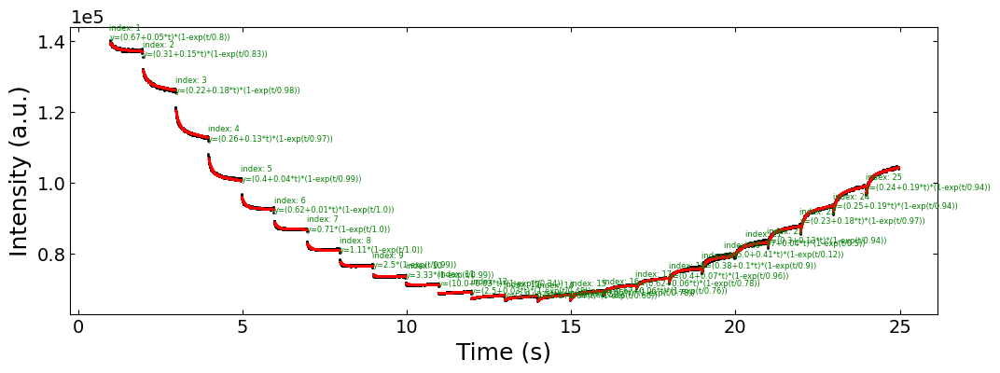

MSE loss:  tensor(0.0003)


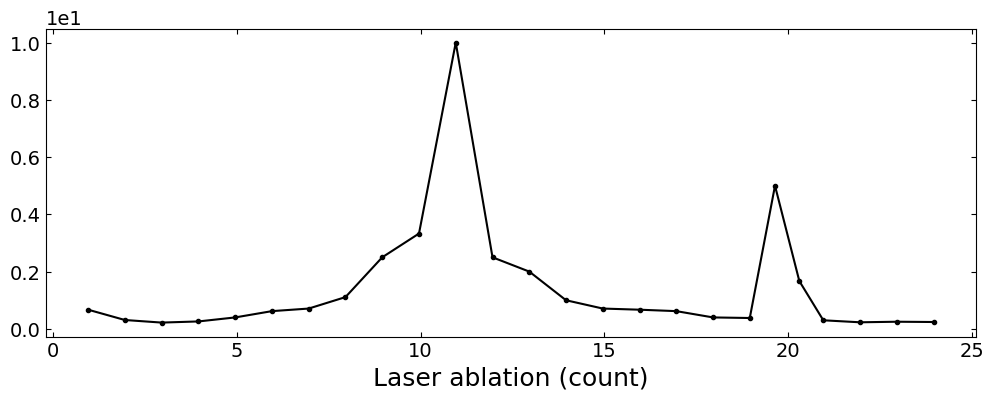

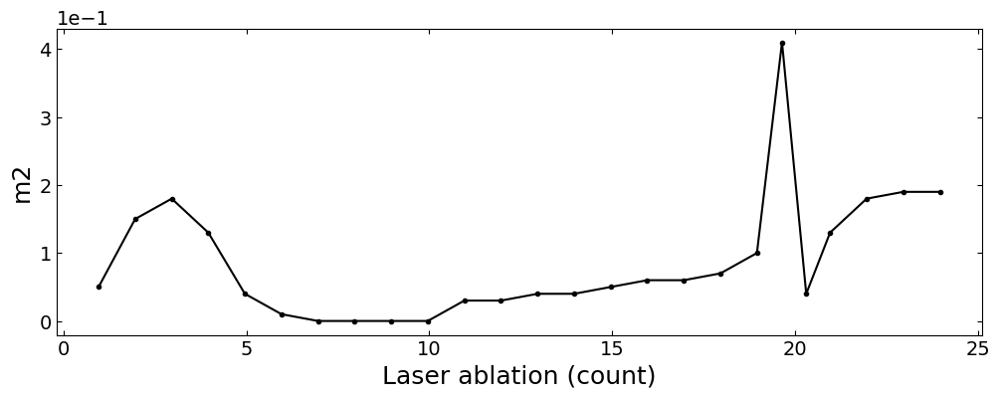

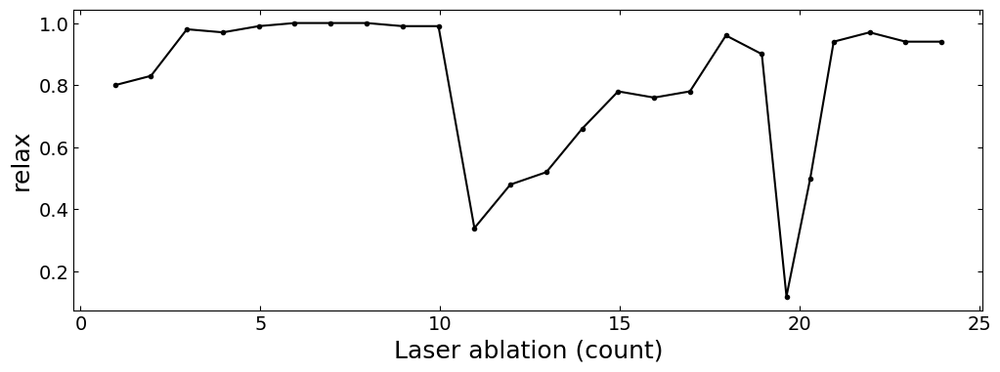

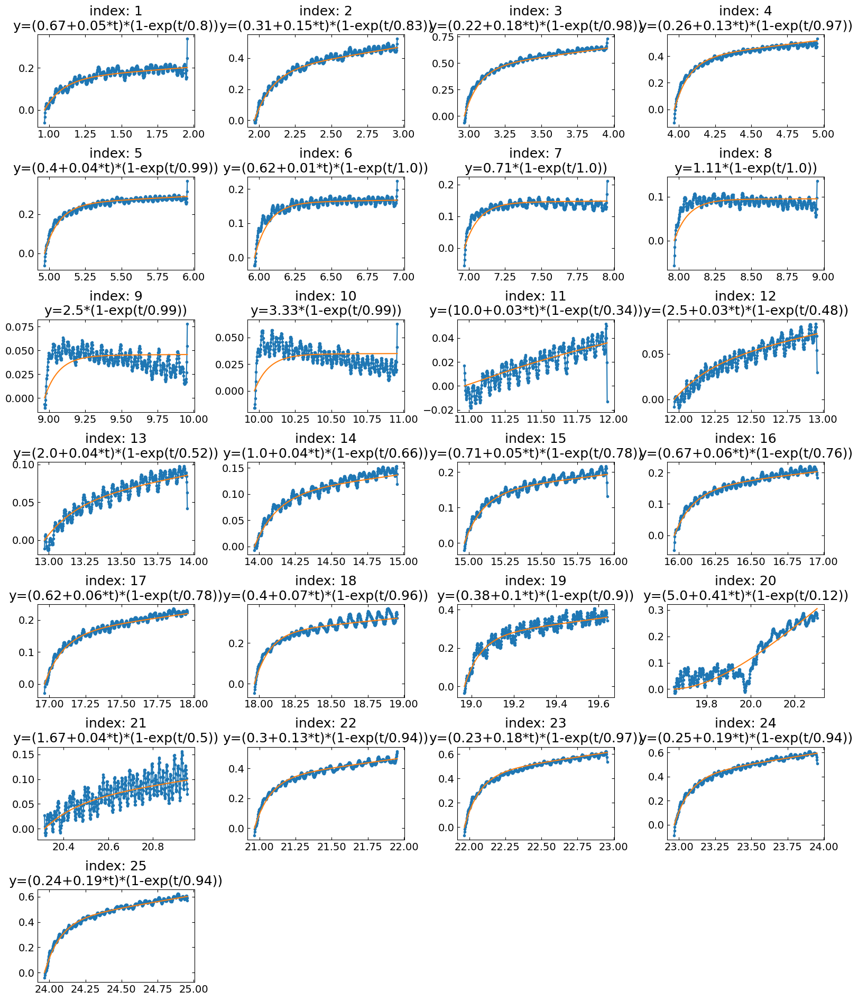

growth_2 :


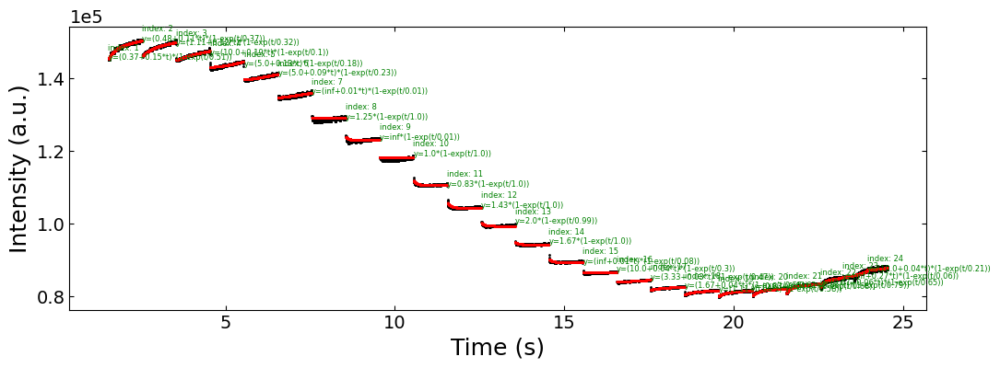

MSE loss:  tensor(0.0006)


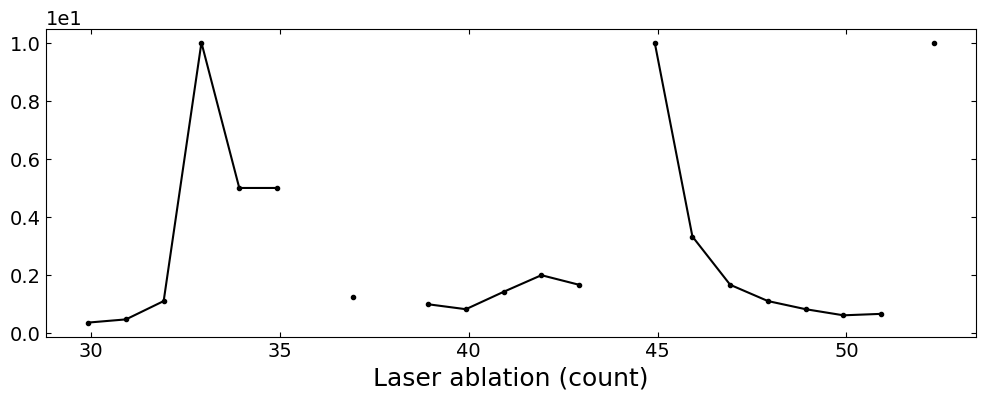

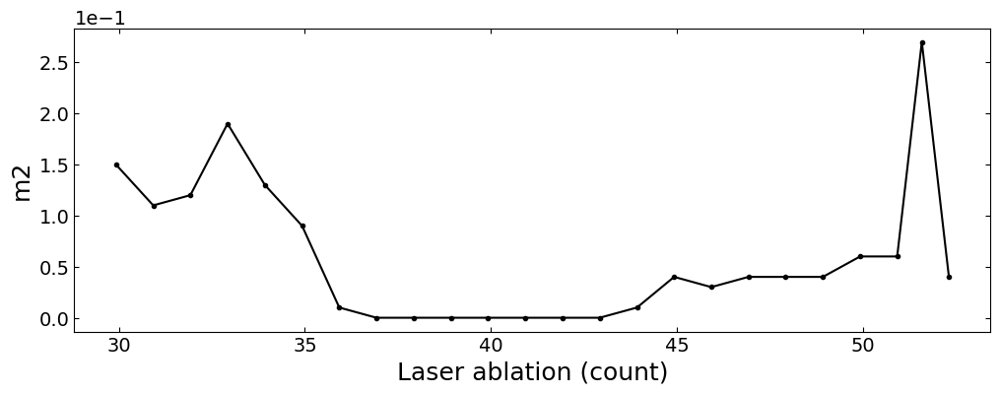

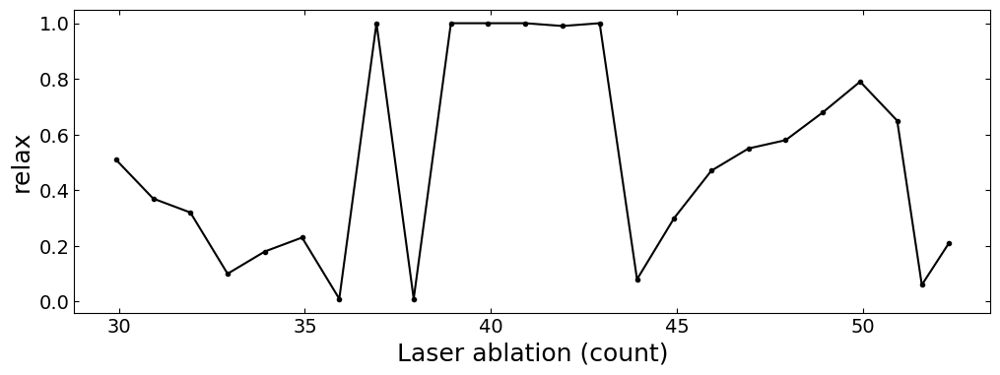

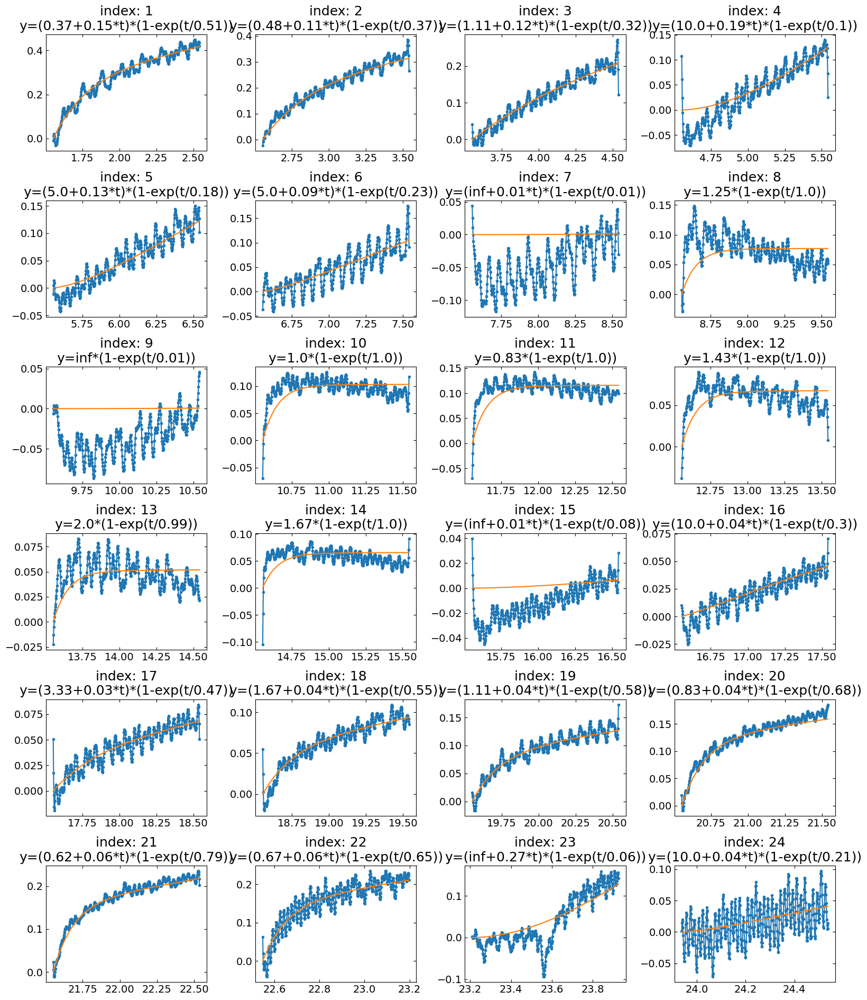

growth_3 :


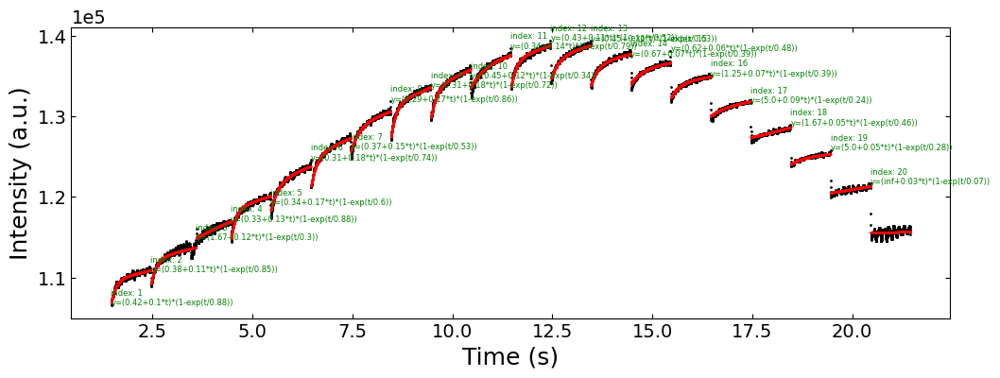

MSE loss:  tensor(0.0004)


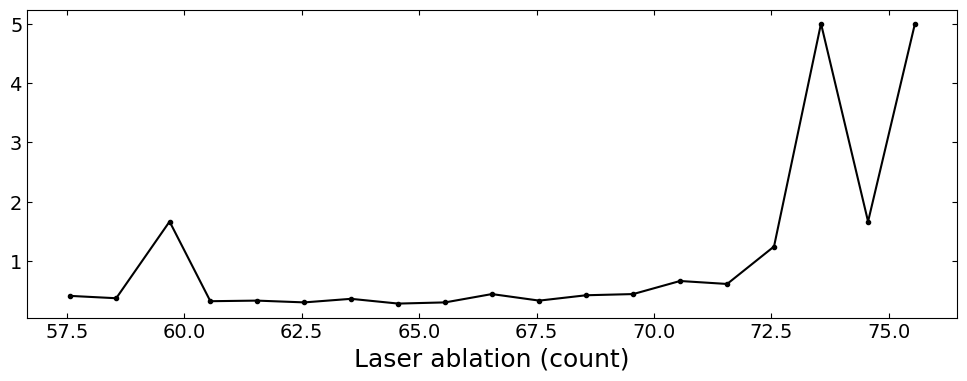

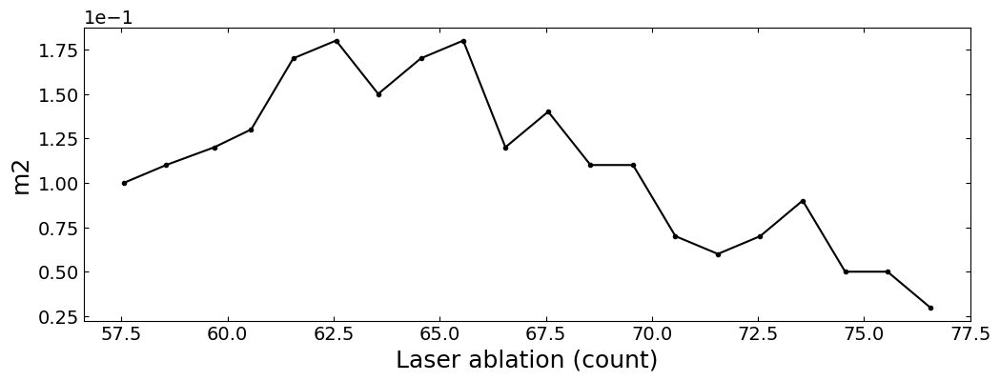

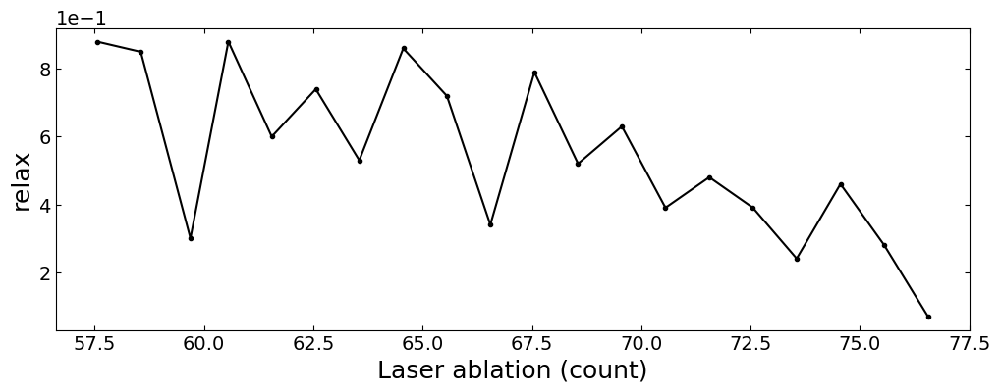

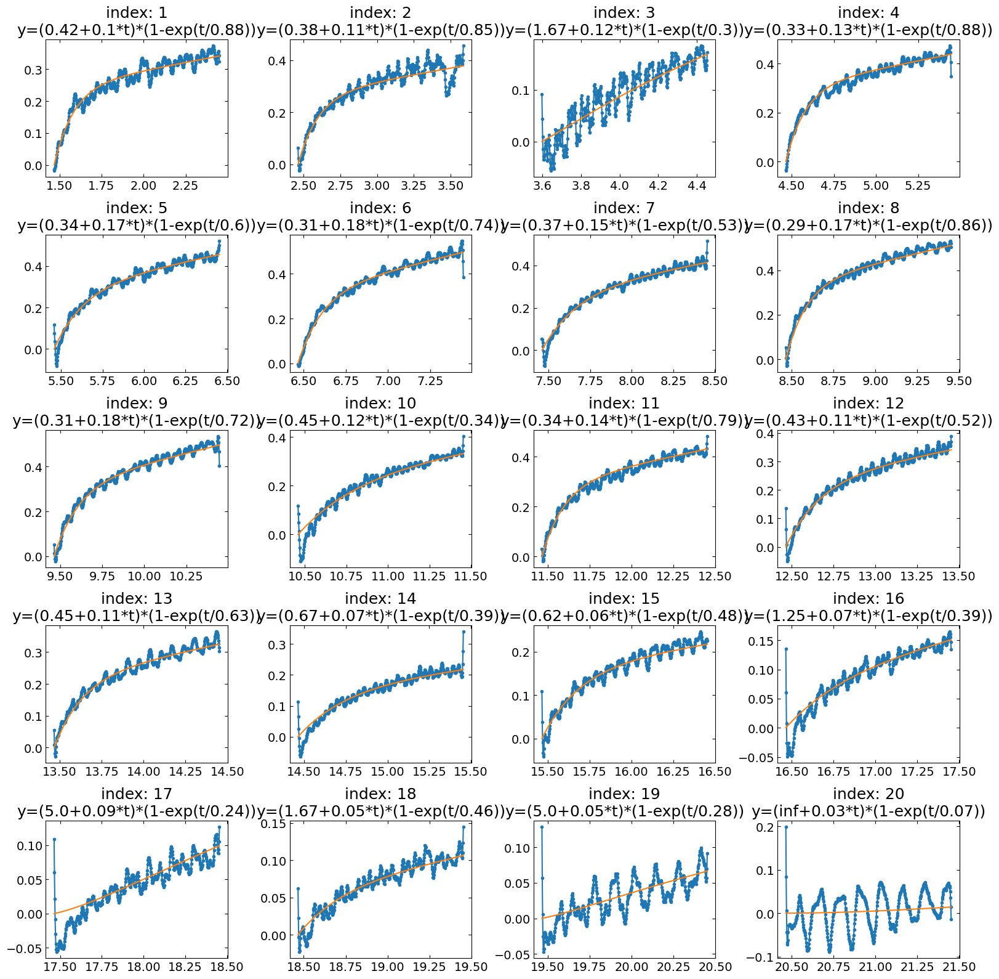

growth_4 :


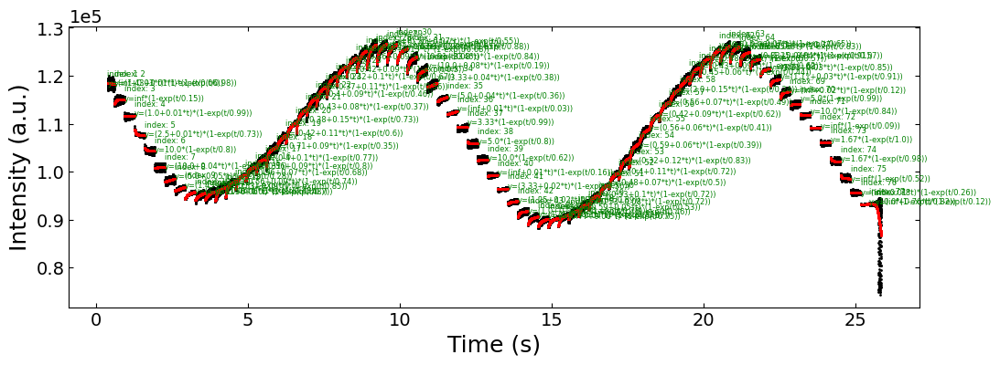

MSE loss:  tensor(0.0032)


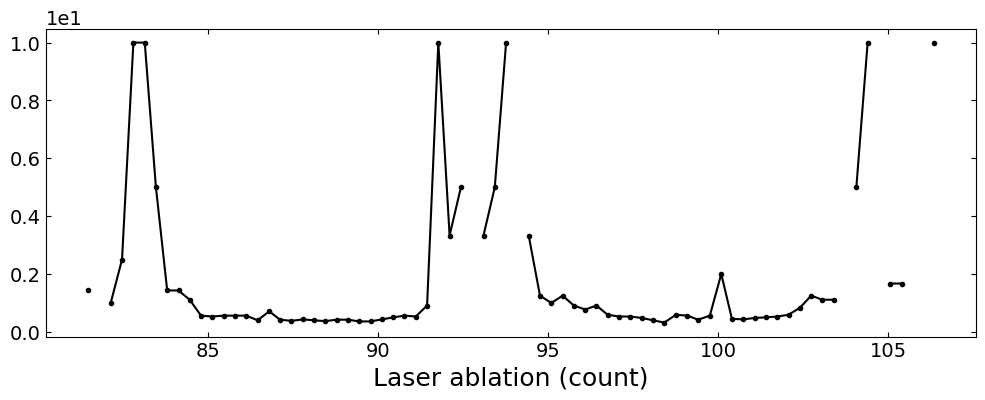

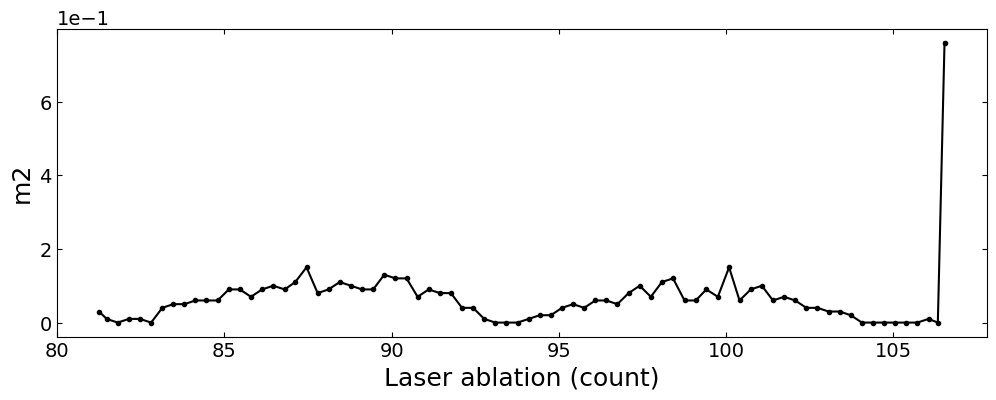

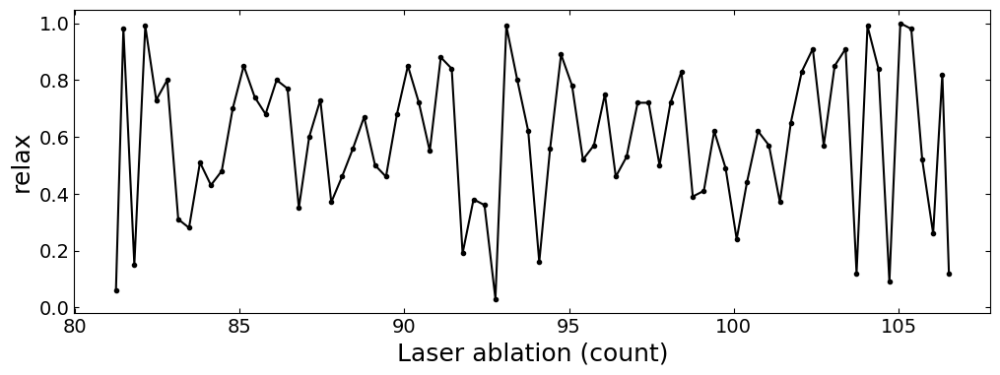

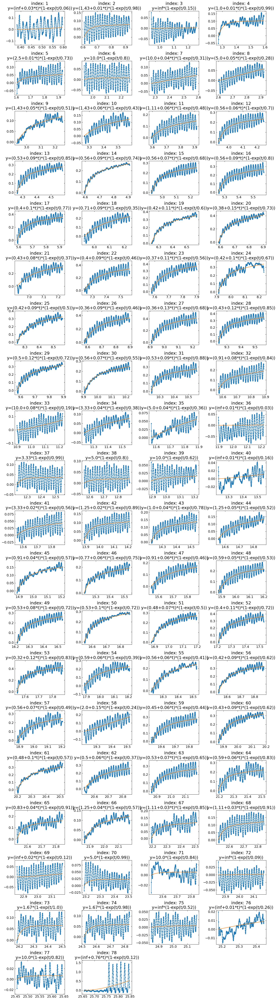

growth_5 :


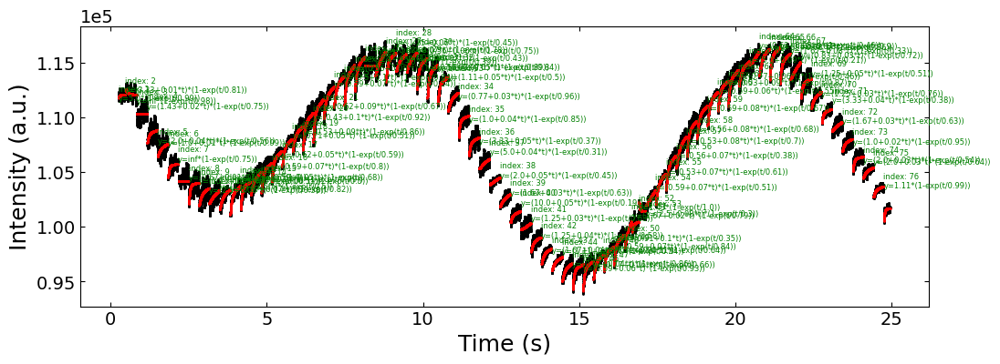

MSE loss:  tensor(0.0015)


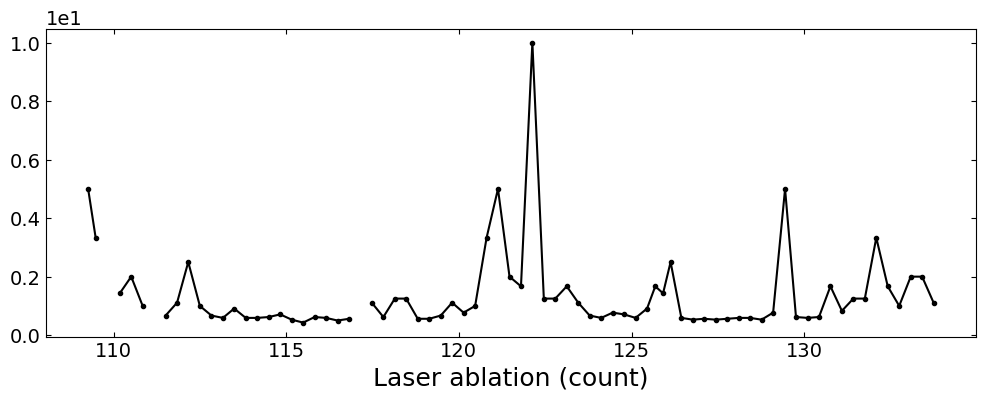

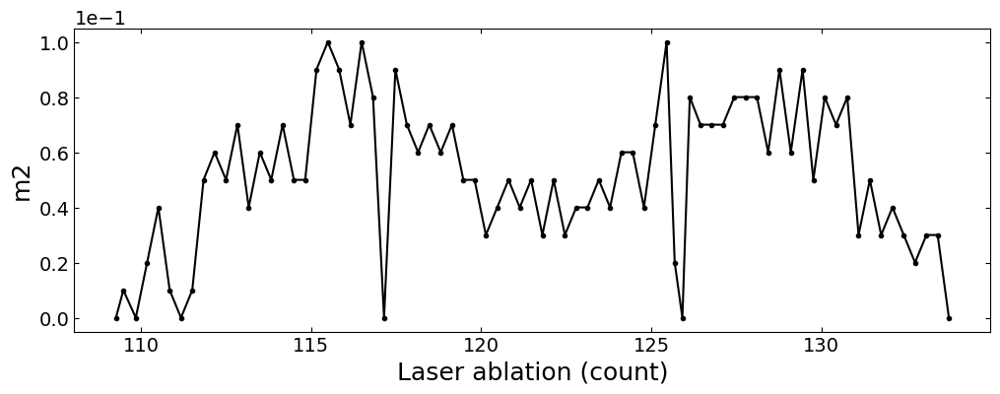

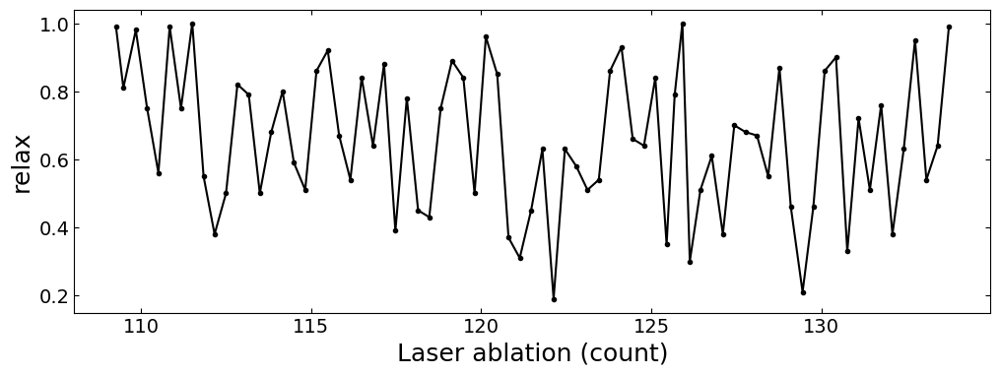

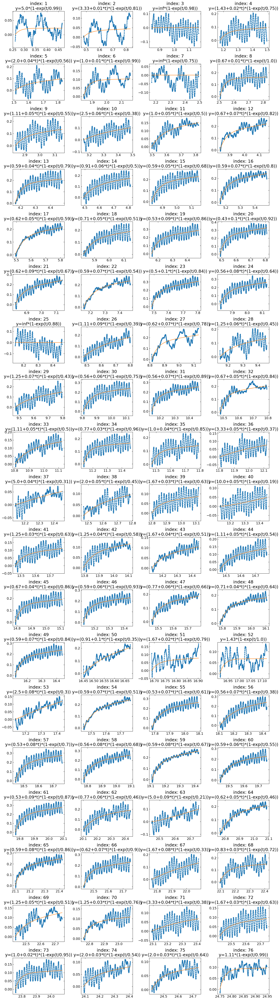

In [3]:
NAME = f'test6_model-baseline'
model_path = '../models/'+NAME+'.pt'

plt.rcParams.update(rc_plot)
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=1000)
parameters_all, x_coor_all, info = analyze_curves_dl(h5_para_file, growth_dict, spot, metric, camera_freq=500, interval=1000, length=500, 
                                                     savgol_window_order=(15,3), pca_component=10,
                                                     visualize=True, I_diff=12000, model_path=model_path)
x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test6_fitting_results(DL).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

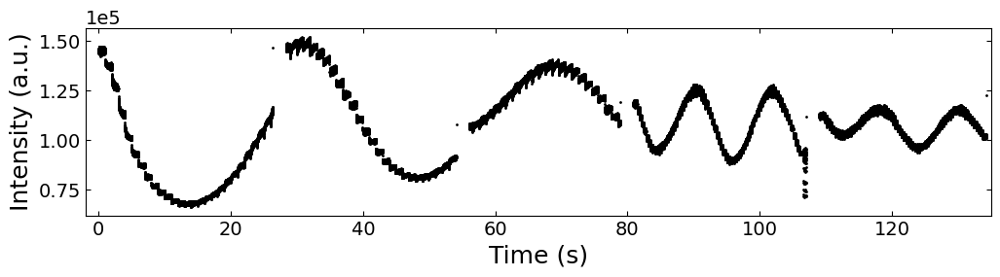

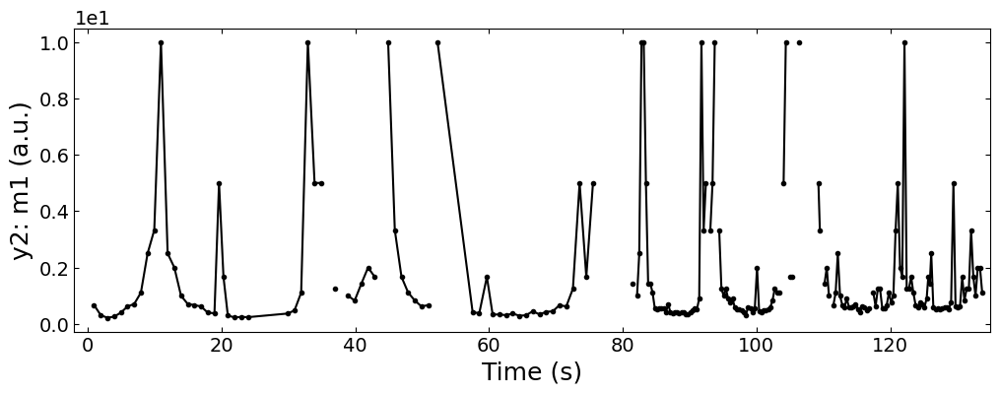

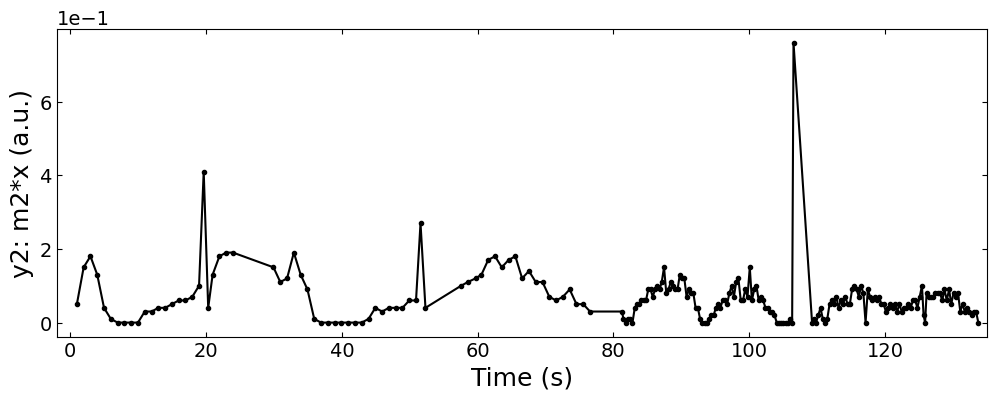

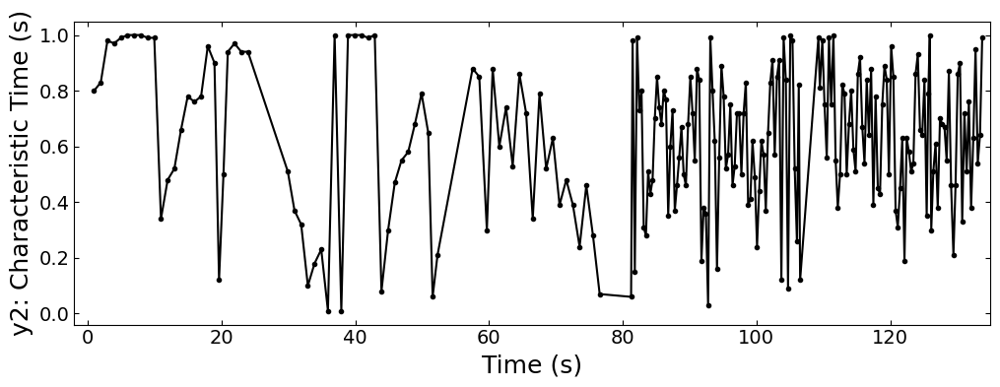

MSE loss for DL model fitting is: 0.001762351549858941


In [4]:
visualize_predictions(x_all, y_all, parameters_all, x_coor_all, info)

# 2. test 7

In [5]:
h5_para_file = '../../data/test7_gaussian_fit_parameters_all.h5'
spot = 'spot_2'
metric = 'img_intensity'
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3}
length = 500
I_diff = 12000

## 2.1 Train model

In [6]:
dl, xs_processed, ys_nor_all = prepare_dataloader(h5_para_file, spot, metric, growth_dict, camera_freq=500, 
                                                  length=length, I_diff=I_diff, unify=True, batch_size=32, 
                                                  savgol_window_order=None, pca_component=None, visualize=True)
model = linear_fit_model()
y_fit, parameters = model(torch.randn(32, 1, 500))
print(y_fit.shape, parameters.shape)

NAME = f'test7_model-baseline'
wandb.init(project='RHEED_model', entity='yig319', name=NAME, id=NAME)

device = torch.device('cpu')
model_path = '../models/'+NAME+'.pt'

lr = 1e-3
loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

start = 0
epochs = 500
scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, epochs=epochs, max_lr=lr, 
                            steps_per_epoch=len(dl))

train(model, dl, epochs, start, device, loss_func, optimizer, scheduler, model_path, tracking=True)

torch.Size([32, 1, 500]) torch.Size([32, 3])


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_loss,█▂▂▂▃▂▂▃▃▂▃▂▂▂▁▁▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,499
train_loss,0.00184


Epoch: 1/500


100%|██████████| 7/7 [00:00<00:00, 17.51it/s]


Training Loss: 0.1280
Epoch: 2/500


100%|██████████| 7/7 [00:00<00:00, 52.20it/s]


Training Loss: 0.0149
Epoch: 3/500


100%|██████████| 7/7 [00:00<00:00, 52.16it/s]


Training Loss: 0.0120
Epoch: 4/500


100%|██████████| 7/7 [00:00<00:00, 52.74it/s]


Training Loss: 0.0100
Epoch: 5/500


100%|██████████| 7/7 [00:00<00:00, 51.96it/s]


Training Loss: 0.0097
Epoch: 6/500


100%|██████████| 7/7 [00:00<00:00, 54.22it/s]


Training Loss: 0.0088
Epoch: 7/500


100%|██████████| 7/7 [00:00<00:00, 34.15it/s]


Training Loss: 0.0084
Epoch: 8/500


100%|██████████| 7/7 [00:00<00:00, 52.67it/s]


Training Loss: 0.0082
Epoch: 9/500


100%|██████████| 7/7 [00:00<00:00, 45.40it/s]


Training Loss: 0.0081
Epoch: 10/500


100%|██████████| 7/7 [00:00<00:00, 38.37it/s]

Training Loss: 0.0078


Epoch: 11/500


100%|██████████| 7/7 [00:00<00:00, 49.97it/s]


Training Loss: 0.0077
Epoch: 12/500


100%|██████████| 7/7 [00:00<00:00, 40.93it/s]


Training Loss: 0.0077
Epoch: 13/500


100%|██████████| 7/7 [00:00<00:00, 46.08it/s]


Training Loss: 0.0072
Epoch: 14/500


100%|██████████| 7/7 [00:00<00:00, 51.58it/s]


Training Loss: 0.0075
Epoch: 15/500


100%|██████████| 7/7 [00:00<00:00, 38.66it/s]

Training Loss: 0.0077


Epoch: 16/500


100%|██████████| 7/7 [00:00<00:00, 53.29it/s]


Training Loss: 0.0071
Epoch: 17/500


100%|██████████| 7/7 [00:00<00:00, 43.11it/s]


Training Loss: 0.0073
Epoch: 18/500


100%|██████████| 7/7 [00:00<00:00, 47.78it/s]


Training Loss: 0.0071
Epoch: 19/500


100%|██████████| 7/7 [00:00<00:00, 23.73it/s]


Training Loss: 0.0072
Epoch: 20/500


100%|██████████| 7/7 [00:00<00:00, 21.48it/s]


Training Loss: 0.0071
Epoch: 21/500


100%|██████████| 7/7 [00:00<00:00, 23.84it/s]


Training Loss: 0.0068
Epoch: 22/500


100%|██████████| 7/7 [00:00<00:00, 51.40it/s]


Training Loss: 0.0068
Epoch: 23/500


100%|██████████| 7/7 [00:00<00:00, 51.48it/s]


Training Loss: 0.0068
Epoch: 24/500


100%|██████████| 7/7 [00:00<00:00, 49.05it/s]


Training Loss: 0.0071
Epoch: 25/500


100%|██████████| 7/7 [00:00<00:00, 52.77it/s]


Training Loss: 0.0069
Epoch: 26/500


100%|██████████| 7/7 [00:00<00:00, 45.67it/s]


Training Loss: 0.0071
Epoch: 27/500


100%|██████████| 7/7 [00:00<00:00, 51.89it/s]


Training Loss: 0.0075
Epoch: 28/500


100%|██████████| 7/7 [00:00<00:00, 50.06it/s]


Training Loss: 0.0072
Epoch: 29/500


100%|██████████| 7/7 [00:00<00:00, 38.32it/s]

Training Loss: 0.0072


Epoch: 30/500


100%|██████████| 7/7 [00:00<00:00, 38.25it/s]

Training Loss: 0.0070


Epoch: 31/500


100%|██████████| 7/7 [00:00<00:00, 49.52it/s]


Training Loss: 0.0071
Epoch: 32/500


100%|██████████| 7/7 [00:00<00:00, 44.86it/s]


Training Loss: 0.0068
Epoch: 33/500


100%|██████████| 7/7 [00:00<00:00, 44.48it/s]


Training Loss: 0.0071
Epoch: 34/500


100%|██████████| 7/7 [00:00<00:00, 48.15it/s]


Training Loss: 0.0068
Epoch: 35/500


100%|██████████| 7/7 [00:00<00:00, 54.79it/s]


Training Loss: 0.0066
Epoch: 36/500


100%|██████████| 7/7 [00:00<00:00, 53.59it/s]


Training Loss: 0.0069
Epoch: 37/500


100%|██████████| 7/7 [00:00<00:00, 55.76it/s]


Training Loss: 0.0068
Epoch: 38/500


100%|██████████| 7/7 [00:00<00:00, 27.73it/s]


Training Loss: 0.0068
Epoch: 39/500


100%|██████████| 7/7 [00:00<00:00, 54.84it/s]


Training Loss: 0.0070
Epoch: 40/500


100%|██████████| 7/7 [00:00<00:00, 29.36it/s]


Training Loss: 0.0072
Epoch: 41/500


100%|██████████| 7/7 [00:00<00:00, 50.83it/s]


Training Loss: 0.0070
Epoch: 42/500


100%|██████████| 7/7 [00:00<00:00, 54.63it/s]


Training Loss: 0.0071
Epoch: 43/500


100%|██████████| 7/7 [00:00<00:00, 39.46it/s]


Training Loss: 0.0069
Epoch: 44/500


100%|██████████| 7/7 [00:00<00:00, 55.00it/s]


Training Loss: 0.0070
Epoch: 45/500


100%|██████████| 7/7 [00:00<00:00, 51.16it/s]


Training Loss: 0.0066
Epoch: 46/500


100%|██████████| 7/7 [00:00<00:00, 54.97it/s]


Training Loss: 0.0068
Epoch: 47/500


100%|██████████| 7/7 [00:00<00:00, 54.75it/s]


Training Loss: 0.0068
Epoch: 48/500


100%|██████████| 7/7 [00:00<00:00, 53.68it/s]


Training Loss: 0.0067
Epoch: 49/500


100%|██████████| 7/7 [00:00<00:00, 54.39it/s]


Training Loss: 0.0068
Epoch: 50/500


100%|██████████| 7/7 [00:00<00:00, 54.02it/s]


Training Loss: 0.0071
Epoch: 51/500


100%|██████████| 7/7 [00:00<00:00, 53.36it/s]


Training Loss: 0.0071
Epoch: 52/500


100%|██████████| 7/7 [00:00<00:00, 24.67it/s]


Training Loss: 0.0072
Epoch: 53/500


100%|██████████| 7/7 [00:00<00:00, 32.86it/s]


Training Loss: 0.0070
Epoch: 54/500


100%|██████████| 7/7 [00:00<00:00, 53.77it/s]


Training Loss: 0.0074
Epoch: 55/500


100%|██████████| 7/7 [00:00<00:00, 50.69it/s]


Training Loss: 0.0071
Epoch: 56/500


100%|██████████| 7/7 [00:00<00:00, 55.16it/s]


Training Loss: 0.0067
Epoch: 57/500


100%|██████████| 7/7 [00:00<00:00, 55.40it/s]


Training Loss: 0.0072
Epoch: 58/500


100%|██████████| 7/7 [00:00<00:00, 39.44it/s]


Training Loss: 0.0070
Epoch: 59/500


100%|██████████| 7/7 [00:00<00:00, 53.62it/s]


Training Loss: 0.0073
Epoch: 60/500


100%|██████████| 7/7 [00:00<00:00, 30.21it/s]


Training Loss: 0.0068
Epoch: 61/500


100%|██████████| 7/7 [00:00<00:00, 54.63it/s]


Training Loss: 0.0068
Epoch: 62/500


100%|██████████| 7/7 [00:00<00:00, 35.47it/s]


Training Loss: 0.0066
Epoch: 63/500


100%|██████████| 7/7 [00:00<00:00, 53.19it/s]


Training Loss: 0.0065
Epoch: 64/500


100%|██████████| 7/7 [00:00<00:00, 52.16it/s]


Training Loss: 0.0065
Epoch: 65/500


100%|██████████| 7/7 [00:00<00:00, 26.67it/s]


Training Loss: 0.0066
Epoch: 66/500


100%|██████████| 7/7 [00:00<00:00, 51.22it/s]


Training Loss: 0.0070
Epoch: 67/500


100%|██████████| 7/7 [00:00<00:00, 52.06it/s]


Training Loss: 0.0069
Epoch: 68/500


100%|██████████| 7/7 [00:00<00:00, 52.15it/s]


Training Loss: 0.0070
Epoch: 69/500


100%|██████████| 7/7 [00:00<00:00, 53.07it/s]


Training Loss: 0.0070
Epoch: 70/500


100%|██████████| 7/7 [00:00<00:00, 54.65it/s]


Training Loss: 0.0066
Epoch: 71/500


100%|██████████| 7/7 [00:00<00:00, 54.69it/s]


Training Loss: 0.0066
Epoch: 72/500


100%|██████████| 7/7 [00:00<00:00, 22.73it/s]


Training Loss: 0.0067
Epoch: 73/500


100%|██████████| 7/7 [00:00<00:00, 55.60it/s]


Training Loss: 0.0066
Epoch: 74/500


100%|██████████| 7/7 [00:00<00:00, 56.46it/s]


Training Loss: 0.0065
Epoch: 75/500


100%|██████████| 7/7 [00:00<00:00, 54.80it/s]


Training Loss: 0.0065
Epoch: 76/500


100%|██████████| 7/7 [00:00<00:00, 57.53it/s]


Training Loss: 0.0065
Epoch: 77/500


100%|██████████| 7/7 [00:00<00:00, 58.03it/s]


Training Loss: 0.0065
Epoch: 78/500


100%|██████████| 7/7 [00:00<00:00, 56.10it/s]


Training Loss: 0.0064
Epoch: 79/500


100%|██████████| 7/7 [00:00<00:00, 26.46it/s]


Training Loss: 0.0067
Epoch: 80/500


100%|██████████| 7/7 [00:00<00:00, 40.83it/s]


Training Loss: 0.0065
Epoch: 81/500


100%|██████████| 7/7 [00:00<00:00, 51.58it/s]


Training Loss: 0.0065
Epoch: 82/500


100%|██████████| 7/7 [00:00<00:00, 52.26it/s]


Training Loss: 0.0066
Epoch: 83/500


100%|██████████| 7/7 [00:00<00:00, 50.43it/s]


Training Loss: 0.0065
Epoch: 84/500


100%|██████████| 7/7 [00:00<00:00, 57.61it/s]


Training Loss: 0.0067
Epoch: 85/500


100%|██████████| 7/7 [00:00<00:00, 58.66it/s]


Training Loss: 0.0070
Epoch: 86/500


100%|██████████| 7/7 [00:00<00:00, 40.24it/s]


Training Loss: 0.0069
Epoch: 87/500


100%|██████████| 7/7 [00:00<00:00, 57.55it/s]


Training Loss: 0.0072
Epoch: 88/500


100%|██████████| 7/7 [00:00<00:00, 57.01it/s]


Training Loss: 0.0069
Epoch: 89/500


100%|██████████| 7/7 [00:00<00:00, 47.74it/s]


Training Loss: 0.0071
Epoch: 90/500


100%|██████████| 7/7 [00:00<00:00, 55.71it/s]


Training Loss: 0.0071
Epoch: 91/500


100%|██████████| 7/7 [00:00<00:00, 56.62it/s]


Training Loss: 0.0070
Epoch: 92/500


100%|██████████| 7/7 [00:00<00:00, 56.02it/s]


Training Loss: 0.0068
Epoch: 93/500


100%|██████████| 7/7 [00:00<00:00, 51.38it/s]


Training Loss: 0.0067
Epoch: 94/500


100%|██████████| 7/7 [00:00<00:00, 20.91it/s]


Training Loss: 0.0068
Epoch: 95/500


100%|██████████| 7/7 [00:00<00:00, 31.27it/s]


Training Loss: 0.0069
Epoch: 96/500


100%|██████████| 7/7 [00:00<00:00, 53.07it/s]


Training Loss: 0.0068
Epoch: 97/500


100%|██████████| 7/7 [00:00<00:00, 37.56it/s]


Training Loss: 0.0069
Epoch: 98/500


100%|██████████| 7/7 [00:00<00:00, 55.94it/s]


Training Loss: 0.0067
Epoch: 99/500


100%|██████████| 7/7 [00:00<00:00, 57.21it/s]


Training Loss: 0.0066
Epoch: 100/500


100%|██████████| 7/7 [00:00<00:00, 41.42it/s]


Training Loss: 0.0065
Epoch: 101/500


100%|██████████| 7/7 [00:00<00:00, 56.84it/s]


Training Loss: 0.0065
Epoch: 102/500


100%|██████████| 7/7 [00:00<00:00, 58.63it/s]


Training Loss: 0.0065
Epoch: 103/500


100%|██████████| 7/7 [00:00<00:00, 57.16it/s]


Training Loss: 0.0067
Epoch: 104/500


100%|██████████| 7/7 [00:00<00:00, 31.87it/s]


Training Loss: 0.0066
Epoch: 105/500


100%|██████████| 7/7 [00:00<00:00, 59.25it/s]


Training Loss: 0.0073
Epoch: 106/500


100%|██████████| 7/7 [00:00<00:00, 58.06it/s]


Training Loss: 0.0067
Epoch: 107/500


100%|██████████| 7/7 [00:00<00:00, 58.30it/s]


Training Loss: 0.0066
Epoch: 108/500


100%|██████████| 7/7 [00:00<00:00, 28.26it/s]


Training Loss: 0.0067
Epoch: 109/500


100%|██████████| 7/7 [00:00<00:00, 57.84it/s]


Training Loss: 0.0069
Epoch: 110/500


100%|██████████| 7/7 [00:00<00:00, 51.80it/s]


Training Loss: 0.0067
Epoch: 111/500


100%|██████████| 7/7 [00:00<00:00, 51.35it/s]


Training Loss: 0.0067
Epoch: 112/500


100%|██████████| 7/7 [00:00<00:00, 51.63it/s]


Training Loss: 0.0067
Epoch: 113/500


100%|██████████| 7/7 [00:00<00:00, 48.48it/s]


Training Loss: 0.0066
Epoch: 114/500


100%|██████████| 7/7 [00:00<00:00, 47.81it/s]


Training Loss: 0.0066
Epoch: 115/500


100%|██████████| 7/7 [00:00<00:00, 28.48it/s]


Training Loss: 0.0069
Epoch: 116/500


100%|██████████| 7/7 [00:00<00:00, 58.00it/s]


Training Loss: 0.0068
Epoch: 117/500


100%|██████████| 7/7 [00:00<00:00, 58.64it/s]


Training Loss: 0.0074
Epoch: 118/500


100%|██████████| 7/7 [00:00<00:00, 51.02it/s]


Training Loss: 0.0072
Epoch: 119/500


100%|██████████| 7/7 [00:00<00:00, 57.51it/s]


Training Loss: 0.0073
Epoch: 120/500


100%|██████████| 7/7 [00:00<00:00, 58.20it/s]


Training Loss: 0.0079
Epoch: 121/500


100%|██████████| 7/7 [00:00<00:00, 49.40it/s]


Training Loss: 0.0070
Epoch: 122/500


100%|██████████| 7/7 [00:00<00:00, 32.34it/s]


Training Loss: 0.0067
Epoch: 123/500


100%|██████████| 7/7 [00:00<00:00, 56.28it/s]


Training Loss: 0.0069
Epoch: 124/500


100%|██████████| 7/7 [00:00<00:00, 46.84it/s]


Training Loss: 0.0070
Epoch: 125/500


100%|██████████| 7/7 [00:00<00:00, 48.87it/s]


Training Loss: 0.0071
Epoch: 126/500


100%|██████████| 7/7 [00:00<00:00, 37.15it/s]

Training Loss: 0.0067


Epoch: 127/500


100%|██████████| 7/7 [00:00<00:00, 48.92it/s]


Training Loss: 0.0067
Epoch: 128/500


100%|██████████| 7/7 [00:00<00:00, 51.88it/s]


Training Loss: 0.0070
Epoch: 129/500


100%|██████████| 7/7 [00:00<00:00, 38.74it/s]

Training Loss: 0.0071


Epoch: 130/500


100%|██████████| 7/7 [00:00<00:00, 53.79it/s]


Training Loss: 0.0069
Epoch: 131/500


100%|██████████| 7/7 [00:00<00:00, 55.09it/s]


Training Loss: 0.0068
Epoch: 132/500


100%|██████████| 7/7 [00:00<00:00, 58.66it/s]


Training Loss: 0.0066
Epoch: 133/500


100%|██████████| 7/7 [00:00<00:00, 52.82it/s]


Training Loss: 0.0072
Epoch: 134/500


100%|██████████| 7/7 [00:00<00:00, 55.42it/s]


Training Loss: 0.0069
Epoch: 135/500


100%|██████████| 7/7 [00:00<00:00, 59.02it/s]


Training Loss: 0.0068
Epoch: 136/500


100%|██████████| 7/7 [00:00<00:00, 35.04it/s]


Training Loss: 0.0073
Epoch: 137/500


100%|██████████| 7/7 [00:00<00:00, 53.88it/s]


Training Loss: 0.0070
Epoch: 138/500


100%|██████████| 7/7 [00:00<00:00, 56.99it/s]


Training Loss: 0.0070
Epoch: 139/500


100%|██████████| 7/7 [00:00<00:00, 28.20it/s]


Training Loss: 0.0073
Epoch: 140/500


100%|██████████| 7/7 [00:00<00:00, 29.96it/s]


Training Loss: 0.0076
Epoch: 141/500


100%|██████████| 7/7 [00:00<00:00, 58.60it/s]


Training Loss: 0.0069
Epoch: 142/500


100%|██████████| 7/7 [00:00<00:00, 58.88it/s]


Training Loss: 0.0069
Epoch: 143/500


100%|██████████| 7/7 [00:00<00:00, 40.95it/s]


Training Loss: 0.0067
Epoch: 144/500


100%|██████████| 7/7 [00:00<00:00, 57.45it/s]


Training Loss: 0.0067
Epoch: 145/500


100%|██████████| 7/7 [00:00<00:00, 58.77it/s]


Training Loss: 0.0065
Epoch: 146/500


100%|██████████| 7/7 [00:00<00:00, 57.72it/s]


Training Loss: 0.0066
Epoch: 147/500


100%|██████████| 7/7 [00:00<00:00, 51.27it/s]


Training Loss: 0.0068
Epoch: 148/500


100%|██████████| 7/7 [00:00<00:00, 45.71it/s]


Training Loss: 0.0068
Epoch: 149/500


100%|██████████| 7/7 [00:00<00:00, 59.31it/s]


Training Loss: 0.0068
Epoch: 150/500


100%|██████████| 7/7 [00:00<00:00, 57.89it/s]


Training Loss: 0.0067
Epoch: 151/500


100%|██████████| 7/7 [00:00<00:00, 25.50it/s]


Training Loss: 0.0065
Epoch: 152/500


100%|██████████| 7/7 [00:00<00:00, 32.54it/s]


Training Loss: 0.0068
Epoch: 153/500


100%|██████████| 7/7 [00:00<00:00, 57.39it/s]


Training Loss: 0.0067
Epoch: 154/500


100%|██████████| 7/7 [00:00<00:00, 46.14it/s]


Training Loss: 0.0066
Epoch: 155/500


100%|██████████| 7/7 [00:00<00:00, 58.94it/s]


Training Loss: 0.0067
Epoch: 156/500


100%|██████████| 7/7 [00:00<00:00, 44.88it/s]


Training Loss: 0.0069
Epoch: 157/500


100%|██████████| 7/7 [00:00<00:00, 59.22it/s]


Training Loss: 0.0070
Epoch: 158/500


100%|██████████| 7/7 [00:00<00:00, 41.26it/s]


Training Loss: 0.0070
Epoch: 159/500


100%|██████████| 7/7 [00:00<00:00, 58.87it/s]


Training Loss: 0.0068
Epoch: 160/500


100%|██████████| 7/7 [00:00<00:00, 58.34it/s]


Training Loss: 0.0078
Epoch: 161/500


100%|██████████| 7/7 [00:00<00:00, 58.94it/s]


Training Loss: 0.0074
Epoch: 162/500


100%|██████████| 7/7 [00:00<00:00, 35.99it/s]


Training Loss: 0.0068
Epoch: 163/500


100%|██████████| 7/7 [00:00<00:00, 59.34it/s]


Training Loss: 0.0067
Epoch: 164/500


100%|██████████| 7/7 [00:00<00:00, 57.10it/s]


Training Loss: 0.0070
Epoch: 165/500


100%|██████████| 7/7 [00:00<00:00, 39.49it/s]


Training Loss: 0.0070
Epoch: 166/500


100%|██████████| 7/7 [00:00<00:00, 50.44it/s]


Training Loss: 0.0066
Epoch: 167/500


100%|██████████| 7/7 [00:00<00:00, 57.15it/s]


Training Loss: 0.0070
Epoch: 168/500


100%|██████████| 7/7 [00:00<00:00, 51.33it/s]


Training Loss: 0.0067
Epoch: 169/500


100%|██████████| 7/7 [00:00<00:00, 39.84it/s]

Training Loss: 0.0069


Epoch: 170/500


100%|██████████| 7/7 [00:00<00:00, 58.31it/s]


Training Loss: 0.0074
Epoch: 171/500


100%|██████████| 7/7 [00:00<00:00, 58.73it/s]


Training Loss: 0.0068
Epoch: 172/500


100%|██████████| 7/7 [00:00<00:00, 40.93it/s]


Training Loss: 0.0065
Epoch: 173/500


100%|██████████| 7/7 [00:00<00:00, 38.09it/s]

Training Loss: 0.0066


Epoch: 174/500


100%|██████████| 7/7 [00:00<00:00, 56.92it/s]


Training Loss: 0.0065
Epoch: 175/500


100%|██████████| 7/7 [00:00<00:00, 58.24it/s]


Training Loss: 0.0067
Epoch: 176/500


100%|██████████| 7/7 [00:00<00:00, 54.48it/s]


Training Loss: 0.0067
Epoch: 177/500


100%|██████████| 7/7 [00:00<00:00, 59.21it/s]


Training Loss: 0.0066
Epoch: 178/500


100%|██████████| 7/7 [00:00<00:00, 59.60it/s]


Training Loss: 0.0065
Epoch: 179/500


100%|██████████| 7/7 [00:00<00:00, 59.64it/s]


Training Loss: 0.0066
Epoch: 180/500


100%|██████████| 7/7 [00:00<00:00, 29.35it/s]


Training Loss: 0.0066
Epoch: 181/500


100%|██████████| 7/7 [00:00<00:00, 59.06it/s]


Training Loss: 0.0068
Epoch: 182/500


100%|██████████| 7/7 [00:00<00:00, 36.72it/s]


Training Loss: 0.0065
Epoch: 183/500


100%|██████████| 7/7 [00:00<00:00, 51.65it/s]


Training Loss: 0.0065
Epoch: 184/500


100%|██████████| 7/7 [00:00<00:00, 43.31it/s]


Training Loss: 0.0065
Epoch: 185/500


100%|██████████| 7/7 [00:00<00:00, 49.76it/s]


Training Loss: 0.0065
Epoch: 186/500


100%|██████████| 7/7 [00:00<00:00, 28.01it/s]


Training Loss: 0.0067
Epoch: 187/500


100%|██████████| 7/7 [00:00<00:00, 58.88it/s]


Training Loss: 0.0066
Epoch: 188/500


100%|██████████| 7/7 [00:00<00:00, 60.35it/s]


Training Loss: 0.0065
Epoch: 189/500


100%|██████████| 7/7 [00:00<00:00, 60.03it/s]


Training Loss: 0.0065
Epoch: 190/500


100%|██████████| 7/7 [00:00<00:00, 59.01it/s]


Training Loss: 0.0065
Epoch: 191/500


100%|██████████| 7/7 [00:00<00:00, 59.75it/s]


Training Loss: 0.0065
Epoch: 192/500


100%|██████████| 7/7 [00:00<00:00, 58.48it/s]


Training Loss: 0.0067
Epoch: 193/500


100%|██████████| 7/7 [00:00<00:00, 59.51it/s]


Training Loss: 0.0066
Epoch: 194/500


100%|██████████| 7/7 [00:00<00:00, 55.86it/s]


Training Loss: 0.0065
Epoch: 195/500


100%|██████████| 7/7 [00:00<00:00, 30.77it/s]


Training Loss: 0.0067
Epoch: 196/500


100%|██████████| 7/7 [00:00<00:00, 50.11it/s]


Training Loss: 0.0065
Epoch: 197/500


100%|██████████| 7/7 [00:00<00:00, 58.38it/s]


Training Loss: 0.0065
Epoch: 198/500


100%|██████████| 7/7 [00:00<00:00, 53.77it/s]


Training Loss: 0.0065
Epoch: 199/500


100%|██████████| 7/7 [00:00<00:00, 41.47it/s]


Training Loss: 0.0065
Epoch: 200/500


100%|██████████| 7/7 [00:00<00:00, 41.70it/s]


Training Loss: 0.0064
Epoch: 201/500


100%|██████████| 7/7 [00:00<00:00, 57.82it/s]


Training Loss: 0.0065
Epoch: 202/500


100%|██████████| 7/7 [00:00<00:00, 58.80it/s]


Training Loss: 0.0065
Epoch: 203/500


100%|██████████| 7/7 [00:00<00:00, 59.89it/s]


Training Loss: 0.0065
Epoch: 204/500


100%|██████████| 7/7 [00:00<00:00, 58.54it/s]


Training Loss: 0.0065
Epoch: 205/500


100%|██████████| 7/7 [00:00<00:00, 59.53it/s]


Training Loss: 0.0065
Epoch: 206/500


100%|██████████| 7/7 [00:00<00:00, 56.08it/s]


Training Loss: 0.0064
Epoch: 207/500


100%|██████████| 7/7 [00:00<00:00, 58.07it/s]


Training Loss: 0.0064
Epoch: 208/500


100%|██████████| 7/7 [00:00<00:00, 58.99it/s]


Training Loss: 0.0064
Epoch: 209/500


100%|██████████| 7/7 [00:00<00:00, 59.59it/s]


Training Loss: 0.0064
Epoch: 210/500


100%|██████████| 7/7 [00:00<00:00, 22.99it/s]


Training Loss: 0.0065
Epoch: 211/500


100%|██████████| 7/7 [00:00<00:00, 43.31it/s]


Training Loss: 0.0065
Epoch: 212/500


100%|██████████| 7/7 [00:00<00:00, 57.66it/s]


Training Loss: 0.0065
Epoch: 213/500


100%|██████████| 7/7 [00:00<00:00, 43.02it/s]


Training Loss: 0.0064
Epoch: 214/500


100%|██████████| 7/7 [00:00<00:00, 57.98it/s]


Training Loss: 0.0065
Epoch: 215/500


100%|██████████| 7/7 [00:00<00:00, 41.69it/s]


Training Loss: 0.0065
Epoch: 216/500


100%|██████████| 7/7 [00:00<00:00, 56.60it/s]


Training Loss: 0.0064
Epoch: 217/500


100%|██████████| 7/7 [00:00<00:00, 59.98it/s]


Training Loss: 0.0065
Epoch: 218/500


100%|██████████| 7/7 [00:00<00:00, 57.33it/s]


Training Loss: 0.0064
Epoch: 219/500


100%|██████████| 7/7 [00:00<00:00, 59.02it/s]


Training Loss: 0.0066
Epoch: 220/500


100%|██████████| 7/7 [00:00<00:00, 60.08it/s]


Training Loss: 0.0065
Epoch: 221/500


100%|██████████| 7/7 [00:00<00:00, 42.95it/s]


Training Loss: 0.0066
Epoch: 222/500


100%|██████████| 7/7 [00:00<00:00, 48.63it/s]


Training Loss: 0.0066
Epoch: 223/500


100%|██████████| 7/7 [00:00<00:00, 59.26it/s]


Training Loss: 0.0064
Epoch: 224/500


100%|██████████| 7/7 [00:00<00:00, 55.25it/s]


Training Loss: 0.0064
Epoch: 225/500


100%|██████████| 7/7 [00:00<00:00, 29.47it/s]


Training Loss: 0.0064
Epoch: 226/500


100%|██████████| 7/7 [00:00<00:00, 36.15it/s]


Training Loss: 0.0064
Epoch: 227/500


100%|██████████| 7/7 [00:00<00:00, 54.49it/s]


Training Loss: 0.0064
Epoch: 228/500


100%|██████████| 7/7 [00:00<00:00, 45.12it/s]


Training Loss: 0.0065
Epoch: 229/500


100%|██████████| 7/7 [00:00<00:00, 41.92it/s]


Training Loss: 0.0064
Epoch: 230/500


100%|██████████| 7/7 [00:00<00:00, 58.57it/s]


Training Loss: 0.0065
Epoch: 231/500


100%|██████████| 7/7 [00:00<00:00, 59.84it/s]


Training Loss: 0.0064
Epoch: 232/500


100%|██████████| 7/7 [00:00<00:00, 31.49it/s]


Training Loss: 0.0065
Epoch: 233/500


100%|██████████| 7/7 [00:00<00:00, 59.76it/s]


Training Loss: 0.0065
Epoch: 234/500


100%|██████████| 7/7 [00:00<00:00, 57.20it/s]


Training Loss: 0.0064
Epoch: 235/500


100%|██████████| 7/7 [00:00<00:00, 53.25it/s]


Training Loss: 0.0065
Epoch: 236/500


100%|██████████| 7/7 [00:00<00:00, 53.78it/s]


Training Loss: 0.0065
Epoch: 237/500


100%|██████████| 7/7 [00:00<00:00, 56.91it/s]


Training Loss: 0.0066
Epoch: 238/500


100%|██████████| 7/7 [00:00<00:00, 57.33it/s]


Training Loss: 0.0065
Epoch: 239/500


100%|██████████| 7/7 [00:00<00:00, 27.58it/s]


Training Loss: 0.0065
Epoch: 240/500


100%|██████████| 7/7 [00:00<00:00, 53.32it/s]


Training Loss: 0.0064
Epoch: 241/500


100%|██████████| 7/7 [00:00<00:00, 55.32it/s]


Training Loss: 0.0065
Epoch: 242/500


100%|██████████| 7/7 [00:00<00:00, 55.24it/s]


Training Loss: 0.0065
Epoch: 243/500


100%|██████████| 7/7 [00:00<00:00, 26.78it/s]


Training Loss: 0.0064
Epoch: 244/500


100%|██████████| 7/7 [00:00<00:00, 58.51it/s]


Training Loss: 0.0064
Epoch: 245/500


100%|██████████| 7/7 [00:00<00:00, 59.51it/s]


Training Loss: 0.0064
Epoch: 246/500


100%|██████████| 7/7 [00:00<00:00, 58.51it/s]


Training Loss: 0.0064
Epoch: 247/500


100%|██████████| 7/7 [00:00<00:00, 59.46it/s]


Training Loss: 0.0064
Epoch: 248/500


100%|██████████| 7/7 [00:00<00:00, 54.01it/s]


Training Loss: 0.0065
Epoch: 249/500


100%|██████████| 7/7 [00:00<00:00, 60.13it/s]


Training Loss: 0.0064
Epoch: 250/500


100%|██████████| 7/7 [00:00<00:00, 57.90it/s]


Training Loss: 0.0064
Epoch: 251/500


100%|██████████| 7/7 [00:00<00:00, 59.93it/s]


Training Loss: 0.0064
Epoch: 252/500


100%|██████████| 7/7 [00:00<00:00, 58.74it/s]


Training Loss: 0.0064
Epoch: 253/500


100%|██████████| 7/7 [00:00<00:00, 59.28it/s]


Training Loss: 0.0064
Epoch: 254/500


100%|██████████| 7/7 [00:00<00:00, 22.93it/s]


Training Loss: 0.0064
Epoch: 255/500


100%|██████████| 7/7 [00:00<00:00, 45.37it/s]


Training Loss: 0.0064
Epoch: 256/500


100%|██████████| 7/7 [00:00<00:00, 57.75it/s]


Training Loss: 0.0064
Epoch: 257/500


100%|██████████| 7/7 [00:00<00:00, 40.84it/s]


Training Loss: 0.0064
Epoch: 258/500


100%|██████████| 7/7 [00:00<00:00, 40.88it/s]


Training Loss: 0.0064
Epoch: 259/500


100%|██████████| 7/7 [00:00<00:00, 58.44it/s]


Training Loss: 0.0064
Epoch: 260/500


100%|██████████| 7/7 [00:00<00:00, 57.34it/s]


Training Loss: 0.0064
Epoch: 261/500


100%|██████████| 7/7 [00:00<00:00, 58.77it/s]


Training Loss: 0.0064
Epoch: 262/500


100%|██████████| 7/7 [00:00<00:00, 58.20it/s]


Training Loss: 0.0064
Epoch: 263/500


100%|██████████| 7/7 [00:00<00:00, 58.56it/s]


Training Loss: 0.0064
Epoch: 264/500


100%|██████████| 7/7 [00:00<00:00, 59.66it/s]


Training Loss: 0.0064
Epoch: 265/500


100%|██████████| 7/7 [00:00<00:00, 59.86it/s]


Training Loss: 0.0064
Epoch: 266/500


100%|██████████| 7/7 [00:00<00:00, 57.54it/s]


Training Loss: 0.0064
Epoch: 267/500


100%|██████████| 7/7 [00:00<00:00, 59.44it/s]


Training Loss: 0.0064
Epoch: 268/500


100%|██████████| 7/7 [00:00<00:00, 56.69it/s]


Training Loss: 0.0064
Epoch: 269/500


100%|██████████| 7/7 [00:00<00:00, 25.81it/s]


Training Loss: 0.0063
Epoch: 270/500


100%|██████████| 7/7 [00:00<00:00, 57.48it/s]


Training Loss: 0.0064
Epoch: 271/500


100%|██████████| 7/7 [00:00<00:00, 58.09it/s]


Training Loss: 0.0064
Epoch: 272/500


100%|██████████| 7/7 [00:00<00:00, 39.35it/s]


Training Loss: 0.0064
Epoch: 273/500


100%|██████████| 7/7 [00:00<00:00, 50.48it/s]


Training Loss: 0.0065
Epoch: 274/500


100%|██████████| 7/7 [00:00<00:00, 57.64it/s]


Training Loss: 0.0064
Epoch: 275/500


100%|██████████| 7/7 [00:00<00:00, 57.93it/s]


Training Loss: 0.0064
Epoch: 276/500


100%|██████████| 7/7 [00:00<00:00, 58.19it/s]


Training Loss: 0.0065
Epoch: 277/500


100%|██████████| 7/7 [00:00<00:00, 57.35it/s]


Training Loss: 0.0064
Epoch: 278/500


100%|██████████| 7/7 [00:00<00:00, 58.34it/s]


Training Loss: 0.0064
Epoch: 279/500


100%|██████████| 7/7 [00:00<00:00, 56.54it/s]


Training Loss: 0.0064
Epoch: 280/500


100%|██████████| 7/7 [00:00<00:00, 54.33it/s]


Training Loss: 0.0065
Epoch: 281/500


100%|██████████| 7/7 [00:00<00:00, 37.11it/s]


Training Loss: 0.0067
Epoch: 282/500


100%|██████████| 7/7 [00:00<00:00, 56.21it/s]


Training Loss: 0.0065
Epoch: 283/500


100%|██████████| 7/7 [00:00<00:00, 57.74it/s]


Training Loss: 0.0065
Epoch: 284/500


100%|██████████| 7/7 [00:00<00:00, 30.93it/s]


Training Loss: 0.0064
Epoch: 285/500


100%|██████████| 7/7 [00:00<00:00, 55.53it/s]


Training Loss: 0.0064
Epoch: 286/500


100%|██████████| 7/7 [00:00<00:00, 31.15it/s]


Training Loss: 0.0065
Epoch: 287/500


100%|██████████| 7/7 [00:00<00:00, 54.41it/s]


Training Loss: 0.0065
Epoch: 288/500


100%|██████████| 7/7 [00:00<00:00, 59.87it/s]


Training Loss: 0.0065
Epoch: 289/500


100%|██████████| 7/7 [00:00<00:00, 56.97it/s]


Training Loss: 0.0065
Epoch: 290/500


100%|██████████| 7/7 [00:00<00:00, 58.34it/s]


Training Loss: 0.0065
Epoch: 291/500


100%|██████████| 7/7 [00:00<00:00, 59.80it/s]


Training Loss: 0.0064
Epoch: 292/500


100%|██████████| 7/7 [00:00<00:00, 33.53it/s]


Training Loss: 0.0064
Epoch: 293/500


100%|██████████| 7/7 [00:00<00:00, 57.05it/s]


Training Loss: 0.0065
Epoch: 294/500


100%|██████████| 7/7 [00:00<00:00, 58.59it/s]


Training Loss: 0.0064
Epoch: 295/500


100%|██████████| 7/7 [00:00<00:00, 57.97it/s]


Training Loss: 0.0064
Epoch: 296/500


100%|██████████| 7/7 [00:00<00:00, 58.79it/s]


Training Loss: 0.0064
Epoch: 297/500


100%|██████████| 7/7 [00:00<00:00, 59.97it/s]


Training Loss: 0.0064
Epoch: 298/500


100%|██████████| 7/7 [00:00<00:00, 59.39it/s]


Training Loss: 0.0064
Epoch: 299/500


100%|██████████| 7/7 [00:00<00:00, 30.12it/s]


Training Loss: 0.0064
Epoch: 300/500


100%|██████████| 7/7 [00:00<00:00, 37.88it/s]


Training Loss: 0.0063
Epoch: 301/500


100%|██████████| 7/7 [00:00<00:00, 45.84it/s]


Training Loss: 0.0063
Epoch: 302/500


100%|██████████| 7/7 [00:00<00:00, 55.29it/s]


Training Loss: 0.0063
Epoch: 303/500


100%|██████████| 7/7 [00:00<00:00, 31.10it/s]


Training Loss: 0.0064
Epoch: 304/500


100%|██████████| 7/7 [00:00<00:00, 54.22it/s]


Training Loss: 0.0064
Epoch: 305/500


100%|██████████| 7/7 [00:00<00:00, 57.69it/s]


Training Loss: 0.0063
Epoch: 306/500


100%|██████████| 7/7 [00:00<00:00, 59.74it/s]


Training Loss: 0.0063
Epoch: 307/500


100%|██████████| 7/7 [00:00<00:00, 59.19it/s]


Training Loss: 0.0064
Epoch: 308/500


100%|██████████| 7/7 [00:00<00:00, 57.79it/s]


Training Loss: 0.0065
Epoch: 309/500


100%|██████████| 7/7 [00:00<00:00, 58.87it/s]


Training Loss: 0.0064
Epoch: 310/500


100%|██████████| 7/7 [00:00<00:00, 30.14it/s]


Training Loss: 0.0064
Epoch: 311/500


100%|██████████| 7/7 [00:00<00:00, 50.68it/s]


Training Loss: 0.0064
Epoch: 312/500


100%|██████████| 7/7 [00:00<00:00, 35.17it/s]


Training Loss: 0.0065
Epoch: 313/500


100%|██████████| 7/7 [00:00<00:00, 35.49it/s]


Training Loss: 0.0064
Epoch: 314/500


100%|██████████| 7/7 [00:00<00:00, 45.31it/s]


Training Loss: 0.0064
Epoch: 315/500


100%|██████████| 7/7 [00:00<00:00, 38.85it/s]

Training Loss: 0.0063


Epoch: 316/500


100%|██████████| 7/7 [00:00<00:00, 33.07it/s]


Training Loss: 0.0064
Epoch: 317/500


100%|██████████| 7/7 [00:00<00:00, 33.02it/s]


Training Loss: 0.0064
Epoch: 318/500


100%|██████████| 7/7 [00:00<00:00, 57.40it/s]


Training Loss: 0.0064
Epoch: 319/500


100%|██████████| 7/7 [00:00<00:00, 28.74it/s]


Training Loss: 0.0064
Epoch: 320/500


100%|██████████| 7/7 [00:00<00:00, 58.96it/s]


Training Loss: 0.0064
Epoch: 321/500


100%|██████████| 7/7 [00:00<00:00, 31.49it/s]


Training Loss: 0.0064
Epoch: 322/500


100%|██████████| 7/7 [00:00<00:00, 34.86it/s]


Training Loss: 0.0064
Epoch: 323/500


100%|██████████| 7/7 [00:00<00:00, 47.94it/s]


Training Loss: 0.0064
Epoch: 324/500


100%|██████████| 7/7 [00:00<00:00, 35.19it/s]


Training Loss: 0.0065
Epoch: 325/500


100%|██████████| 7/7 [00:00<00:00, 22.47it/s]


Training Loss: 0.0064
Epoch: 326/500


100%|██████████| 7/7 [00:00<00:00, 34.06it/s]


Training Loss: 0.0064
Epoch: 327/500


100%|██████████| 7/7 [00:00<00:00, 56.82it/s]


Training Loss: 0.0064
Epoch: 328/500


100%|██████████| 7/7 [00:00<00:00, 46.16it/s]


Training Loss: 0.0063
Epoch: 329/500


100%|██████████| 7/7 [00:00<00:00, 42.00it/s]

Training Loss: 0.0064


Epoch: 330/500


100%|██████████| 7/7 [00:00<00:00, 57.78it/s]


Training Loss: 0.0064
Epoch: 331/500


100%|██████████| 7/7 [00:00<00:00, 58.61it/s]


Training Loss: 0.0063
Epoch: 332/500


100%|██████████| 7/7 [00:00<00:00, 58.20it/s]


Training Loss: 0.0064
Epoch: 333/500


100%|██████████| 7/7 [00:00<00:00, 57.09it/s]


Training Loss: 0.0064
Epoch: 334/500


100%|██████████| 7/7 [00:00<00:00, 57.92it/s]


Training Loss: 0.0064
Epoch: 335/500


100%|██████████| 7/7 [00:00<00:00, 58.70it/s]


Training Loss: 0.0064
Epoch: 336/500


100%|██████████| 7/7 [00:00<00:00, 37.03it/s]


Training Loss: 0.0064
Epoch: 337/500


100%|██████████| 7/7 [00:00<00:00, 58.33it/s]


Training Loss: 0.0064
Epoch: 338/500


100%|██████████| 7/7 [00:00<00:00, 57.87it/s]


Training Loss: 0.0064
Epoch: 339/500


100%|██████████| 7/7 [00:00<00:00, 52.92it/s]


Training Loss: 0.0064
Epoch: 340/500


100%|██████████| 7/7 [00:00<00:00, 34.25it/s]


Training Loss: 0.0064
Epoch: 341/500


100%|██████████| 7/7 [00:00<00:00, 52.97it/s]


Training Loss: 0.0064
Epoch: 342/500


100%|██████████| 7/7 [00:00<00:00, 54.62it/s]


Training Loss: 0.0064
Epoch: 343/500


100%|██████████| 7/7 [00:00<00:00, 40.08it/s]


Training Loss: 0.0064
Epoch: 344/500


100%|██████████| 7/7 [00:00<00:00, 59.61it/s]


Training Loss: 0.0064
Epoch: 345/500


100%|██████████| 7/7 [00:00<00:00, 59.37it/s]


Training Loss: 0.0063
Epoch: 346/500


100%|██████████| 7/7 [00:00<00:00, 58.94it/s]


Training Loss: 0.0063
Epoch: 347/500


100%|██████████| 7/7 [00:00<00:00, 32.55it/s]


Training Loss: 0.0063
Epoch: 348/500


100%|██████████| 7/7 [00:00<00:00, 57.46it/s]


Training Loss: 0.0064
Epoch: 349/500


100%|██████████| 7/7 [00:00<00:00, 59.06it/s]


Training Loss: 0.0063
Epoch: 350/500


100%|██████████| 7/7 [00:00<00:00, 58.09it/s]


Training Loss: 0.0064
Epoch: 351/500


100%|██████████| 7/7 [00:00<00:00, 58.80it/s]


Training Loss: 0.0063
Epoch: 352/500


100%|██████████| 7/7 [00:00<00:00, 58.34it/s]


Training Loss: 0.0063
Epoch: 353/500


100%|██████████| 7/7 [00:00<00:00, 59.02it/s]


Training Loss: 0.0063
Epoch: 354/500


100%|██████████| 7/7 [00:00<00:00, 42.23it/s]


Training Loss: 0.0063
Epoch: 355/500


100%|██████████| 7/7 [00:00<00:00, 47.08it/s]


Training Loss: 0.0063
Epoch: 356/500


100%|██████████| 7/7 [00:00<00:00, 53.71it/s]


Training Loss: 0.0063
Epoch: 357/500


100%|██████████| 7/7 [00:00<00:00, 53.53it/s]


Training Loss: 0.0063
Epoch: 358/500


100%|██████████| 7/7 [00:00<00:00, 28.19it/s]


Training Loss: 0.0063
Epoch: 359/500


100%|██████████| 7/7 [00:00<00:00, 58.59it/s]


Training Loss: 0.0063
Epoch: 360/500


100%|██████████| 7/7 [00:00<00:00, 58.61it/s]


Training Loss: 0.0063
Epoch: 361/500


100%|██████████| 7/7 [00:00<00:00, 56.26it/s]


Training Loss: 0.0063
Epoch: 362/500


100%|██████████| 7/7 [00:00<00:00, 57.89it/s]


Training Loss: 0.0064
Epoch: 363/500


100%|██████████| 7/7 [00:00<00:00, 60.36it/s]


Training Loss: 0.0063
Epoch: 364/500


100%|██████████| 7/7 [00:00<00:00, 59.87it/s]


Training Loss: 0.0064
Epoch: 365/500


100%|██████████| 7/7 [00:00<00:00, 58.56it/s]


Training Loss: 0.0064
Epoch: 366/500


100%|██████████| 7/7 [00:00<00:00, 59.22it/s]


Training Loss: 0.0063
Epoch: 367/500


100%|██████████| 7/7 [00:00<00:00, 59.55it/s]


Training Loss: 0.0064
Epoch: 368/500


100%|██████████| 7/7 [00:00<00:00, 59.65it/s]


Training Loss: 0.0063
Epoch: 369/500


100%|██████████| 7/7 [00:00<00:00, 55.41it/s]


Training Loss: 0.0063
Epoch: 370/500


100%|██████████| 7/7 [00:00<00:00, 36.18it/s]


Training Loss: 0.0063
Epoch: 371/500


100%|██████████| 7/7 [00:00<00:00, 54.12it/s]


Training Loss: 0.0063
Epoch: 372/500


100%|██████████| 7/7 [00:00<00:00, 28.98it/s]


Training Loss: 0.0063
Epoch: 373/500


100%|██████████| 7/7 [00:00<00:00, 49.60it/s]


Training Loss: 0.0063
Epoch: 374/500


100%|██████████| 7/7 [00:00<00:00, 59.09it/s]


Training Loss: 0.0063
Epoch: 375/500


100%|██████████| 7/7 [00:00<00:00, 58.83it/s]


Training Loss: 0.0063
Epoch: 376/500


100%|██████████| 7/7 [00:00<00:00, 43.93it/s]


Training Loss: 0.0063
Epoch: 377/500


100%|██████████| 7/7 [00:00<00:00, 59.88it/s]


Training Loss: 0.0063
Epoch: 378/500


100%|██████████| 7/7 [00:00<00:00, 59.21it/s]


Training Loss: 0.0063
Epoch: 379/500


100%|██████████| 7/7 [00:00<00:00, 58.38it/s]


Training Loss: 0.0063
Epoch: 380/500


100%|██████████| 7/7 [00:00<00:00, 59.33it/s]


Training Loss: 0.0063
Epoch: 381/500


100%|██████████| 7/7 [00:00<00:00, 57.09it/s]


Training Loss: 0.0063
Epoch: 382/500


100%|██████████| 7/7 [00:00<00:00, 54.78it/s]


Training Loss: 0.0063
Epoch: 383/500


100%|██████████| 7/7 [00:00<00:00, 59.45it/s]


Training Loss: 0.0063
Epoch: 384/500


100%|██████████| 7/7 [00:00<00:00, 59.19it/s]


Training Loss: 0.0063
Epoch: 385/500


100%|██████████| 7/7 [00:00<00:00, 29.02it/s]


Training Loss: 0.0063
Epoch: 386/500


100%|██████████| 7/7 [00:00<00:00, 36.99it/s]


Training Loss: 0.0063
Epoch: 387/500


100%|██████████| 7/7 [00:00<00:00, 48.14it/s]


Training Loss: 0.0063
Epoch: 388/500


100%|██████████| 7/7 [00:00<00:00, 33.33it/s]


Training Loss: 0.0063
Epoch: 389/500


100%|██████████| 7/7 [00:00<00:00, 58.47it/s]


Training Loss: 0.0063
Epoch: 390/500


100%|██████████| 7/7 [00:00<00:00, 58.97it/s]


Training Loss: 0.0063
Epoch: 391/500


100%|██████████| 7/7 [00:00<00:00, 58.23it/s]


Training Loss: 0.0063
Epoch: 392/500


100%|██████████| 7/7 [00:00<00:00, 57.85it/s]


Training Loss: 0.0063
Epoch: 393/500


100%|██████████| 7/7 [00:00<00:00, 59.53it/s]


Training Loss: 0.0064
Epoch: 394/500


100%|██████████| 7/7 [00:00<00:00, 58.62it/s]


Training Loss: 0.0063
Epoch: 395/500


100%|██████████| 7/7 [00:00<00:00, 58.60it/s]


Training Loss: 0.0063
Epoch: 396/500


100%|██████████| 7/7 [00:00<00:00, 40.28it/s]

Training Loss: 0.0063


Epoch: 397/500


100%|██████████| 7/7 [00:00<00:00, 53.27it/s]


Training Loss: 0.0063
Epoch: 398/500


100%|██████████| 7/7 [00:00<00:00, 60.19it/s]


Training Loss: 0.0063
Epoch: 399/500


100%|██████████| 7/7 [00:00<00:00, 59.67it/s]


Training Loss: 0.0063
Epoch: 400/500


100%|██████████| 7/7 [00:00<00:00, 23.88it/s]


Training Loss: 0.0063
Epoch: 401/500


100%|██████████| 7/7 [00:00<00:00, 38.62it/s]


Training Loss: 0.0064
Epoch: 402/500


100%|██████████| 7/7 [00:00<00:00, 55.02it/s]


Training Loss: 0.0063
Epoch: 403/500


100%|██████████| 7/7 [00:00<00:00, 49.82it/s]


Training Loss: 0.0063
Epoch: 404/500


100%|██████████| 7/7 [00:00<00:00, 53.58it/s]


Training Loss: 0.0063
Epoch: 405/500


100%|██████████| 7/7 [00:00<00:00, 59.07it/s]


Training Loss: 0.0063
Epoch: 406/500


100%|██████████| 7/7 [00:00<00:00, 59.01it/s]


Training Loss: 0.0063
Epoch: 407/500


100%|██████████| 7/7 [00:00<00:00, 33.47it/s]


Training Loss: 0.0063
Epoch: 408/500


100%|██████████| 7/7 [00:00<00:00, 59.00it/s]


Training Loss: 0.0063
Epoch: 409/500


100%|██████████| 7/7 [00:00<00:00, 58.48it/s]


Training Loss: 0.0063
Epoch: 410/500


100%|██████████| 7/7 [00:00<00:00, 57.79it/s]


Training Loss: 0.0063
Epoch: 411/500


100%|██████████| 7/7 [00:00<00:00, 59.74it/s]


Training Loss: 0.0063
Epoch: 412/500


100%|██████████| 7/7 [00:00<00:00, 56.36it/s]


Training Loss: 0.0063
Epoch: 413/500


100%|██████████| 7/7 [00:00<00:00, 57.97it/s]


Training Loss: 0.0063
Epoch: 414/500


100%|██████████| 7/7 [00:00<00:00, 58.30it/s]


Training Loss: 0.0063
Epoch: 415/500


100%|██████████| 7/7 [00:00<00:00, 26.33it/s]


Training Loss: 0.0063
Epoch: 416/500


100%|██████████| 7/7 [00:00<00:00, 32.17it/s]


Training Loss: 0.0063
Epoch: 417/500


100%|██████████| 7/7 [00:00<00:00, 47.45it/s]


Training Loss: 0.0063
Epoch: 418/500


100%|██████████| 7/7 [00:00<00:00, 31.82it/s]


Training Loss: 0.0063
Epoch: 419/500


100%|██████████| 7/7 [00:00<00:00, 58.19it/s]


Training Loss: 0.0063
Epoch: 420/500


100%|██████████| 7/7 [00:00<00:00, 58.52it/s]


Training Loss: 0.0063
Epoch: 421/500


100%|██████████| 7/7 [00:00<00:00, 60.04it/s]


Training Loss: 0.0063
Epoch: 422/500


100%|██████████| 7/7 [00:00<00:00, 58.81it/s]


Training Loss: 0.0063
Epoch: 423/500


100%|██████████| 7/7 [00:00<00:00, 58.86it/s]


Training Loss: 0.0064
Epoch: 424/500


100%|██████████| 7/7 [00:00<00:00, 59.05it/s]


Training Loss: 0.0064
Epoch: 425/500


100%|██████████| 7/7 [00:00<00:00, 58.02it/s]


Training Loss: 0.0063
Epoch: 426/500


100%|██████████| 7/7 [00:00<00:00, 58.90it/s]


Training Loss: 0.0063
Epoch: 427/500


100%|██████████| 7/7 [00:00<00:00, 60.03it/s]


Training Loss: 0.0063
Epoch: 428/500


100%|██████████| 7/7 [00:00<00:00, 59.30it/s]


Training Loss: 0.0063
Epoch: 429/500


100%|██████████| 7/7 [00:00<00:00, 29.41it/s]


Training Loss: 0.0063
Epoch: 430/500


100%|██████████| 7/7 [00:00<00:00, 31.56it/s]


Training Loss: 0.0063
Epoch: 431/500


100%|██████████| 7/7 [00:00<00:00, 25.68it/s]


Training Loss: 0.0063
Epoch: 432/500


100%|██████████| 7/7 [00:00<00:00, 57.23it/s]


Training Loss: 0.0063
Epoch: 433/500


100%|██████████| 7/7 [00:00<00:00, 56.71it/s]


Training Loss: 0.0063
Epoch: 434/500


100%|██████████| 7/7 [00:00<00:00, 57.42it/s]


Training Loss: 0.0063
Epoch: 435/500


100%|██████████| 7/7 [00:00<00:00, 57.35it/s]


Training Loss: 0.0063
Epoch: 436/500


100%|██████████| 7/7 [00:00<00:00, 58.65it/s]


Training Loss: 0.0063
Epoch: 437/500


100%|██████████| 7/7 [00:00<00:00, 59.19it/s]


Training Loss: 0.0063
Epoch: 438/500


100%|██████████| 7/7 [00:00<00:00, 57.12it/s]


Training Loss: 0.0063
Epoch: 439/500


100%|██████████| 7/7 [00:00<00:00, 57.00it/s]


Training Loss: 0.0063
Epoch: 440/500


100%|██████████| 7/7 [00:00<00:00, 59.40it/s]


Training Loss: 0.0063
Epoch: 441/500


100%|██████████| 7/7 [00:00<00:00, 57.75it/s]


Training Loss: 0.0063
Epoch: 442/500


100%|██████████| 7/7 [00:00<00:00, 59.00it/s]


Training Loss: 0.0063
Epoch: 443/500


100%|██████████| 7/7 [00:00<00:00, 26.36it/s]


Training Loss: 0.0063
Epoch: 444/500


100%|██████████| 7/7 [00:00<00:00, 32.62it/s]


Training Loss: 0.0063
Epoch: 445/500


100%|██████████| 7/7 [00:00<00:00, 54.88it/s]


Training Loss: 0.0063
Epoch: 446/500


100%|██████████| 7/7 [00:00<00:00, 53.98it/s]


Training Loss: 0.0063
Epoch: 447/500


100%|██████████| 7/7 [00:00<00:00, 53.81it/s]


Training Loss: 0.0063
Epoch: 448/500


100%|██████████| 7/7 [00:00<00:00, 58.76it/s]


Training Loss: 0.0063
Epoch: 449/500


100%|██████████| 7/7 [00:00<00:00, 59.29it/s]


Training Loss: 0.0063
Epoch: 450/500


100%|██████████| 7/7 [00:00<00:00, 58.62it/s]


Training Loss: 0.0063
Epoch: 451/500


100%|██████████| 7/7 [00:00<00:00, 58.02it/s]


Training Loss: 0.0063
Epoch: 452/500


100%|██████████| 7/7 [00:00<00:00, 58.09it/s]


Training Loss: 0.0063
Epoch: 453/500


100%|██████████| 7/7 [00:00<00:00, 57.60it/s]


Training Loss: 0.0063
Epoch: 454/500


100%|██████████| 7/7 [00:00<00:00, 34.17it/s]


Training Loss: 0.0063
Epoch: 455/500


100%|██████████| 7/7 [00:00<00:00, 58.72it/s]


Training Loss: 0.0063
Epoch: 456/500


100%|██████████| 7/7 [00:00<00:00, 59.58it/s]


Training Loss: 0.0063
Epoch: 457/500


100%|██████████| 7/7 [00:00<00:00, 58.41it/s]


Training Loss: 0.0063
Epoch: 458/500


100%|██████████| 7/7 [00:00<00:00, 42.04it/s]


Training Loss: 0.0063
Epoch: 459/500


100%|██████████| 7/7 [00:00<00:00, 37.62it/s]

Training Loss: 0.0063


Epoch: 460/500


100%|██████████| 7/7 [00:00<00:00, 58.47it/s]


Training Loss: 0.0063
Epoch: 461/500


100%|██████████| 7/7 [00:00<00:00, 53.59it/s]


Training Loss: 0.0063
Epoch: 462/500


100%|██████████| 7/7 [00:00<00:00, 53.47it/s]


Training Loss: 0.0063
Epoch: 463/500


100%|██████████| 7/7 [00:00<00:00, 59.95it/s]


Training Loss: 0.0063
Epoch: 464/500


100%|██████████| 7/7 [00:00<00:00, 55.87it/s]


Training Loss: 0.0063
Epoch: 465/500


100%|██████████| 7/7 [00:00<00:00, 45.42it/s]


Training Loss: 0.0063
Epoch: 466/500


100%|██████████| 7/7 [00:00<00:00, 43.62it/s]

Training Loss: 0.0063


Epoch: 467/500


100%|██████████| 7/7 [00:00<00:00, 58.63it/s]


Training Loss: 0.0063
Epoch: 468/500


100%|██████████| 7/7 [00:00<00:00, 57.04it/s]


Training Loss: 0.0063
Epoch: 469/500


100%|██████████| 7/7 [00:00<00:00, 59.38it/s]


Training Loss: 0.0063
Epoch: 470/500


100%|██████████| 7/7 [00:00<00:00, 59.25it/s]


Training Loss: 0.0063
Epoch: 471/500


100%|██████████| 7/7 [00:00<00:00, 58.03it/s]


Training Loss: 0.0063
Epoch: 472/500


100%|██████████| 7/7 [00:00<00:00, 41.48it/s]


Training Loss: 0.0063
Epoch: 473/500


100%|██████████| 7/7 [00:00<00:00, 57.51it/s]


Training Loss: 0.0063
Epoch: 474/500


100%|██████████| 7/7 [00:00<00:00, 35.62it/s]


Training Loss: 0.0063
Epoch: 475/500


100%|██████████| 7/7 [00:00<00:00, 55.91it/s]


Training Loss: 0.0063
Epoch: 476/500


100%|██████████| 7/7 [00:00<00:00, 56.07it/s]


Training Loss: 0.0063
Epoch: 477/500


100%|██████████| 7/7 [00:00<00:00, 57.46it/s]


Training Loss: 0.0063
Epoch: 478/500


100%|██████████| 7/7 [00:00<00:00, 55.57it/s]


Training Loss: 0.0063
Epoch: 479/500


100%|██████████| 7/7 [00:00<00:00, 57.55it/s]


Training Loss: 0.0063
Epoch: 480/500


100%|██████████| 7/7 [00:00<00:00, 59.65it/s]


Training Loss: 0.0063
Epoch: 481/500


100%|██████████| 7/7 [00:00<00:00, 59.20it/s]


Training Loss: 0.0063
Epoch: 482/500


100%|██████████| 7/7 [00:00<00:00, 58.09it/s]


Training Loss: 0.0063
Epoch: 483/500


100%|██████████| 7/7 [00:00<00:00, 57.24it/s]


Training Loss: 0.0063
Epoch: 484/500


100%|██████████| 7/7 [00:00<00:00, 58.95it/s]


Training Loss: 0.0063
Epoch: 485/500


100%|██████████| 7/7 [00:00<00:00, 58.66it/s]


Training Loss: 0.0063
Epoch: 486/500


100%|██████████| 7/7 [00:00<00:00, 41.39it/s]


Training Loss: 0.0063
Epoch: 487/500


100%|██████████| 7/7 [00:00<00:00, 54.47it/s]


Training Loss: 0.0063
Epoch: 488/500


100%|██████████| 7/7 [00:00<00:00, 58.79it/s]


Training Loss: 0.0063
Epoch: 489/500


100%|██████████| 7/7 [00:00<00:00, 33.93it/s]


Training Loss: 0.0063
Epoch: 490/500


100%|██████████| 7/7 [00:00<00:00, 25.44it/s]


Training Loss: 0.0063
Epoch: 491/500


100%|██████████| 7/7 [00:00<00:00, 49.37it/s]


Training Loss: 0.0063
Epoch: 492/500


100%|██████████| 7/7 [00:00<00:00, 51.48it/s]


Training Loss: 0.0063
Epoch: 493/500


100%|██████████| 7/7 [00:00<00:00, 58.71it/s]


Training Loss: 0.0063
Epoch: 494/500


100%|██████████| 7/7 [00:00<00:00, 59.59it/s]


Training Loss: 0.0063
Epoch: 495/500


100%|██████████| 7/7 [00:00<00:00, 59.95it/s]


Training Loss: 0.0063
Epoch: 496/500


100%|██████████| 7/7 [00:00<00:00, 58.17it/s]


Training Loss: 0.0063
Epoch: 497/500


100%|██████████| 7/7 [00:00<00:00, 58.88it/s]


Training Loss: 0.0063
Epoch: 498/500


100%|██████████| 7/7 [00:00<00:00, 59.32it/s]


Training Loss: 0.0063
Epoch: 499/500


100%|██████████| 7/7 [00:00<00:00, 58.63it/s]


Training Loss: 0.0063
Epoch: 500/500


100%|██████████| 7/7 [00:00<00:00, 41.20it/s]

Training Loss: 0.0063


## 2.2 Visualize fitting results

growth_1. :


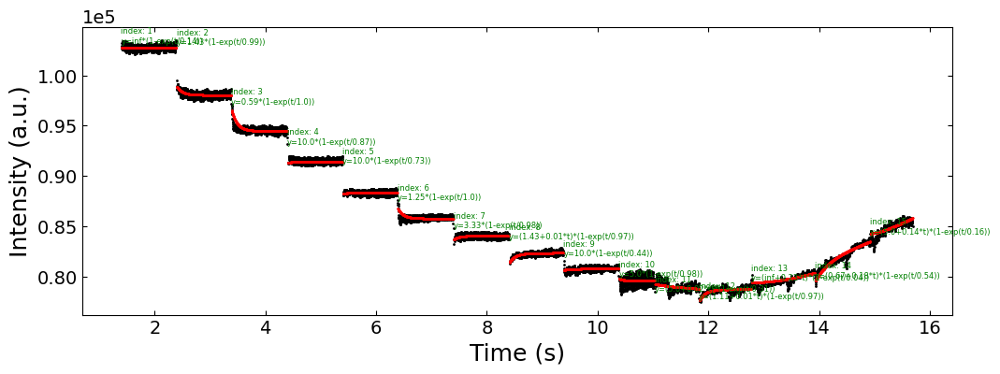

MSE loss:  tensor(0.0008)


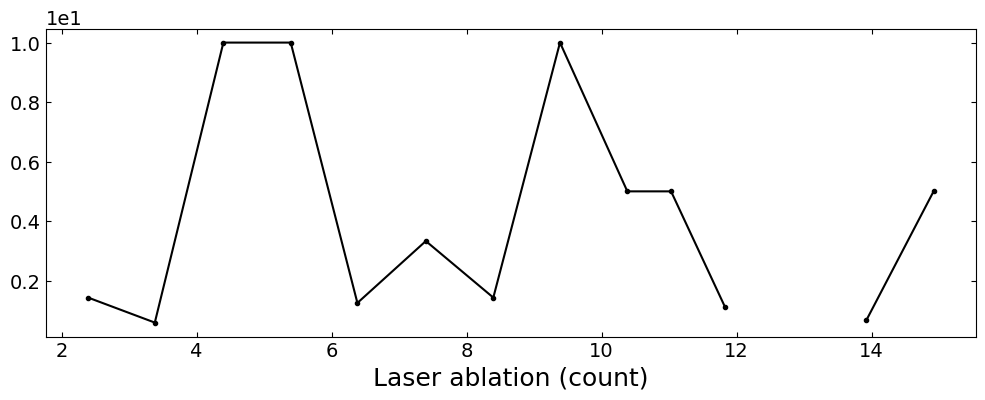

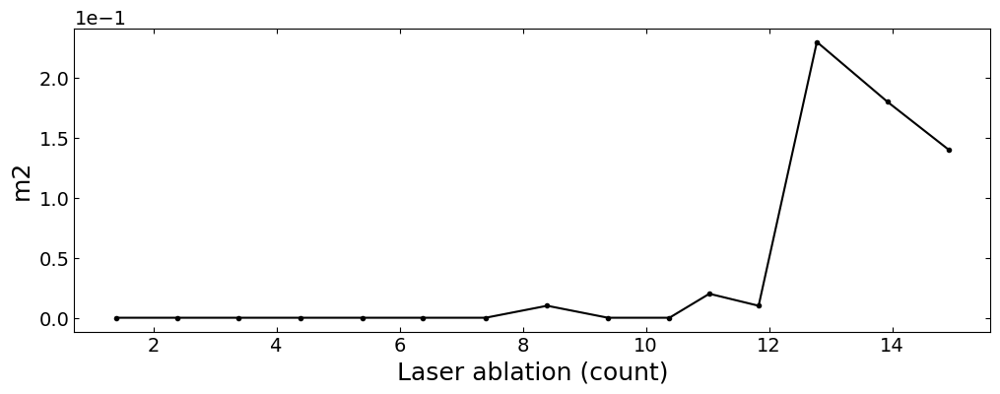

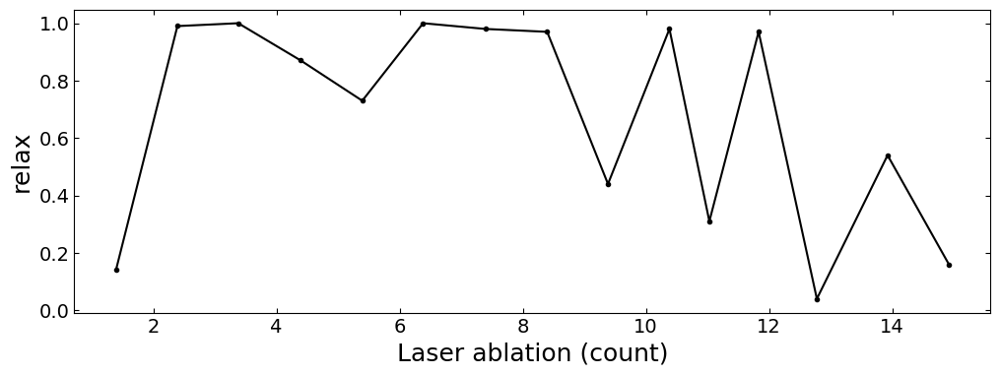

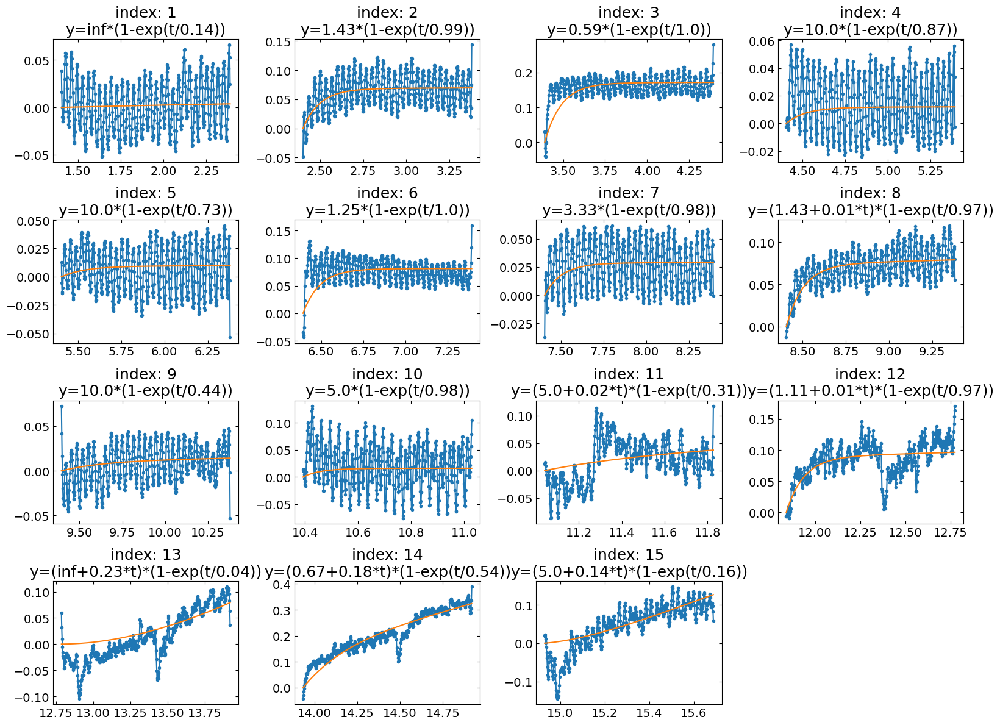

growth_2 :


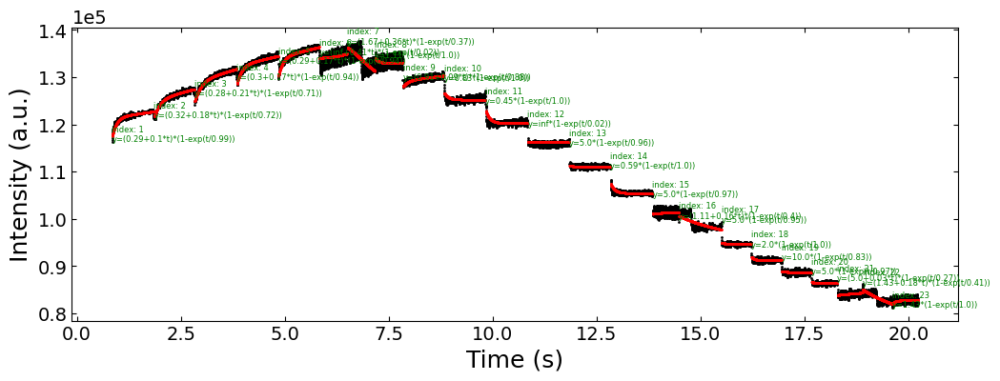

MSE loss:  tensor(0.0033)


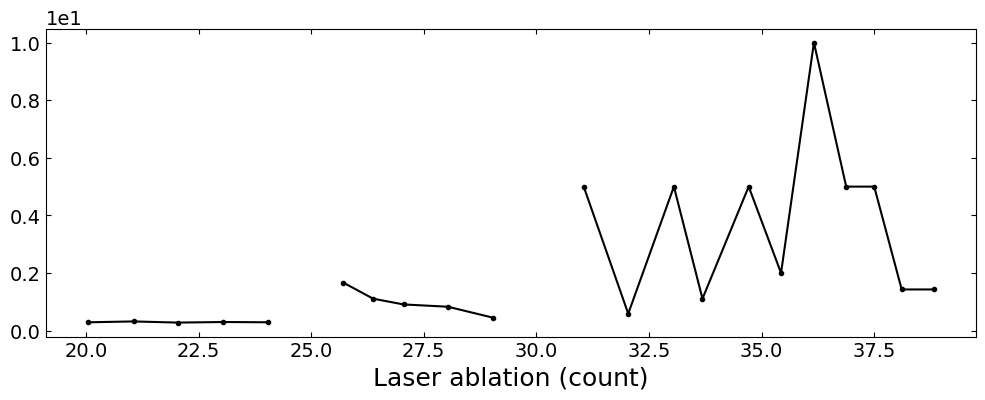

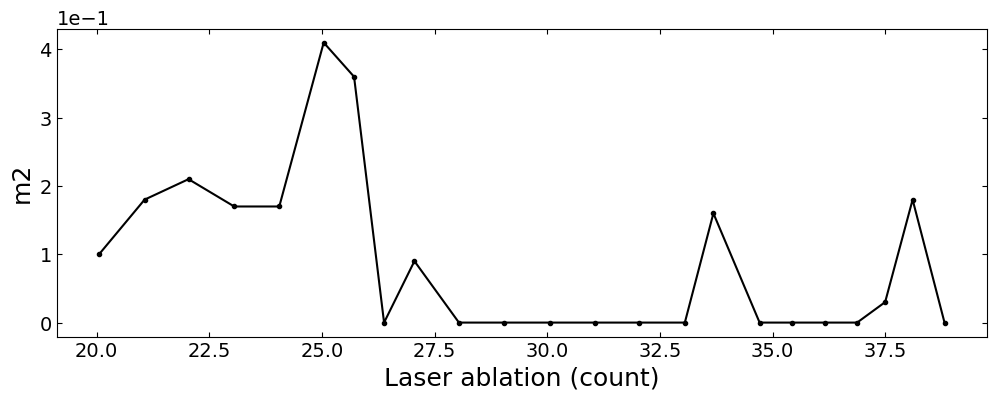

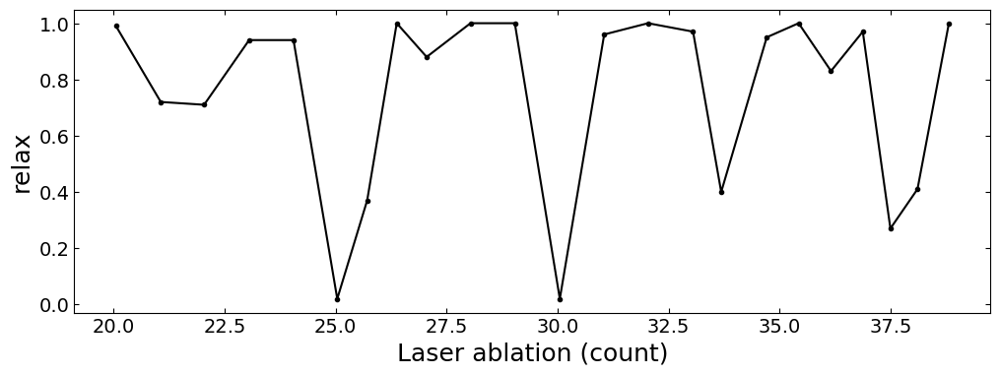

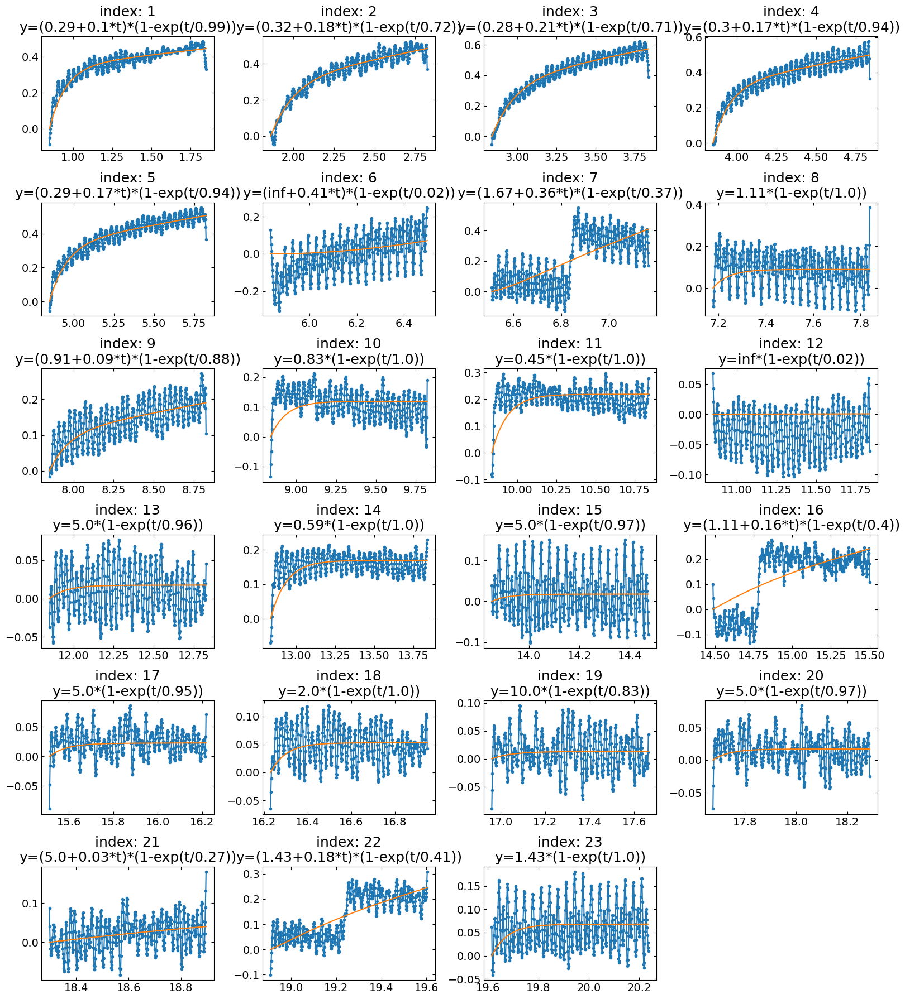

growth_3 :


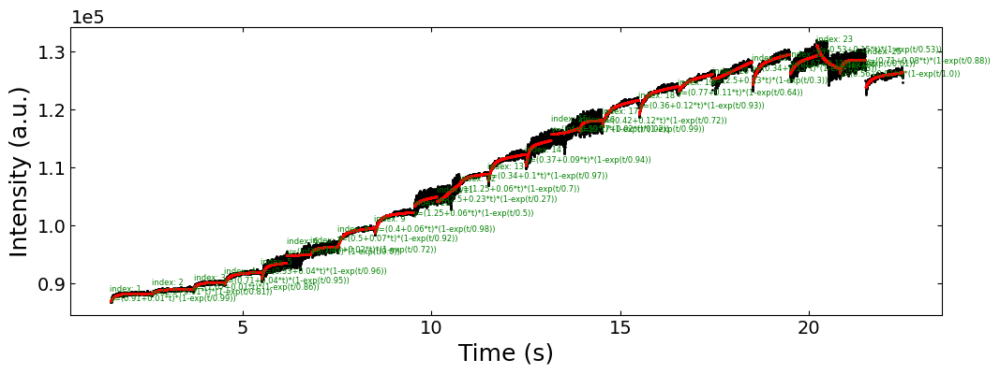

MSE loss:  tensor(0.0034)


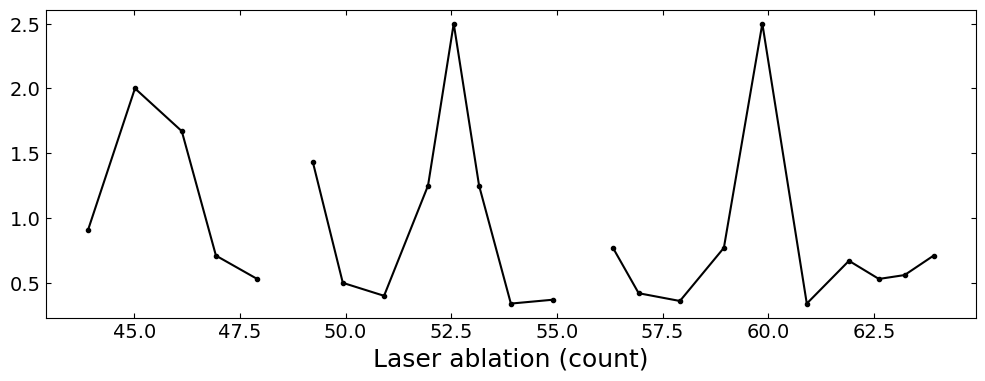

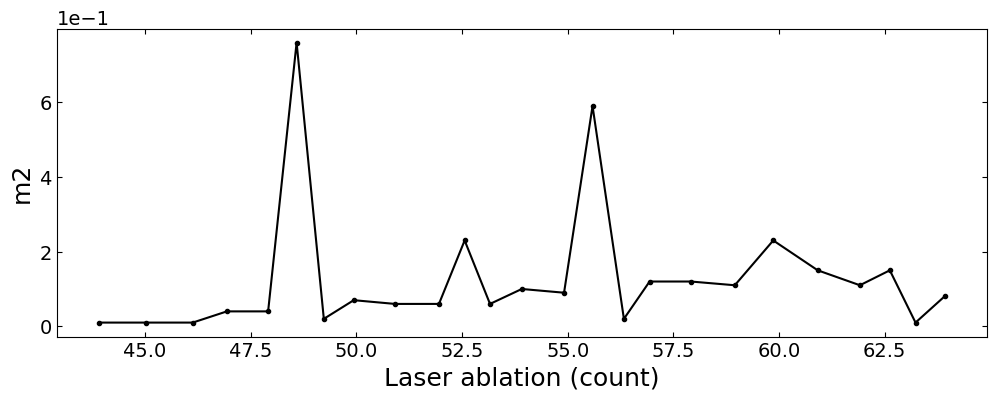

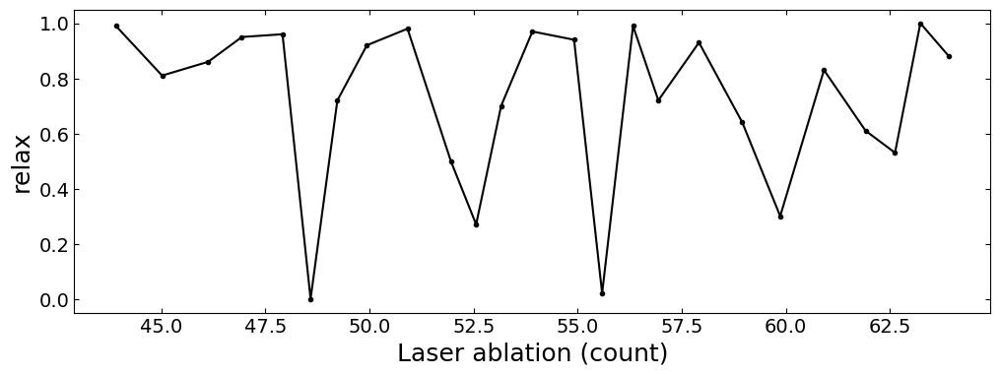

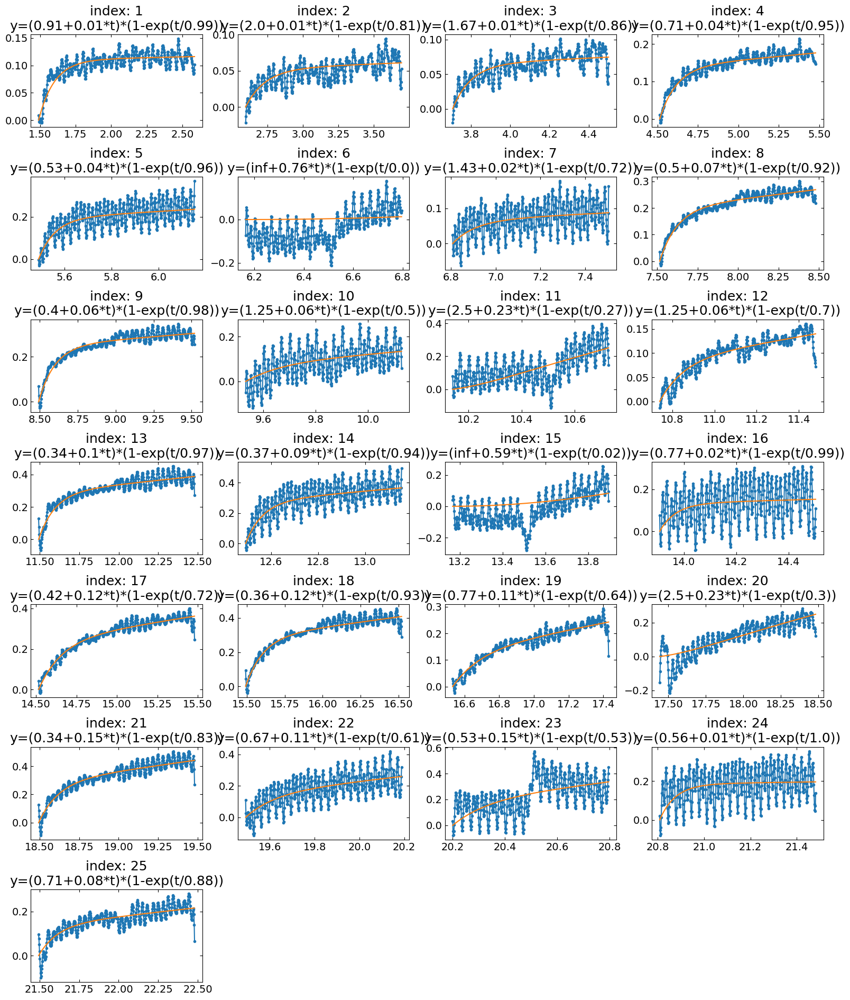

growth_4 :


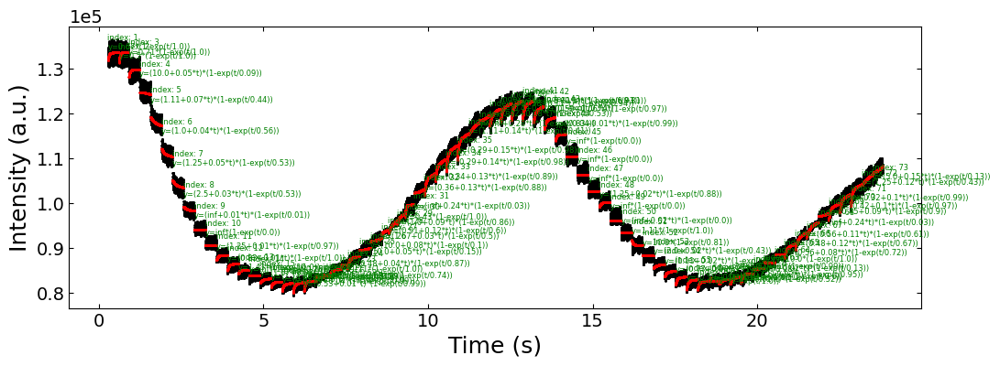

MSE loss:  tensor(0.0071)


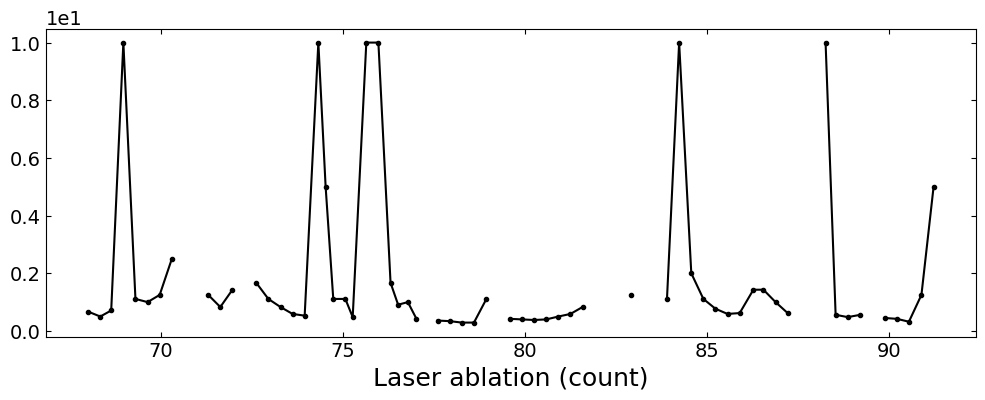

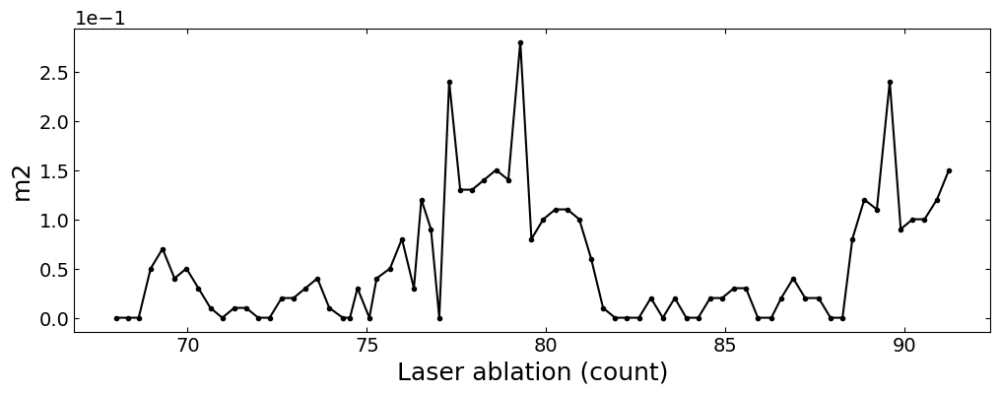

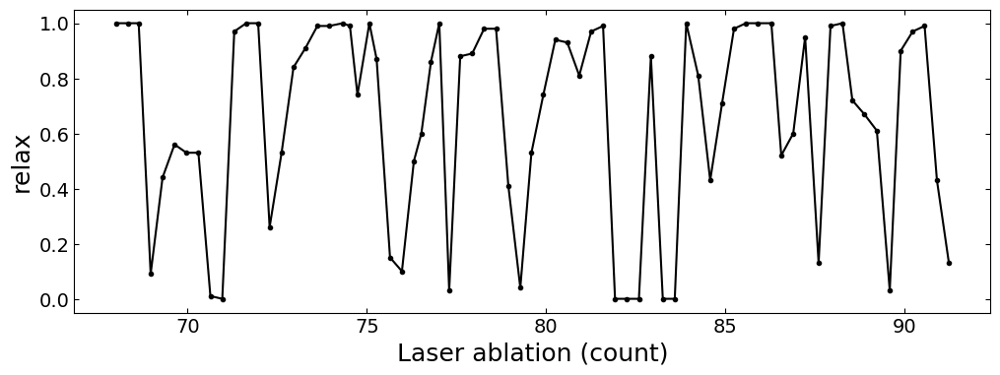

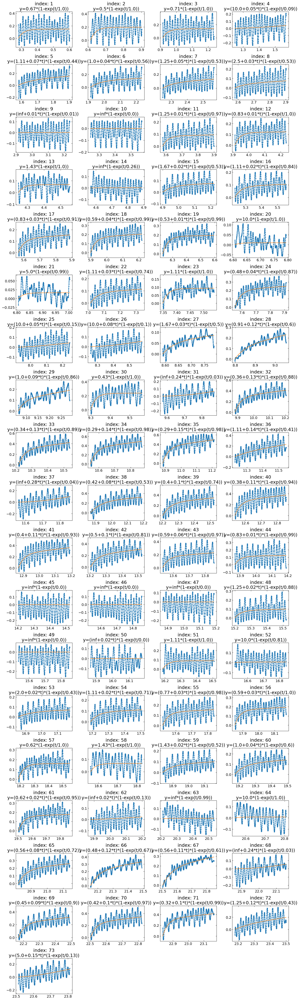

growth_5 :


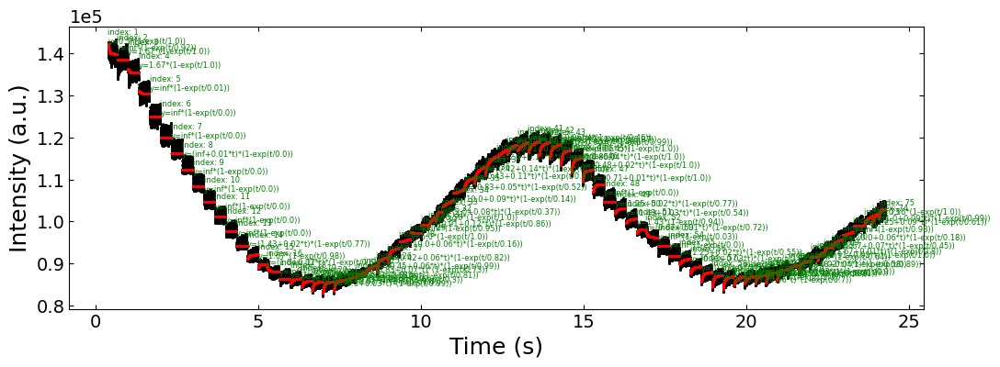

MSE loss:  tensor(0.0084)


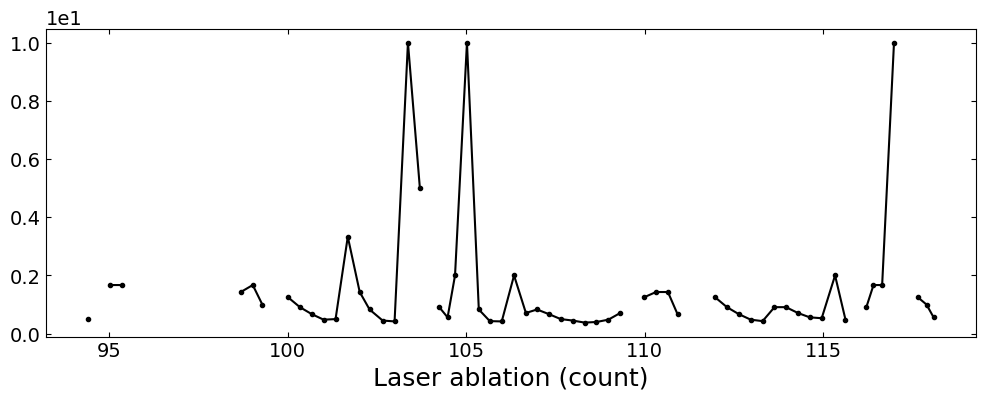

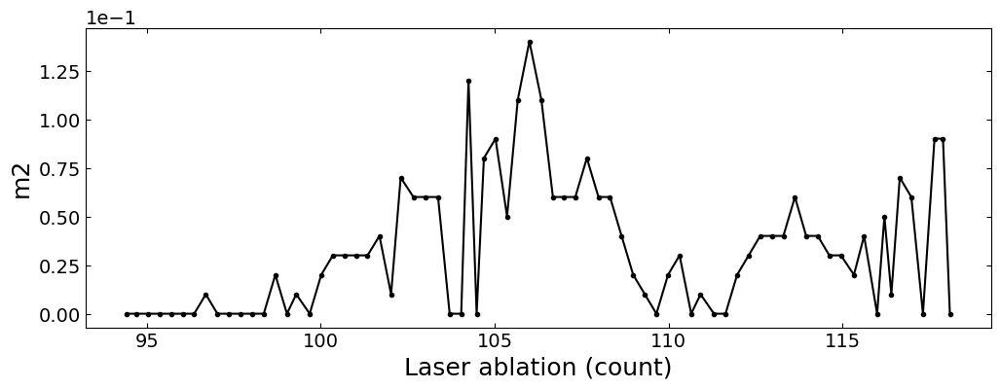

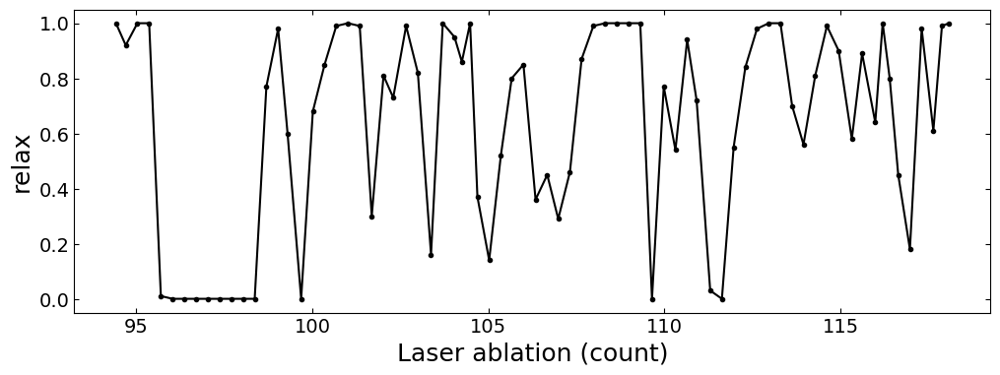

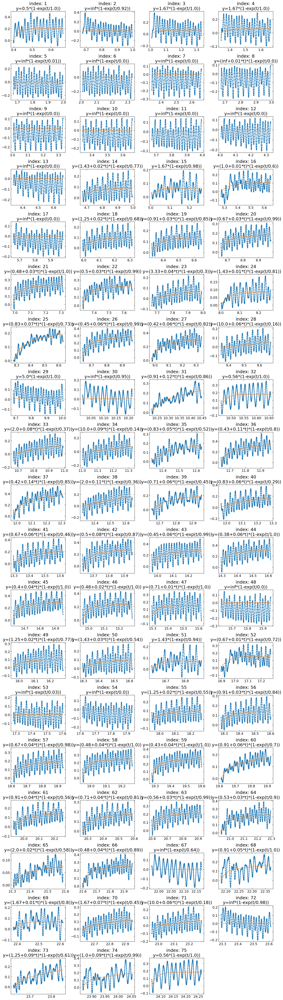

In [6]:
NAME = f'test7_model-baseline'
model_path = '../models/'+NAME+'.pt'

plt.rcParams.update(rc_plot)
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=1000)
parameters_all, x_coor_all, info = analyze_curves_dl(h5_para_file, growth_dict, spot, metric, camera_freq=500, interval=1000, length=500, 
                                                     savgol_window_order=(15,3), pca_component=10,
                                                     visualize=True, I_diff=12000, model_path=model_path)
x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test7_fitting_results(DL).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

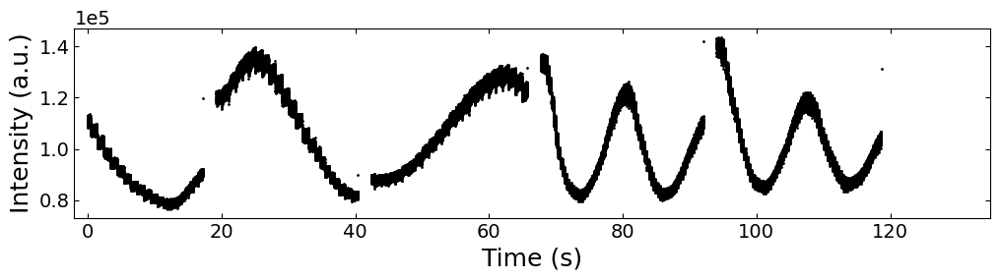

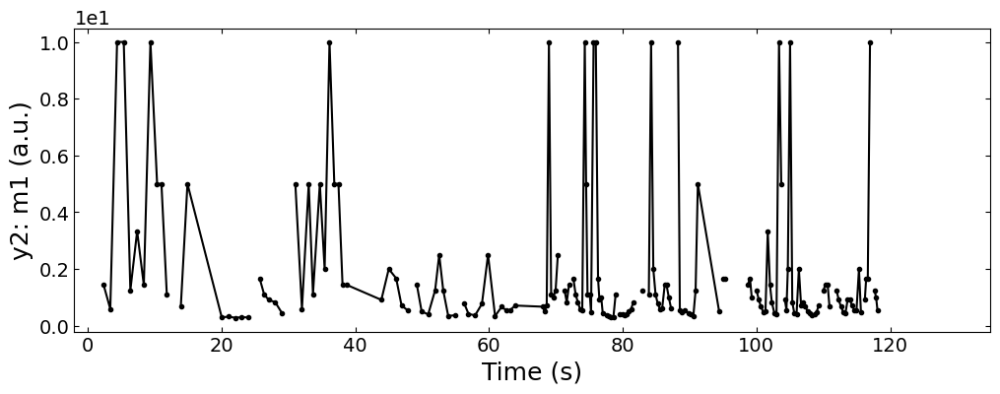

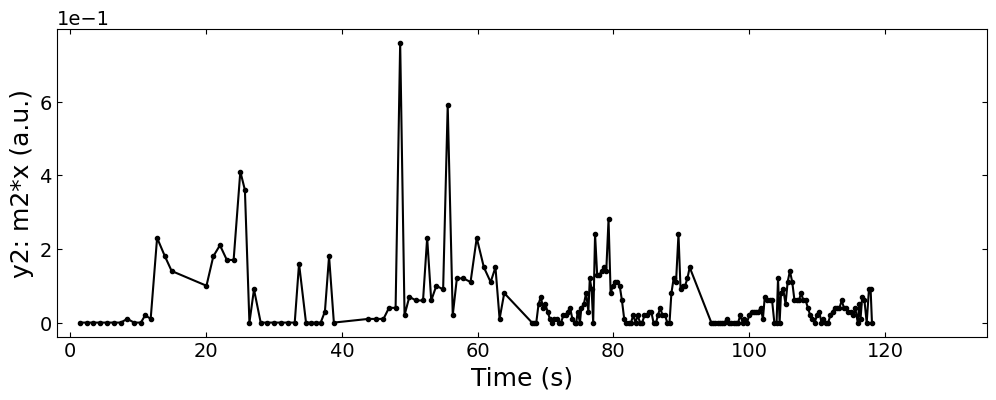

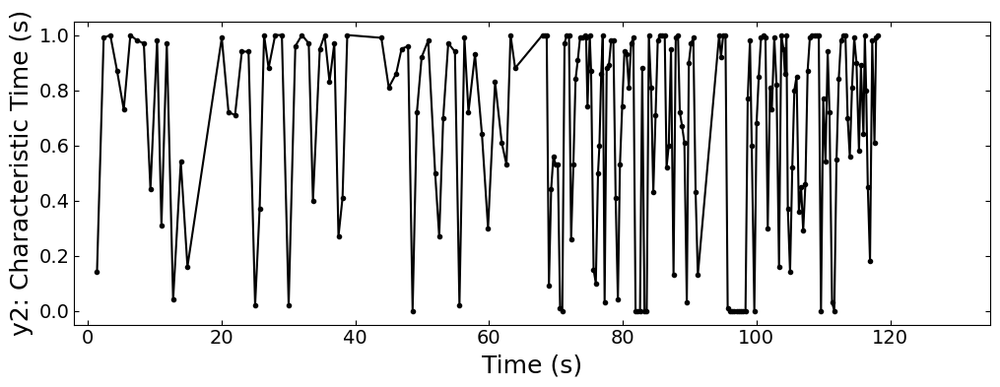

MSE loss for DL model fitting is: 0.006291871520085909


In [8]:
visualize_predictions(x_all, y_all, parameters_all, x_coor_all, info)

# test 9

In [9]:
h5_para_file = '../../data/test9_gaussian_fit_parameters_all.h5'
spot = 'spot_2'
metric = 'img_intensity'
growth_dict = {'growth_01':1, 'growth_02':1, 'growth_03':1, 'growth_04':1, 'growth_05':1}
length = 500
I_diff = 12000

In [9]:
dl, xs_processed, ys_nor_all = prepare_dataloader(h5_para_file, spot, metric, growth_dict, camera_freq=500, 
                                                  length=length, I_diff=I_diff, unify=True, batch_size=32, 
                                                  savgol_window_order=None, pca_component=None, visualize=True)
model = linear_fit_model()
y_fit, parameters = model(torch.randn(32, 1, 500))
print(y_fit.shape, parameters.shape)

NAME = f'test9_model-baseline'
wandb.init(project='RHEED_model', entity='yig319', name=NAME, id=NAME)

device = torch.device('cpu')
model_path = '../models/'+NAME+'.pt'

lr = 1e-3
loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

start = 0
epochs = 500
scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, epochs=epochs, max_lr=lr, 
                            steps_per_epoch=len(dl))

train(model, dl, epochs, start, device, loss_func, optimizer, scheduler, model_path, tracking=True)

torch.Size([32, 1, 500]) torch.Size([32, 3])


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_loss,█▂▃▃▃▁▁▂▁▂▂▃▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,499
train_loss,0.0063


Epoch: 1/500


100%|██████████| 4/4 [00:00<00:00, 16.36it/s]


Training Loss: 0.1010
Epoch: 2/500


100%|██████████| 4/4 [00:00<00:00, 58.24it/s]


Training Loss: 0.0179
Epoch: 3/500


100%|██████████| 4/4 [00:00<00:00, 40.58it/s]


Training Loss: 0.0171
Epoch: 4/500


100%|██████████| 4/4 [00:00<00:00, 57.86it/s]


Training Loss: 0.0181
Epoch: 5/500


100%|██████████| 4/4 [00:00<00:00, 58.61it/s]

Training Loss: 0.0160


Epoch: 6/500


100%|██████████| 4/4 [00:00<00:00, 57.66it/s]


Training Loss: 0.0143
Epoch: 7/500


100%|██████████| 4/4 [00:00<00:00, 55.32it/s]

Training Loss: 0.0147


Epoch: 8/500


100%|██████████| 4/4 [00:00<00:00, 56.54it/s]


Training Loss: 0.0120
Epoch: 9/500


100%|██████████| 4/4 [00:00<00:00, 58.84it/s]

Training Loss: 0.0129


Epoch: 10/500


100%|██████████| 4/4 [00:00<00:00, 29.20it/s]


Training Loss: 0.0112
Epoch: 11/500


100%|██████████| 4/4 [00:00<00:00, 24.51it/s]

Training Loss: 0.0130


Epoch: 12/500


100%|██████████| 4/4 [00:00<00:00, 32.10it/s]


Training Loss: 0.0110
Epoch: 13/500


100%|██████████| 4/4 [00:00<00:00, 47.33it/s]


Training Loss: 0.0105
Epoch: 14/500


100%|██████████| 4/4 [00:00<00:00, 45.01it/s]


Training Loss: 0.0107
Epoch: 15/500


100%|██████████| 4/4 [00:00<00:00, 52.25it/s]


Training Loss: 0.0105
Epoch: 16/500


100%|██████████| 4/4 [00:00<00:00, 48.83it/s]


Training Loss: 0.0105
Epoch: 17/500


100%|██████████| 4/4 [00:00<00:00, 51.68it/s]


Training Loss: 0.0094
Epoch: 18/500


100%|██████████| 4/4 [00:00<00:00, 37.72it/s]


Training Loss: 0.0096
Epoch: 19/500


100%|██████████| 4/4 [00:00<00:00, 47.65it/s]


Training Loss: 0.0100
Epoch: 20/500


100%|██████████| 4/4 [00:00<00:00, 58.14it/s]


Training Loss: 0.0095
Epoch: 21/500


100%|██████████| 4/4 [00:00<00:00, 53.12it/s]


Training Loss: 0.0100
Epoch: 22/500


100%|██████████| 4/4 [00:00<00:00, 56.61it/s]


Training Loss: 0.0092
Epoch: 23/500


100%|██████████| 4/4 [00:00<00:00, 54.44it/s]


Training Loss: 0.0096
Epoch: 24/500


100%|██████████| 4/4 [00:00<00:00, 61.79it/s]


Training Loss: 0.0091
Epoch: 25/500


100%|██████████| 4/4 [00:00<00:00, 29.49it/s]


Training Loss: 0.0092
Epoch: 26/500


100%|██████████| 4/4 [00:00<00:00, 51.88it/s]


Training Loss: 0.0092
Epoch: 27/500


100%|██████████| 4/4 [00:00<00:00, 26.97it/s]


Training Loss: 0.0093
Epoch: 28/500


100%|██████████| 4/4 [00:00<00:00, 61.28it/s]


Training Loss: 0.0095
Epoch: 29/500


100%|██████████| 4/4 [00:00<00:00, 53.55it/s]


Training Loss: 0.0090
Epoch: 30/500


100%|██████████| 4/4 [00:00<00:00, 58.37it/s]


Training Loss: 0.0093
Epoch: 31/500


100%|██████████| 4/4 [00:00<00:00, 61.53it/s]


Training Loss: 0.0094
Epoch: 32/500


100%|██████████| 4/4 [00:00<00:00, 61.02it/s]


Training Loss: 0.0095
Epoch: 33/500


100%|██████████| 4/4 [00:00<00:00, 57.56it/s]

Training Loss: 0.0092


Epoch: 34/500


100%|██████████| 4/4 [00:00<00:00, 61.75it/s]


Training Loss: 0.0094
Epoch: 35/500


100%|██████████| 4/4 [00:00<00:00, 60.49it/s]

Training Loss: 0.0090


Epoch: 36/500


100%|██████████| 4/4 [00:00<00:00, 52.39it/s]


Training Loss: 0.0090
Epoch: 37/500


100%|██████████| 4/4 [00:00<00:00, 29.58it/s]


Training Loss: 0.0091
Epoch: 38/500


100%|██████████| 4/4 [00:00<00:00, 44.96it/s]


Training Loss: 0.0090
Epoch: 39/500


100%|██████████| 4/4 [00:00<00:00, 58.91it/s]


Training Loss: 0.0092
Epoch: 40/500


100%|██████████| 4/4 [00:00<00:00, 59.20it/s]


Training Loss: 0.0093
Epoch: 41/500


100%|██████████| 4/4 [00:00<00:00, 58.26it/s]


Training Loss: 0.0087
Epoch: 42/500


100%|██████████| 4/4 [00:00<00:00, 58.85it/s]


Training Loss: 0.0089
Epoch: 43/500


100%|██████████| 4/4 [00:00<00:00, 61.10it/s]


Training Loss: 0.0090
Epoch: 44/500


100%|██████████| 4/4 [00:00<00:00, 60.77it/s]


Training Loss: 0.0090
Epoch: 45/500


100%|██████████| 4/4 [00:00<00:00, 28.70it/s]


Training Loss: 0.0087
Epoch: 46/500


100%|██████████| 4/4 [00:00<00:00, 60.96it/s]


Training Loss: 0.0093
Epoch: 47/500


100%|██████████| 4/4 [00:00<00:00, 60.19it/s]


Training Loss: 0.0092
Epoch: 48/500


100%|██████████| 4/4 [00:00<00:00, 61.68it/s]


Training Loss: 0.0098
Epoch: 49/500


100%|██████████| 4/4 [00:00<00:00, 61.01it/s]


Training Loss: 0.0099
Epoch: 50/500


100%|██████████| 4/4 [00:00<00:00, 35.32it/s]


Training Loss: 0.0102
Epoch: 51/500


100%|██████████| 4/4 [00:00<00:00, 61.54it/s]


Training Loss: 0.0111
Epoch: 52/500


100%|██████████| 4/4 [00:00<00:00, 60.61it/s]


Training Loss: 0.0100
Epoch: 53/500


100%|██████████| 4/4 [00:00<00:00, 59.99it/s]


Training Loss: 0.0105
Epoch: 54/500


100%|██████████| 4/4 [00:00<00:00, 58.89it/s]


Training Loss: 0.0115
Epoch: 55/500


100%|██████████| 4/4 [00:00<00:00, 58.79it/s]


Training Loss: 0.0097
Epoch: 56/500


100%|██████████| 4/4 [00:00<00:00, 60.16it/s]


Training Loss: 0.0096
Epoch: 57/500


100%|██████████| 4/4 [00:00<00:00, 60.09it/s]

Training Loss: 0.0098


Epoch: 58/500


100%|██████████| 4/4 [00:00<00:00, 59.96it/s]

Training Loss: 0.0101


Epoch: 59/500


100%|██████████| 4/4 [00:00<00:00, 60.50it/s]


Training Loss: 0.0095
Epoch: 60/500


100%|██████████| 4/4 [00:00<00:00, 27.41it/s]


Training Loss: 0.0093
Epoch: 61/500


100%|██████████| 4/4 [00:00<00:00, 40.34it/s]


Training Loss: 0.0091
Epoch: 62/500


100%|██████████| 4/4 [00:00<00:00, 56.84it/s]


Training Loss: 0.0096
Epoch: 63/500


100%|██████████| 4/4 [00:00<00:00, 57.29it/s]


Training Loss: 0.0088
Epoch: 64/500


100%|██████████| 4/4 [00:00<00:00, 57.05it/s]


Training Loss: 0.0092
Epoch: 65/500


100%|██████████| 4/4 [00:00<00:00, 57.98it/s]


Training Loss: 0.0091
Epoch: 66/500


100%|██████████| 4/4 [00:00<00:00, 29.48it/s]


Training Loss: 0.0101
Epoch: 67/500


100%|██████████| 4/4 [00:00<00:00, 61.11it/s]


Training Loss: 0.0092
Epoch: 68/500


100%|██████████| 4/4 [00:00<00:00, 60.51it/s]


Training Loss: 0.0089
Epoch: 69/500


100%|██████████| 4/4 [00:00<00:00, 60.96it/s]


Training Loss: 0.0092
Epoch: 70/500


100%|██████████| 4/4 [00:00<00:00, 58.93it/s]


Training Loss: 0.0092
Epoch: 71/500


100%|██████████| 4/4 [00:00<00:00, 61.37it/s]


Training Loss: 0.0088
Epoch: 72/500


100%|██████████| 4/4 [00:00<00:00, 60.18it/s]

Training Loss: 0.0089


Epoch: 73/500


100%|██████████| 4/4 [00:00<00:00, 60.40it/s]

Training Loss: 0.0097


Epoch: 74/500


100%|██████████| 4/4 [00:00<00:00, 60.12it/s]

Training Loss: 0.0095


Epoch: 75/500


100%|██████████| 4/4 [00:00<00:00, 34.95it/s]


Training Loss: 0.0093
Epoch: 76/500


100%|██████████| 4/4 [00:00<00:00, 60.78it/s]


Training Loss: 0.0090
Epoch: 77/500


100%|██████████| 4/4 [00:00<00:00, 60.43it/s]


Training Loss: 0.0090
Epoch: 78/500


100%|██████████| 4/4 [00:00<00:00, 60.88it/s]


Training Loss: 0.0091
Epoch: 79/500


100%|██████████| 4/4 [00:00<00:00, 61.29it/s]


Training Loss: 0.0087
Epoch: 80/500


100%|██████████| 4/4 [00:00<00:00, 61.19it/s]


Training Loss: 0.0096
Epoch: 81/500


100%|██████████| 4/4 [00:00<00:00, 60.36it/s]


Training Loss: 0.0089
Epoch: 82/500


100%|██████████| 4/4 [00:00<00:00, 59.36it/s]

Training Loss: 0.0089


Epoch: 83/500


100%|██████████| 4/4 [00:00<00:00, 22.46it/s]


Training Loss: 0.0091
Epoch: 84/500


100%|██████████| 4/4 [00:00<00:00, 25.33it/s]


Training Loss: 0.0091
Epoch: 85/500


100%|██████████| 4/4 [00:00<00:00, 38.26it/s]


Training Loss: 0.0092
Epoch: 86/500


100%|██████████| 4/4 [00:00<00:00, 55.60it/s]


Training Loss: 0.0099
Epoch: 87/500


100%|██████████| 4/4 [00:00<00:00, 54.48it/s]


Training Loss: 0.0104
Epoch: 88/500


100%|██████████| 4/4 [00:00<00:00, 47.55it/s]


Training Loss: 0.0108
Epoch: 89/500


100%|██████████| 4/4 [00:00<00:00, 60.99it/s]


Training Loss: 0.0105
Epoch: 90/500


100%|██████████| 4/4 [00:00<00:00, 61.29it/s]


Training Loss: 0.0104
Epoch: 91/500


100%|██████████| 4/4 [00:00<00:00, 60.27it/s]


Training Loss: 0.0103
Epoch: 92/500


100%|██████████| 4/4 [00:00<00:00, 13.72it/s]


Training Loss: 0.0104
Epoch: 93/500


100%|██████████| 4/4 [00:00<00:00, 56.05it/s]


Training Loss: 0.0101
Epoch: 94/500


100%|██████████| 4/4 [00:00<00:00, 54.78it/s]


Training Loss: 0.0090
Epoch: 95/500


100%|██████████| 4/4 [00:00<00:00, 54.35it/s]


Training Loss: 0.0102
Epoch: 96/500


100%|██████████| 4/4 [00:00<00:00, 54.90it/s]


Training Loss: 0.0094
Epoch: 97/500


100%|██████████| 4/4 [00:00<00:00, 54.73it/s]


Training Loss: 0.0092
Epoch: 98/500


100%|██████████| 4/4 [00:00<00:00, 34.68it/s]


Training Loss: 0.0098
Epoch: 99/500


100%|██████████| 4/4 [00:00<00:00, 41.15it/s]


Training Loss: 0.0095
Epoch: 100/500


100%|██████████| 4/4 [00:00<00:00, 35.10it/s]


Training Loss: 0.0091
Epoch: 101/500


100%|██████████| 4/4 [00:00<00:00, 56.15it/s]


Training Loss: 0.0096
Epoch: 102/500


100%|██████████| 4/4 [00:00<00:00, 53.98it/s]


Training Loss: 0.0090
Epoch: 103/500


100%|██████████| 4/4 [00:00<00:00, 25.76it/s]


Training Loss: 0.0093
Epoch: 104/500


100%|██████████| 4/4 [00:00<00:00, 27.57it/s]


Training Loss: 0.0090
Epoch: 105/500


100%|██████████| 4/4 [00:00<00:00, 28.57it/s]


Training Loss: 0.0093
Epoch: 106/500


100%|██████████| 4/4 [00:00<00:00, 26.05it/s]


Training Loss: 0.0090
Epoch: 107/500


100%|██████████| 4/4 [00:00<00:00, 50.98it/s]


Training Loss: 0.0092
Epoch: 108/500


100%|██████████| 4/4 [00:00<00:00, 51.12it/s]


Training Loss: 0.0090
Epoch: 109/500


100%|██████████| 4/4 [00:00<00:00, 54.57it/s]


Training Loss: 0.0087
Epoch: 110/500


100%|██████████| 4/4 [00:00<00:00, 55.91it/s]


Training Loss: 0.0087
Epoch: 111/500


100%|██████████| 4/4 [00:00<00:00, 55.38it/s]


Training Loss: 0.0088
Epoch: 112/500


100%|██████████| 4/4 [00:00<00:00, 53.17it/s]


Training Loss: 0.0094
Epoch: 113/500


100%|██████████| 4/4 [00:00<00:00, 28.95it/s]


Training Loss: 0.0105
Epoch: 114/500


100%|██████████| 4/4 [00:00<00:00, 55.90it/s]


Training Loss: 0.0105
Epoch: 115/500


100%|██████████| 4/4 [00:00<00:00, 55.94it/s]

Training Loss: 0.0113


Epoch: 116/500


100%|██████████| 4/4 [00:00<00:00, 53.98it/s]


Training Loss: 0.0105
Epoch: 117/500


100%|██████████| 4/4 [00:00<00:00, 54.33it/s]


Training Loss: 0.0093
Epoch: 118/500


100%|██████████| 4/4 [00:00<00:00, 54.98it/s]


Training Loss: 0.0110
Epoch: 119/500


100%|██████████| 4/4 [00:00<00:00, 55.53it/s]


Training Loss: 0.0093
Epoch: 120/500


100%|██████████| 4/4 [00:00<00:00, 54.79it/s]


Training Loss: 0.0097
Epoch: 121/500


100%|██████████| 4/4 [00:00<00:00, 50.05it/s]


Training Loss: 0.0090
Epoch: 122/500


100%|██████████| 4/4 [00:00<00:00, 53.86it/s]


Training Loss: 0.0089
Epoch: 123/500


100%|██████████| 4/4 [00:00<00:00, 55.70it/s]


Training Loss: 0.0091
Epoch: 124/500


100%|██████████| 4/4 [00:00<00:00, 46.40it/s]


Training Loss: 0.0091
Epoch: 125/500


100%|██████████| 4/4 [00:00<00:00, 18.87it/s]


Training Loss: 0.0103
Epoch: 126/500


100%|██████████| 4/4 [00:00<00:00, 55.76it/s]


Training Loss: 0.0088
Epoch: 127/500


100%|██████████| 4/4 [00:00<00:00, 51.57it/s]


Training Loss: 0.0090
Epoch: 128/500


100%|██████████| 4/4 [00:00<00:00, 50.31it/s]


Training Loss: 0.0093
Epoch: 129/500


100%|██████████| 4/4 [00:00<00:00, 54.09it/s]


Training Loss: 0.0092
Epoch: 130/500


100%|██████████| 4/4 [00:00<00:00, 29.48it/s]


Training Loss: 0.0094
Epoch: 131/500


100%|██████████| 4/4 [00:00<00:00, 55.32it/s]


Training Loss: 0.0096
Epoch: 132/500


100%|██████████| 4/4 [00:00<00:00, 54.70it/s]


Training Loss: 0.0096
Epoch: 133/500


100%|██████████| 4/4 [00:00<00:00, 55.50it/s]


Training Loss: 0.0100
Epoch: 134/500


100%|██████████| 4/4 [00:00<00:00, 55.41it/s]


Training Loss: 0.0097
Epoch: 135/500


100%|██████████| 4/4 [00:00<00:00, 54.94it/s]


Training Loss: 0.0108
Epoch: 136/500


100%|██████████| 4/4 [00:00<00:00, 54.23it/s]


Training Loss: 0.0101
Epoch: 137/500


100%|██████████| 4/4 [00:00<00:00, 55.20it/s]


Training Loss: 0.0093
Epoch: 138/500


100%|██████████| 4/4 [00:00<00:00, 55.70it/s]


Training Loss: 0.0090
Epoch: 139/500


100%|██████████| 4/4 [00:00<00:00, 54.18it/s]


Training Loss: 0.0090
Epoch: 140/500


100%|██████████| 4/4 [00:00<00:00, 53.63it/s]


Training Loss: 0.0092
Epoch: 141/500


100%|██████████| 4/4 [00:00<00:00, 55.58it/s]


Training Loss: 0.0088
Epoch: 142/500


100%|██████████| 4/4 [00:00<00:00, 54.77it/s]


Training Loss: 0.0087
Epoch: 143/500


100%|██████████| 4/4 [00:00<00:00, 55.27it/s]


Training Loss: 0.0092
Epoch: 144/500


100%|██████████| 4/4 [00:00<00:00, 54.40it/s]


Training Loss: 0.0093
Epoch: 145/500


100%|██████████| 4/4 [00:00<00:00, 55.66it/s]


Training Loss: 0.0090
Epoch: 146/500


100%|██████████| 4/4 [00:00<00:00, 26.60it/s]


Training Loss: 0.0089
Epoch: 147/500


100%|██████████| 4/4 [00:00<00:00, 17.36it/s]


Training Loss: 0.0087
Epoch: 148/500


100%|██████████| 4/4 [00:00<00:00, 41.04it/s]


Training Loss: 0.0086
Epoch: 149/500


100%|██████████| 4/4 [00:00<00:00, 54.03it/s]


Training Loss: 0.0089
Epoch: 150/500


100%|██████████| 4/4 [00:00<00:00, 32.54it/s]


Training Loss: 0.0089
Epoch: 151/500


100%|██████████| 4/4 [00:00<00:00, 56.38it/s]


Training Loss: 0.0091
Epoch: 152/500


100%|██████████| 4/4 [00:00<00:00, 55.59it/s]

Training Loss: 0.0088


Epoch: 153/500


100%|██████████| 4/4 [00:00<00:00, 55.04it/s]


Training Loss: 0.0089
Epoch: 154/500


100%|██████████| 4/4 [00:00<00:00, 53.58it/s]


Training Loss: 0.0091
Epoch: 155/500


100%|██████████| 4/4 [00:00<00:00, 55.46it/s]


Training Loss: 0.0089
Epoch: 156/500


100%|██████████| 4/4 [00:00<00:00, 55.34it/s]


Training Loss: 0.0090
Epoch: 157/500


100%|██████████| 4/4 [00:00<00:00, 55.14it/s]


Training Loss: 0.0089
Epoch: 158/500


100%|██████████| 4/4 [00:00<00:00, 53.77it/s]


Training Loss: 0.0087
Epoch: 159/500


100%|██████████| 4/4 [00:00<00:00, 54.98it/s]


Training Loss: 0.0086
Epoch: 160/500


100%|██████████| 4/4 [00:00<00:00, 54.98it/s]


Training Loss: 0.0089
Epoch: 161/500


100%|██████████| 4/4 [00:00<00:00, 54.89it/s]


Training Loss: 0.0090
Epoch: 162/500


100%|██████████| 4/4 [00:00<00:00, 37.00it/s]


Training Loss: 0.0092
Epoch: 163/500


100%|██████████| 4/4 [00:00<00:00, 36.68it/s]


Training Loss: 0.0092
Epoch: 164/500


100%|██████████| 4/4 [00:00<00:00, 53.44it/s]


Training Loss: 0.0089
Epoch: 165/500


100%|██████████| 4/4 [00:00<00:00, 55.55it/s]


Training Loss: 0.0087
Epoch: 166/500


100%|██████████| 4/4 [00:00<00:00, 50.47it/s]


Training Loss: 0.0092
Epoch: 167/500


100%|██████████| 4/4 [00:00<00:00, 29.07it/s]


Training Loss: 0.0085
Epoch: 168/500


100%|██████████| 4/4 [00:00<00:00, 34.46it/s]


Training Loss: 0.0087
Epoch: 169/500


100%|██████████| 4/4 [00:00<00:00, 51.53it/s]


Training Loss: 0.0086
Epoch: 170/500


100%|██████████| 4/4 [00:00<00:00, 35.37it/s]


Training Loss: 0.0088
Epoch: 171/500


100%|██████████| 4/4 [00:00<00:00, 27.07it/s]


Training Loss: 0.0089
Epoch: 172/500


100%|██████████| 4/4 [00:00<00:00, 25.97it/s]


Training Loss: 0.0092
Epoch: 173/500


100%|██████████| 4/4 [00:00<00:00, 56.79it/s]


Training Loss: 0.0087
Epoch: 174/500


100%|██████████| 4/4 [00:00<00:00, 54.66it/s]

Training Loss: 0.0087


Epoch: 175/500


100%|██████████| 4/4 [00:00<00:00, 36.04it/s]


Training Loss: 0.0085
Epoch: 176/500


100%|██████████| 4/4 [00:00<00:00, 55.15it/s]


Training Loss: 0.0088
Epoch: 177/500


100%|██████████| 4/4 [00:00<00:00, 25.55it/s]


Training Loss: 0.0087
Epoch: 178/500


100%|██████████| 4/4 [00:00<00:00, 55.46it/s]


Training Loss: 0.0090
Epoch: 179/500


100%|██████████| 4/4 [00:00<00:00, 49.49it/s]


Training Loss: 0.0094
Epoch: 180/500


100%|██████████| 4/4 [00:00<00:00, 54.34it/s]


Training Loss: 0.0087
Epoch: 181/500


100%|██████████| 4/4 [00:00<00:00, 55.70it/s]


Training Loss: 0.0094
Epoch: 182/500


100%|██████████| 4/4 [00:00<00:00, 55.65it/s]


Training Loss: 0.0094
Epoch: 183/500


100%|██████████| 4/4 [00:00<00:00, 53.23it/s]


Training Loss: 0.0091
Epoch: 184/500


100%|██████████| 4/4 [00:00<00:00, 56.21it/s]


Training Loss: 0.0090
Epoch: 185/500


100%|██████████| 4/4 [00:00<00:00, 55.09it/s]


Training Loss: 0.0089
Epoch: 186/500


100%|██████████| 4/4 [00:00<00:00, 53.76it/s]


Training Loss: 0.0091
Epoch: 187/500


100%|██████████| 4/4 [00:00<00:00, 54.98it/s]


Training Loss: 0.0096
Epoch: 188/500


100%|██████████| 4/4 [00:00<00:00, 33.50it/s]


Training Loss: 0.0096
Epoch: 189/500


100%|██████████| 4/4 [00:00<00:00, 29.43it/s]


Training Loss: 0.0090
Epoch: 190/500


100%|██████████| 4/4 [00:00<00:00, 52.96it/s]


Training Loss: 0.0088
Epoch: 191/500


100%|██████████| 4/4 [00:00<00:00, 51.61it/s]


Training Loss: 0.0089
Epoch: 192/500


100%|██████████| 4/4 [00:00<00:00, 46.77it/s]


Training Loss: 0.0093
Epoch: 193/500


100%|██████████| 4/4 [00:00<00:00, 49.45it/s]


Training Loss: 0.0086
Epoch: 194/500


100%|██████████| 4/4 [00:00<00:00, 26.46it/s]


Training Loss: 0.0086
Epoch: 195/500


100%|██████████| 4/4 [00:00<00:00, 54.81it/s]


Training Loss: 0.0090
Epoch: 196/500


100%|██████████| 4/4 [00:00<00:00, 55.56it/s]

Training Loss: 0.0091


Epoch: 197/500


100%|██████████| 4/4 [00:00<00:00, 55.65it/s]


Training Loss: 0.0088
Epoch: 198/500


100%|██████████| 4/4 [00:00<00:00, 53.21it/s]


Training Loss: 0.0090
Epoch: 199/500


100%|██████████| 4/4 [00:00<00:00, 54.83it/s]


Training Loss: 0.0088
Epoch: 200/500


100%|██████████| 4/4 [00:00<00:00, 36.03it/s]


Training Loss: 0.0087
Epoch: 201/500


100%|██████████| 4/4 [00:00<00:00, 54.90it/s]


Training Loss: 0.0086
Epoch: 202/500


100%|██████████| 4/4 [00:00<00:00, 53.73it/s]


Training Loss: 0.0088
Epoch: 203/500


100%|██████████| 4/4 [00:00<00:00, 55.82it/s]


Training Loss: 0.0086
Epoch: 204/500


100%|██████████| 4/4 [00:00<00:00, 55.36it/s]


Training Loss: 0.0087
Epoch: 205/500


100%|██████████| 4/4 [00:00<00:00, 55.67it/s]


Training Loss: 0.0094
Epoch: 206/500


100%|██████████| 4/4 [00:00<00:00, 53.70it/s]


Training Loss: 0.0091
Epoch: 207/500


100%|██████████| 4/4 [00:00<00:00, 55.98it/s]


Training Loss: 0.0091
Epoch: 208/500


100%|██████████| 4/4 [00:00<00:00, 55.88it/s]


Training Loss: 0.0088
Epoch: 209/500


100%|██████████| 4/4 [00:00<00:00, 26.45it/s]


Training Loss: 0.0087
Epoch: 210/500


100%|██████████| 4/4 [00:00<00:00, 48.78it/s]


Training Loss: 0.0086
Epoch: 211/500


100%|██████████| 4/4 [00:00<00:00, 56.05it/s]


Training Loss: 0.0086
Epoch: 212/500


100%|██████████| 4/4 [00:00<00:00, 52.68it/s]


Training Loss: 0.0087
Epoch: 213/500


100%|██████████| 4/4 [00:00<00:00, 50.34it/s]


Training Loss: 0.0086
Epoch: 214/500


100%|██████████| 4/4 [00:00<00:00, 50.32it/s]


Training Loss: 0.0086
Epoch: 215/500


100%|██████████| 4/4 [00:00<00:00, 28.77it/s]


Training Loss: 0.0086
Epoch: 216/500


100%|██████████| 4/4 [00:00<00:00, 56.49it/s]


Training Loss: 0.0087
Epoch: 217/500


100%|██████████| 4/4 [00:00<00:00, 54.71it/s]

Training Loss: 0.0089


Epoch: 218/500


100%|██████████| 4/4 [00:00<00:00, 55.75it/s]


Training Loss: 0.0085
Epoch: 219/500


100%|██████████| 4/4 [00:00<00:00, 54.98it/s]

Training Loss: 0.0086


Epoch: 220/500


100%|██████████| 4/4 [00:00<00:00, 55.79it/s]


Training Loss: 0.0086
Epoch: 221/500


100%|██████████| 4/4 [00:00<00:00, 55.09it/s]

Training Loss: 0.0086


Epoch: 222/500


100%|██████████| 4/4 [00:00<00:00, 54.63it/s]


Training Loss: 0.0086
Epoch: 223/500


100%|██████████| 4/4 [00:00<00:00, 55.82it/s]

Training Loss: 0.0086


Epoch: 224/500


100%|██████████| 4/4 [00:00<00:00, 55.69it/s]


Training Loss: 0.0087
Epoch: 225/500


100%|██████████| 4/4 [00:00<00:00, 33.70it/s]


Training Loss: 0.0087
Epoch: 226/500


100%|██████████| 4/4 [00:00<00:00, 56.46it/s]


Training Loss: 0.0086
Epoch: 227/500


100%|██████████| 4/4 [00:00<00:00, 55.90it/s]


Training Loss: 0.0085
Epoch: 228/500


100%|██████████| 4/4 [00:00<00:00, 56.16it/s]


Training Loss: 0.0086
Epoch: 229/500


100%|██████████| 4/4 [00:00<00:00, 55.37it/s]


Training Loss: 0.0086
Epoch: 230/500


100%|██████████| 4/4 [00:00<00:00, 54.73it/s]


Training Loss: 0.0087
Epoch: 231/500


100%|██████████| 4/4 [00:00<00:00, 21.83it/s]


Training Loss: 0.0086
Epoch: 232/500


100%|██████████| 4/4 [00:00<00:00, 34.39it/s]


Training Loss: 0.0085
Epoch: 233/500


100%|██████████| 4/4 [00:00<00:00, 52.46it/s]


Training Loss: 0.0085
Epoch: 234/500


100%|██████████| 4/4 [00:00<00:00, 25.64it/s]


Training Loss: 0.0085
Epoch: 235/500


100%|██████████| 4/4 [00:00<00:00, 52.84it/s]


Training Loss: 0.0086
Epoch: 236/500


100%|██████████| 4/4 [00:00<00:00, 55.76it/s]


Training Loss: 0.0088
Epoch: 237/500


100%|██████████| 4/4 [00:00<00:00, 51.27it/s]


Training Loss: 0.0085
Epoch: 238/500


100%|██████████| 4/4 [00:00<00:00, 55.06it/s]


Training Loss: 0.0086
Epoch: 239/500


100%|██████████| 4/4 [00:00<00:00, 50.33it/s]


Training Loss: 0.0087
Epoch: 240/500


100%|██████████| 4/4 [00:00<00:00, 54.97it/s]


Training Loss: 0.0086
Epoch: 241/500


100%|██████████| 4/4 [00:00<00:00, 55.75it/s]


Training Loss: 0.0085
Epoch: 242/500


100%|██████████| 4/4 [00:00<00:00, 52.73it/s]


Training Loss: 0.0088
Epoch: 243/500


100%|██████████| 4/4 [00:00<00:00, 54.47it/s]


Training Loss: 0.0086
Epoch: 244/500


100%|██████████| 4/4 [00:00<00:00, 54.39it/s]


Training Loss: 0.0085
Epoch: 245/500


100%|██████████| 4/4 [00:00<00:00, 53.83it/s]


Training Loss: 0.0084
Epoch: 246/500


100%|██████████| 4/4 [00:00<00:00, 56.18it/s]


Training Loss: 0.0085
Epoch: 247/500


100%|██████████| 4/4 [00:00<00:00, 55.93it/s]


Training Loss: 0.0088
Epoch: 248/500


100%|██████████| 4/4 [00:00<00:00, 53.89it/s]


Training Loss: 0.0089
Epoch: 249/500


100%|██████████| 4/4 [00:00<00:00, 56.02it/s]


Training Loss: 0.0088
Epoch: 250/500


100%|██████████| 4/4 [00:00<00:00, 35.65it/s]


Training Loss: 0.0087
Epoch: 251/500


100%|██████████| 4/4 [00:00<00:00, 56.59it/s]


Training Loss: 0.0086
Epoch: 252/500


100%|██████████| 4/4 [00:00<00:00, 16.29it/s]


Training Loss: 0.0086
Epoch: 253/500


100%|██████████| 4/4 [00:00<00:00, 38.19it/s]


Training Loss: 0.0085
Epoch: 254/500


100%|██████████| 4/4 [00:00<00:00, 53.60it/s]


Training Loss: 0.0085
Epoch: 255/500


100%|██████████| 4/4 [00:00<00:00, 48.49it/s]


Training Loss: 0.0085
Epoch: 256/500


100%|██████████| 4/4 [00:00<00:00, 52.60it/s]


Training Loss: 0.0085
Epoch: 257/500


100%|██████████| 4/4 [00:00<00:00, 53.23it/s]


Training Loss: 0.0085
Epoch: 258/500


100%|██████████| 4/4 [00:00<00:00, 56.75it/s]


Training Loss: 0.0084
Epoch: 259/500


100%|██████████| 4/4 [00:00<00:00, 56.27it/s]


Training Loss: 0.0085
Epoch: 260/500


100%|██████████| 4/4 [00:00<00:00, 53.84it/s]


Training Loss: 0.0086
Epoch: 261/500


100%|██████████| 4/4 [00:00<00:00, 56.52it/s]


Training Loss: 0.0086
Epoch: 262/500


100%|██████████| 4/4 [00:00<00:00, 56.25it/s]

Training Loss: 0.0087


Epoch: 263/500


100%|██████████| 4/4 [00:00<00:00, 56.67it/s]


Training Loss: 0.0085
Epoch: 264/500


100%|██████████| 4/4 [00:00<00:00, 56.50it/s]

Training Loss: 0.0085


Epoch: 265/500


100%|██████████| 4/4 [00:00<00:00, 56.83it/s]


Training Loss: 0.0084
Epoch: 266/500


100%|██████████| 4/4 [00:00<00:00, 55.98it/s]

Training Loss: 0.0084


Epoch: 267/500


100%|██████████| 4/4 [00:00<00:00, 56.53it/s]


Training Loss: 0.0085
Epoch: 268/500


100%|██████████| 4/4 [00:00<00:00, 30.42it/s]


Training Loss: 0.0084
Epoch: 269/500


100%|██████████| 4/4 [00:00<00:00, 56.60it/s]


Training Loss: 0.0086
Epoch: 270/500


100%|██████████| 4/4 [00:00<00:00, 56.46it/s]

Training Loss: 0.0085


Epoch: 271/500


100%|██████████| 4/4 [00:00<00:00, 57.24it/s]


Training Loss: 0.0085
Epoch: 272/500


100%|██████████| 4/4 [00:00<00:00, 50.62it/s]


Training Loss: 0.0086
Epoch: 273/500


100%|██████████| 4/4 [00:00<00:00, 28.56it/s]


Training Loss: 0.0086
Epoch: 274/500


100%|██████████| 4/4 [00:00<00:00, 27.67it/s]


Training Loss: 0.0085
Epoch: 275/500


100%|██████████| 4/4 [00:00<00:00, 33.93it/s]


Training Loss: 0.0085
Epoch: 276/500


100%|██████████| 4/4 [00:00<00:00, 49.08it/s]


Training Loss: 0.0087
Epoch: 277/500


100%|██████████| 4/4 [00:00<00:00, 28.30it/s]


Training Loss: 0.0085
Epoch: 278/500


100%|██████████| 4/4 [00:00<00:00, 56.21it/s]


Training Loss: 0.0086
Epoch: 279/500


100%|██████████| 4/4 [00:00<00:00, 56.98it/s]

Training Loss: 0.0085


Epoch: 280/500


100%|██████████| 4/4 [00:00<00:00, 56.52it/s]


Training Loss: 0.0088
Epoch: 281/500


100%|██████████| 4/4 [00:00<00:00, 48.89it/s]


Training Loss: 0.0085
Epoch: 282/500


100%|██████████| 4/4 [00:00<00:00, 55.32it/s]


Training Loss: 0.0086
Epoch: 283/500


100%|██████████| 4/4 [00:00<00:00, 31.37it/s]


Training Loss: 0.0088
Epoch: 284/500


100%|██████████| 4/4 [00:00<00:00, 54.50it/s]


Training Loss: 0.0090
Epoch: 285/500


100%|██████████| 4/4 [00:00<00:00, 56.27it/s]


Training Loss: 0.0093
Epoch: 286/500


100%|██████████| 4/4 [00:00<00:00, 53.24it/s]


Training Loss: 0.0088
Epoch: 287/500


100%|██████████| 4/4 [00:00<00:00, 55.69it/s]


Training Loss: 0.0090
Epoch: 288/500


100%|██████████| 4/4 [00:00<00:00, 54.66it/s]


Training Loss: 0.0087
Epoch: 289/500


100%|██████████| 4/4 [00:00<00:00, 55.93it/s]


Training Loss: 0.0087
Epoch: 290/500


100%|██████████| 4/4 [00:00<00:00, 54.07it/s]


Training Loss: 0.0086
Epoch: 291/500


100%|██████████| 4/4 [00:00<00:00, 55.90it/s]


Training Loss: 0.0086
Epoch: 292/500


100%|██████████| 4/4 [00:00<00:00, 55.68it/s]


Training Loss: 0.0085
Epoch: 293/500


100%|██████████| 4/4 [00:00<00:00, 54.84it/s]


Training Loss: 0.0085
Epoch: 294/500


100%|██████████| 4/4 [00:00<00:00, 22.58it/s]


Training Loss: 0.0084
Epoch: 295/500


100%|██████████| 4/4 [00:00<00:00, 36.96it/s]


Training Loss: 0.0085
Epoch: 296/500


100%|██████████| 4/4 [00:00<00:00, 52.56it/s]


Training Loss: 0.0085
Epoch: 297/500


100%|██████████| 4/4 [00:00<00:00, 52.18it/s]


Training Loss: 0.0086
Epoch: 298/500


100%|██████████| 4/4 [00:00<00:00, 28.93it/s]


Training Loss: 0.0089
Epoch: 299/500


100%|██████████| 4/4 [00:00<00:00, 48.98it/s]


Training Loss: 0.0085
Epoch: 300/500


100%|██████████| 4/4 [00:00<00:00, 33.60it/s]


Training Loss: 0.0086
Epoch: 301/500


100%|██████████| 4/4 [00:00<00:00, 55.80it/s]


Training Loss: 0.0085
Epoch: 302/500


100%|██████████| 4/4 [00:00<00:00, 55.48it/s]

Training Loss: 0.0089


Epoch: 303/500


100%|██████████| 4/4 [00:00<00:00, 56.52it/s]


Training Loss: 0.0085
Epoch: 304/500


100%|██████████| 4/4 [00:00<00:00, 54.79it/s]

Training Loss: 0.0085


Epoch: 305/500


100%|██████████| 4/4 [00:00<00:00, 54.85it/s]


Training Loss: 0.0092
Epoch: 306/500


100%|██████████| 4/4 [00:00<00:00, 56.00it/s]

Training Loss: 0.0088


Epoch: 307/500


100%|██████████| 4/4 [00:00<00:00, 55.28it/s]


Training Loss: 0.0088
Epoch: 308/500


100%|██████████| 4/4 [00:00<00:00, 55.52it/s]

Training Loss: 0.0089


Epoch: 309/500


100%|██████████| 4/4 [00:00<00:00, 55.93it/s]


Training Loss: 0.0088
Epoch: 310/500


100%|██████████| 4/4 [00:00<00:00, 55.70it/s]

Training Loss: 0.0085


Epoch: 311/500


100%|██████████| 4/4 [00:00<00:00, 55.94it/s]


Training Loss: 0.0085
Epoch: 312/500


100%|██████████| 4/4 [00:00<00:00, 55.73it/s]

Training Loss: 0.0086


Epoch: 313/500


100%|██████████| 4/4 [00:00<00:00, 54.99it/s]


Training Loss: 0.0085
Epoch: 314/500


100%|██████████| 4/4 [00:00<00:00, 22.19it/s]


Training Loss: 0.0085
Epoch: 315/500


100%|██████████| 4/4 [00:00<00:00, 38.05it/s]


Training Loss: 0.0085
Epoch: 316/500


100%|██████████| 4/4 [00:00<00:00, 35.87it/s]


Training Loss: 0.0086
Epoch: 317/500


100%|██████████| 4/4 [00:00<00:00, 46.35it/s]


Training Loss: 0.0086
Epoch: 318/500


100%|██████████| 4/4 [00:00<00:00, 49.13it/s]


Training Loss: 0.0086
Epoch: 319/500


100%|██████████| 4/4 [00:00<00:00, 50.18it/s]


Training Loss: 0.0086
Epoch: 320/500


100%|██████████| 4/4 [00:00<00:00, 51.45it/s]


Training Loss: 0.0085
Epoch: 321/500


100%|██████████| 4/4 [00:00<00:00, 49.18it/s]


Training Loss: 0.0085
Epoch: 322/500


100%|██████████| 4/4 [00:00<00:00, 49.37it/s]


Training Loss: 0.0084
Epoch: 323/500


100%|██████████| 4/4 [00:00<00:00, 52.50it/s]


Training Loss: 0.0084
Epoch: 324/500


100%|██████████| 4/4 [00:00<00:00, 55.84it/s]


Training Loss: 0.0084
Epoch: 325/500


100%|██████████| 4/4 [00:00<00:00, 36.15it/s]


Training Loss: 0.0087
Epoch: 326/500


100%|██████████| 4/4 [00:00<00:00, 55.28it/s]


Training Loss: 0.0085
Epoch: 327/500


100%|██████████| 4/4 [00:00<00:00, 55.00it/s]


Training Loss: 0.0086
Epoch: 328/500


100%|██████████| 4/4 [00:00<00:00, 49.89it/s]


Training Loss: 0.0085
Epoch: 329/500


100%|██████████| 4/4 [00:00<00:00, 54.40it/s]


Training Loss: 0.0086
Epoch: 330/500


100%|██████████| 4/4 [00:00<00:00, 55.85it/s]


Training Loss: 0.0085
Epoch: 331/500


100%|██████████| 4/4 [00:00<00:00, 54.56it/s]


Training Loss: 0.0086
Epoch: 332/500


100%|██████████| 4/4 [00:00<00:00, 55.14it/s]


Training Loss: 0.0084
Epoch: 333/500


100%|██████████| 4/4 [00:00<00:00, 54.82it/s]


Training Loss: 0.0086
Epoch: 334/500


100%|██████████| 4/4 [00:00<00:00, 55.76it/s]


Training Loss: 0.0084
Epoch: 335/500


100%|██████████| 4/4 [00:00<00:00, 19.12it/s]


Training Loss: 0.0085
Epoch: 336/500


100%|██████████| 4/4 [00:00<00:00, 33.32it/s]


Training Loss: 0.0084
Epoch: 337/500


100%|██████████| 4/4 [00:00<00:00, 46.65it/s]


Training Loss: 0.0085
Epoch: 338/500


100%|██████████| 4/4 [00:00<00:00, 29.34it/s]


Training Loss: 0.0085
Epoch: 339/500


100%|██████████| 4/4 [00:00<00:00, 35.79it/s]


Training Loss: 0.0085
Epoch: 340/500


100%|██████████| 4/4 [00:00<00:00, 55.38it/s]


Training Loss: 0.0085
Epoch: 341/500


100%|██████████| 4/4 [00:00<00:00, 56.06it/s]


Training Loss: 0.0085
Epoch: 342/500


100%|██████████| 4/4 [00:00<00:00, 49.66it/s]


Training Loss: 0.0085
Epoch: 343/500


100%|██████████| 4/4 [00:00<00:00, 55.29it/s]


Training Loss: 0.0084
Epoch: 344/500


100%|██████████| 4/4 [00:00<00:00, 55.68it/s]


Training Loss: 0.0085
Epoch: 345/500


100%|██████████| 4/4 [00:00<00:00, 56.07it/s]


Training Loss: 0.0084
Epoch: 346/500


100%|██████████| 4/4 [00:00<00:00, 54.65it/s]


Training Loss: 0.0086
Epoch: 347/500


100%|██████████| 4/4 [00:00<00:00, 54.88it/s]


Training Loss: 0.0086
Epoch: 348/500


100%|██████████| 4/4 [00:00<00:00, 47.11it/s]


Training Loss: 0.0086
Epoch: 349/500


100%|██████████| 4/4 [00:00<00:00, 55.53it/s]


Training Loss: 0.0085
Epoch: 350/500


100%|██████████| 4/4 [00:00<00:00, 22.95it/s]


Training Loss: 0.0086
Epoch: 351/500


100%|██████████| 4/4 [00:00<00:00, 55.32it/s]


Training Loss: 0.0085
Epoch: 352/500


100%|██████████| 4/4 [00:00<00:00, 54.53it/s]


Training Loss: 0.0085
Epoch: 353/500


100%|██████████| 4/4 [00:00<00:00, 56.22it/s]


Training Loss: 0.0085
Epoch: 354/500


100%|██████████| 4/4 [00:00<00:00, 55.96it/s]

Training Loss: 0.0084


Epoch: 355/500


100%|██████████| 4/4 [00:00<00:00, 26.94it/s]


Training Loss: 0.0084
Epoch: 356/500


100%|██████████| 4/4 [00:00<00:00, 36.07it/s]


Training Loss: 0.0084
Epoch: 357/500


100%|██████████| 4/4 [00:00<00:00, 55.10it/s]


Training Loss: 0.0085
Epoch: 358/500


100%|██████████| 4/4 [00:00<00:00, 53.09it/s]


Training Loss: 0.0084
Epoch: 359/500


100%|██████████| 4/4 [00:00<00:00, 47.43it/s]


Training Loss: 0.0085
Epoch: 360/500


100%|██████████| 4/4 [00:00<00:00, 54.33it/s]


Training Loss: 0.0085
Epoch: 361/500


100%|██████████| 4/4 [00:00<00:00, 55.33it/s]


Training Loss: 0.0084
Epoch: 362/500


100%|██████████| 4/4 [00:00<00:00, 54.85it/s]


Training Loss: 0.0084
Epoch: 363/500


100%|██████████| 4/4 [00:00<00:00, 53.74it/s]


Training Loss: 0.0084
Epoch: 364/500


100%|██████████| 4/4 [00:00<00:00, 55.81it/s]


Training Loss: 0.0085
Epoch: 365/500


100%|██████████| 4/4 [00:00<00:00, 54.67it/s]


Training Loss: 0.0084
Epoch: 366/500


100%|██████████| 4/4 [00:00<00:00, 29.55it/s]


Training Loss: 0.0085
Epoch: 367/500


100%|██████████| 4/4 [00:00<00:00, 56.36it/s]


Training Loss: 0.0084
Epoch: 368/500


100%|██████████| 4/4 [00:00<00:00, 55.90it/s]

Training Loss: 0.0084


Epoch: 369/500


100%|██████████| 4/4 [00:00<00:00, 56.38it/s]


Training Loss: 0.0084
Epoch: 370/500


100%|██████████| 4/4 [00:00<00:00, 54.99it/s]

Training Loss: 0.0084


Epoch: 371/500


100%|██████████| 4/4 [00:00<00:00, 56.44it/s]


Training Loss: 0.0084
Epoch: 372/500


100%|██████████| 4/4 [00:00<00:00, 55.26it/s]

Training Loss: 0.0084


Epoch: 373/500


100%|██████████| 4/4 [00:00<00:00, 50.28it/s]


Training Loss: 0.0085
Epoch: 374/500


100%|██████████| 4/4 [00:00<00:00, 55.26it/s]

Training Loss: 0.0084


Epoch: 375/500


100%|██████████| 4/4 [00:00<00:00, 36.08it/s]


Training Loss: 0.0084
Epoch: 376/500


100%|██████████| 4/4 [00:00<00:00, 31.95it/s]


Training Loss: 0.0084
Epoch: 377/500


100%|██████████| 4/4 [00:00<00:00, 28.97it/s]


Training Loss: 0.0084
Epoch: 378/500


100%|██████████| 4/4 [00:00<00:00, 52.70it/s]


Training Loss: 0.0084
Epoch: 379/500


100%|██████████| 4/4 [00:00<00:00, 21.73it/s]


Training Loss: 0.0084
Epoch: 380/500


100%|██████████| 4/4 [00:00<00:00, 53.60it/s]


Training Loss: 0.0085
Epoch: 381/500


100%|██████████| 4/4 [00:00<00:00, 19.23it/s]


Training Loss: 0.0084
Epoch: 382/500


100%|██████████| 4/4 [00:00<00:00, 41.86it/s]


Training Loss: 0.0084
Epoch: 383/500


100%|██████████| 4/4 [00:00<00:00, 26.95it/s]


Training Loss: 0.0084
Epoch: 384/500


100%|██████████| 4/4 [00:00<00:00, 45.33it/s]


Training Loss: 0.0085
Epoch: 385/500


100%|██████████| 4/4 [00:00<00:00, 38.87it/s]


Training Loss: 0.0084
Epoch: 386/500


100%|██████████| 4/4 [00:00<00:00, 27.53it/s]

Training Loss: 0.0084


Epoch: 387/500


100%|██████████| 4/4 [00:00<00:00, 34.59it/s]


Training Loss: 0.0084
Epoch: 388/500


100%|██████████| 4/4 [00:00<00:00, 55.40it/s]


Training Loss: 0.0084
Epoch: 389/500


100%|██████████| 4/4 [00:00<00:00, 55.74it/s]


Training Loss: 0.0084
Epoch: 390/500


100%|██████████| 4/4 [00:00<00:00, 55.82it/s]


Training Loss: 0.0085
Epoch: 391/500


100%|██████████| 4/4 [00:00<00:00, 55.69it/s]


Training Loss: 0.0084
Epoch: 392/500


100%|██████████| 4/4 [00:00<00:00, 53.73it/s]


Training Loss: 0.0084
Epoch: 393/500


100%|██████████| 4/4 [00:00<00:00, 26.64it/s]


Training Loss: 0.0084
Epoch: 394/500


100%|██████████| 4/4 [00:00<00:00, 17.99it/s]


Training Loss: 0.0084
Epoch: 395/500


100%|██████████| 4/4 [00:00<00:00, 54.82it/s]


Training Loss: 0.0084
Epoch: 396/500


100%|██████████| 4/4 [00:00<00:00, 30.98it/s]


Training Loss: 0.0084
Epoch: 397/500


100%|██████████| 4/4 [00:00<00:00, 38.99it/s]


Training Loss: 0.0084
Epoch: 398/500


100%|██████████| 4/4 [00:00<00:00, 49.53it/s]


Training Loss: 0.0084
Epoch: 399/500


100%|██████████| 4/4 [00:00<00:00, 55.96it/s]


Training Loss: 0.0084
Epoch: 400/500


100%|██████████| 4/4 [00:00<00:00, 36.25it/s]


Training Loss: 0.0084
Epoch: 401/500


100%|██████████| 4/4 [00:00<00:00, 56.96it/s]


Training Loss: 0.0084
Epoch: 402/500


100%|██████████| 4/4 [00:00<00:00, 53.17it/s]


Training Loss: 0.0084
Epoch: 403/500


100%|██████████| 4/4 [00:00<00:00, 54.85it/s]


Training Loss: 0.0084
Epoch: 404/500


100%|██████████| 4/4 [00:00<00:00, 55.62it/s]


Training Loss: 0.0084
Epoch: 405/500


100%|██████████| 4/4 [00:00<00:00, 55.72it/s]


Training Loss: 0.0084
Epoch: 406/500


100%|██████████| 4/4 [00:00<00:00, 53.03it/s]


Training Loss: 0.0084
Epoch: 407/500


100%|██████████| 4/4 [00:00<00:00, 55.65it/s]


Training Loss: 0.0084
Epoch: 408/500


100%|██████████| 4/4 [00:00<00:00, 56.08it/s]


Training Loss: 0.0084
Epoch: 409/500


100%|██████████| 4/4 [00:00<00:00, 55.23it/s]


Training Loss: 0.0084
Epoch: 410/500


100%|██████████| 4/4 [00:00<00:00, 54.65it/s]


Training Loss: 0.0084
Epoch: 411/500


100%|██████████| 4/4 [00:00<00:00, 55.81it/s]


Training Loss: 0.0084
Epoch: 412/500


100%|██████████| 4/4 [00:00<00:00, 56.17it/s]


Training Loss: 0.0085
Epoch: 413/500


100%|██████████| 4/4 [00:00<00:00, 53.30it/s]


Training Loss: 0.0084
Epoch: 414/500


100%|██████████| 4/4 [00:00<00:00, 56.33it/s]


Training Loss: 0.0084
Epoch: 415/500


100%|██████████| 4/4 [00:00<00:00, 17.63it/s]


Training Loss: 0.0084
Epoch: 416/500


100%|██████████| 4/4 [00:00<00:00, 41.93it/s]


Training Loss: 0.0086
Epoch: 417/500


100%|██████████| 4/4 [00:00<00:00, 53.36it/s]


Training Loss: 0.0084
Epoch: 418/500


100%|██████████| 4/4 [00:00<00:00, 53.88it/s]


Training Loss: 0.0084
Epoch: 419/500


100%|██████████| 4/4 [00:00<00:00, 54.86it/s]


Training Loss: 0.0084
Epoch: 420/500


100%|██████████| 4/4 [00:00<00:00, 51.24it/s]


Training Loss: 0.0084
Epoch: 421/500


100%|██████████| 4/4 [00:00<00:00, 54.18it/s]


Training Loss: 0.0084
Epoch: 422/500


100%|██████████| 4/4 [00:00<00:00, 51.78it/s]


Training Loss: 0.0084
Epoch: 423/500


100%|██████████| 4/4 [00:00<00:00, 53.39it/s]


Training Loss: 0.0084
Epoch: 424/500


100%|██████████| 4/4 [00:00<00:00, 54.12it/s]


Training Loss: 0.0084
Epoch: 425/500


100%|██████████| 4/4 [00:00<00:00, 35.56it/s]


Training Loss: 0.0084
Epoch: 426/500


100%|██████████| 4/4 [00:00<00:00, 54.29it/s]


Training Loss: 0.0084
Epoch: 427/500


100%|██████████| 4/4 [00:00<00:00, 54.83it/s]


Training Loss: 0.0084
Epoch: 428/500


100%|██████████| 4/4 [00:00<00:00, 33.11it/s]


Training Loss: 0.0084
Epoch: 429/500


100%|██████████| 4/4 [00:00<00:00, 54.31it/s]


Training Loss: 0.0086
Epoch: 430/500


100%|██████████| 4/4 [00:00<00:00, 28.96it/s]


Training Loss: 0.0083
Epoch: 431/500


100%|██████████| 4/4 [00:00<00:00, 54.80it/s]


Training Loss: 0.0085
Epoch: 432/500


100%|██████████| 4/4 [00:00<00:00, 54.93it/s]


Training Loss: 0.0084
Epoch: 433/500


100%|██████████| 4/4 [00:00<00:00, 55.07it/s]


Training Loss: 0.0084
Epoch: 434/500


100%|██████████| 4/4 [00:00<00:00, 56.05it/s]


Training Loss: 0.0084
Epoch: 435/500


100%|██████████| 4/4 [00:00<00:00, 32.50it/s]


Training Loss: 0.0084
Epoch: 436/500


100%|██████████| 4/4 [00:00<00:00, 27.84it/s]


Training Loss: 0.0084
Epoch: 437/500


100%|██████████| 4/4 [00:00<00:00, 55.50it/s]


Training Loss: 0.0084
Epoch: 438/500


100%|██████████| 4/4 [00:00<00:00, 52.08it/s]

Training Loss: 0.0085


Epoch: 439/500


100%|██████████| 4/4 [00:00<00:00, 42.31it/s]


Training Loss: 0.0084
Epoch: 440/500


100%|██████████| 4/4 [00:00<00:00, 44.40it/s]


Training Loss: 0.0084
Epoch: 441/500


100%|██████████| 4/4 [00:00<00:00, 56.25it/s]


Training Loss: 0.0084
Epoch: 442/500


100%|██████████| 4/4 [00:00<00:00, 53.90it/s]


Training Loss: 0.0084
Epoch: 443/500


100%|██████████| 4/4 [00:00<00:00, 54.73it/s]


Training Loss: 0.0084
Epoch: 444/500


100%|██████████| 4/4 [00:00<00:00, 52.63it/s]


Training Loss: 0.0086
Epoch: 445/500


100%|██████████| 4/4 [00:00<00:00, 55.84it/s]


Training Loss: 0.0084
Epoch: 446/500


100%|██████████| 4/4 [00:00<00:00, 26.86it/s]


Training Loss: 0.0084
Epoch: 447/500


100%|██████████| 4/4 [00:00<00:00, 28.52it/s]


Training Loss: 0.0086
Epoch: 448/500


100%|██████████| 4/4 [00:00<00:00, 55.57it/s]


Training Loss: 0.0084
Epoch: 449/500


100%|██████████| 4/4 [00:00<00:00, 55.08it/s]

Training Loss: 0.0084


Epoch: 450/500


100%|██████████| 4/4 [00:00<00:00, 36.80it/s]


Training Loss: 0.0084
Epoch: 451/500


100%|██████████| 4/4 [00:00<00:00, 54.43it/s]


Training Loss: 0.0084
Epoch: 452/500


100%|██████████| 4/4 [00:00<00:00, 55.12it/s]


Training Loss: 0.0084
Epoch: 453/500


100%|██████████| 4/4 [00:00<00:00, 55.03it/s]


Training Loss: 0.0084
Epoch: 454/500


100%|██████████| 4/4 [00:00<00:00, 53.69it/s]


Training Loss: 0.0084
Epoch: 455/500


100%|██████████| 4/4 [00:00<00:00, 47.87it/s]


Training Loss: 0.0084
Epoch: 456/500


100%|██████████| 4/4 [00:00<00:00, 23.35it/s]


Training Loss: 0.0084
Epoch: 457/500


100%|██████████| 4/4 [00:00<00:00, 52.29it/s]


Training Loss: 0.0084
Epoch: 458/500


100%|██████████| 4/4 [00:00<00:00, 50.91it/s]


Training Loss: 0.0084
Epoch: 459/500


100%|██████████| 4/4 [00:00<00:00, 42.94it/s]


Training Loss: 0.0084
Epoch: 460/500


100%|██████████| 4/4 [00:00<00:00, 51.45it/s]


Training Loss: 0.0083
Epoch: 461/500


100%|██████████| 4/4 [00:00<00:00, 50.85it/s]


Training Loss: 0.0085
Epoch: 462/500


100%|██████████| 4/4 [00:00<00:00, 49.05it/s]


Training Loss: 0.0084
Epoch: 463/500


100%|██████████| 4/4 [00:00<00:00, 25.64it/s]


Training Loss: 0.0084
Epoch: 464/500


100%|██████████| 4/4 [00:00<00:00, 52.40it/s]


Training Loss: 0.0084
Epoch: 465/500


100%|██████████| 4/4 [00:00<00:00, 51.21it/s]


Training Loss: 0.0084
Epoch: 466/500


100%|██████████| 4/4 [00:00<00:00, 47.10it/s]


Training Loss: 0.0084
Epoch: 467/500


100%|██████████| 4/4 [00:00<00:00, 49.78it/s]


Training Loss: 0.0084
Epoch: 468/500


100%|██████████| 4/4 [00:00<00:00, 33.38it/s]


Training Loss: 0.0084
Epoch: 469/500


100%|██████████| 4/4 [00:00<00:00, 50.09it/s]


Training Loss: 0.0084
Epoch: 470/500


100%|██████████| 4/4 [00:00<00:00, 52.95it/s]


Training Loss: 0.0084
Epoch: 471/500


100%|██████████| 4/4 [00:00<00:00, 49.42it/s]


Training Loss: 0.0083
Epoch: 472/500


100%|██████████| 4/4 [00:00<00:00, 46.11it/s]


Training Loss: 0.0084
Epoch: 473/500


100%|██████████| 4/4 [00:00<00:00, 44.07it/s]


Training Loss: 0.0084
Epoch: 474/500


100%|██████████| 4/4 [00:00<00:00, 52.60it/s]


Training Loss: 0.0084
Epoch: 475/500


100%|██████████| 4/4 [00:00<00:00, 26.81it/s]


Training Loss: 0.0083
Epoch: 476/500


100%|██████████| 4/4 [00:00<00:00, 31.41it/s]


Training Loss: 0.0084
Epoch: 477/500


100%|██████████| 4/4 [00:00<00:00, 52.78it/s]


Training Loss: 0.0084
Epoch: 478/500


100%|██████████| 4/4 [00:00<00:00, 41.30it/s]


Training Loss: 0.0084
Epoch: 479/500


100%|██████████| 4/4 [00:00<00:00, 40.71it/s]


Training Loss: 0.0084
Epoch: 480/500


100%|██████████| 4/4 [00:00<00:00, 51.23it/s]


Training Loss: 0.0084
Epoch: 481/500


100%|██████████| 4/4 [00:00<00:00, 53.19it/s]


Training Loss: 0.0084
Epoch: 482/500


100%|██████████| 4/4 [00:00<00:00, 53.54it/s]


Training Loss: 0.0084
Epoch: 483/500


100%|██████████| 4/4 [00:00<00:00, 51.53it/s]


Training Loss: 0.0084
Epoch: 484/500


100%|██████████| 4/4 [00:00<00:00, 52.70it/s]


Training Loss: 0.0083
Epoch: 485/500


100%|██████████| 4/4 [00:00<00:00, 50.02it/s]


Training Loss: 0.0084
Epoch: 486/500


100%|██████████| 4/4 [00:00<00:00, 53.32it/s]


Training Loss: 0.0083
Epoch: 487/500


100%|██████████| 4/4 [00:00<00:00, 51.28it/s]


Training Loss: 0.0084
Epoch: 488/500


100%|██████████| 4/4 [00:00<00:00, 52.71it/s]


Training Loss: 0.0084
Epoch: 489/500


100%|██████████| 4/4 [00:00<00:00, 52.64it/s]


Training Loss: 0.0084
Epoch: 490/500


100%|██████████| 4/4 [00:00<00:00, 53.40it/s]


Training Loss: 0.0084
Epoch: 491/500


100%|██████████| 4/4 [00:00<00:00, 51.74it/s]


Training Loss: 0.0084
Epoch: 492/500


100%|██████████| 4/4 [00:00<00:00, 52.43it/s]


Training Loss: 0.0085
Epoch: 493/500


100%|██████████| 4/4 [00:00<00:00, 52.76it/s]


Training Loss: 0.0084
Epoch: 494/500


100%|██████████| 4/4 [00:00<00:00, 52.50it/s]


Training Loss: 0.0084
Epoch: 495/500


100%|██████████| 4/4 [00:00<00:00, 52.44it/s]


Training Loss: 0.0084
Epoch: 496/500


100%|██████████| 4/4 [00:00<00:00, 53.01it/s]


Training Loss: 0.0084
Epoch: 497/500


100%|██████████| 4/4 [00:00<00:00, 40.54it/s]


Training Loss: 0.0084
Epoch: 498/500


100%|██████████| 4/4 [00:00<00:00, 52.52it/s]


Training Loss: 0.0084
Epoch: 499/500


100%|██████████| 4/4 [00:00<00:00, 48.50it/s]


Training Loss: 0.0084
Epoch: 500/500


100%|██████████| 4/4 [00:00<00:00, 36.77it/s]

Training Loss: 0.0083


growth_01 :


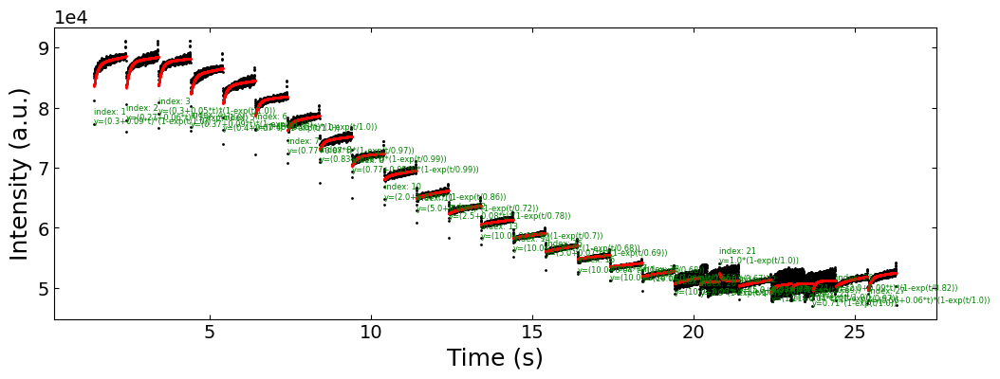

MSE loss:  tensor(0.0041)


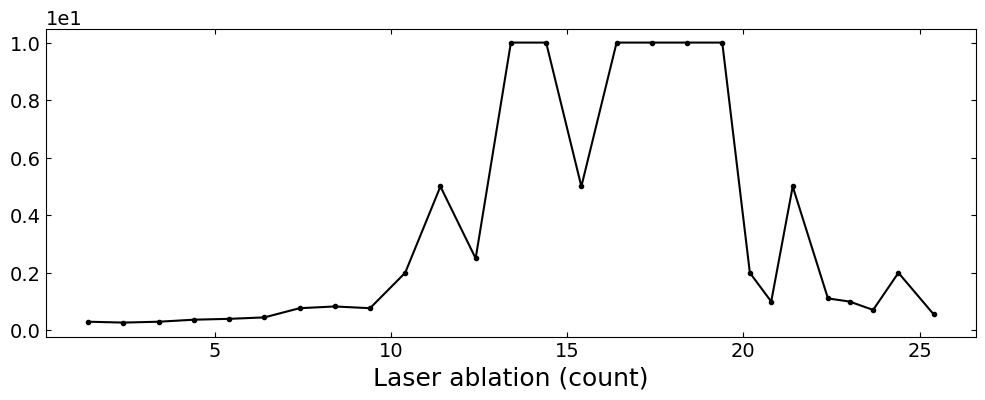

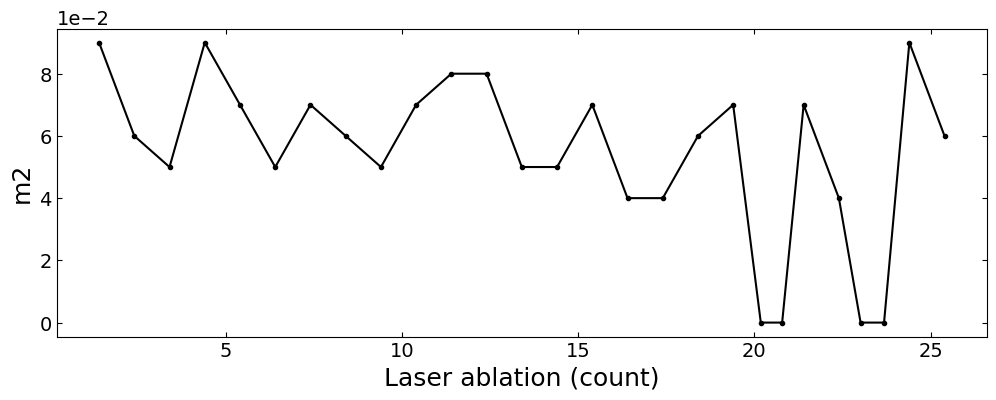

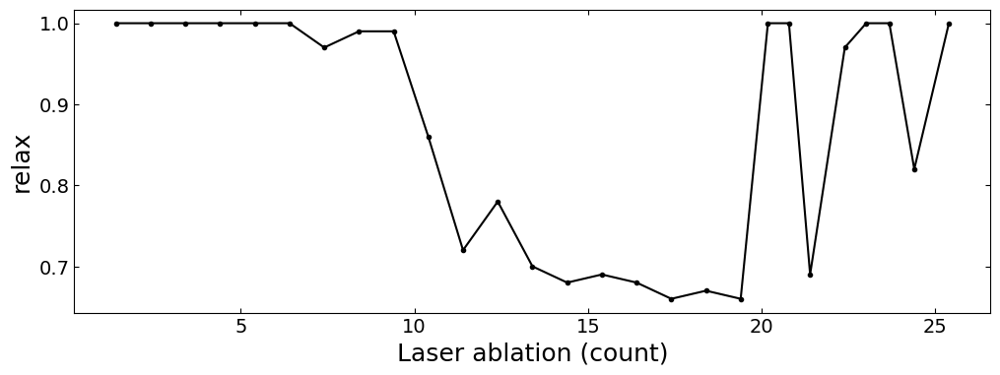

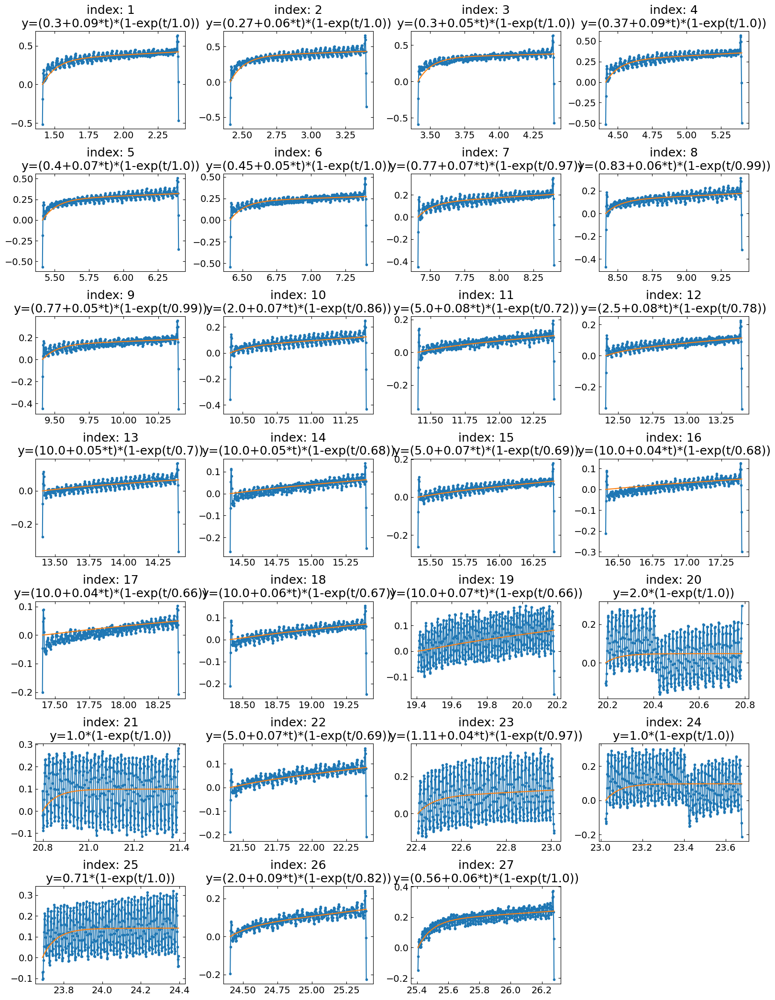

growth_02 :


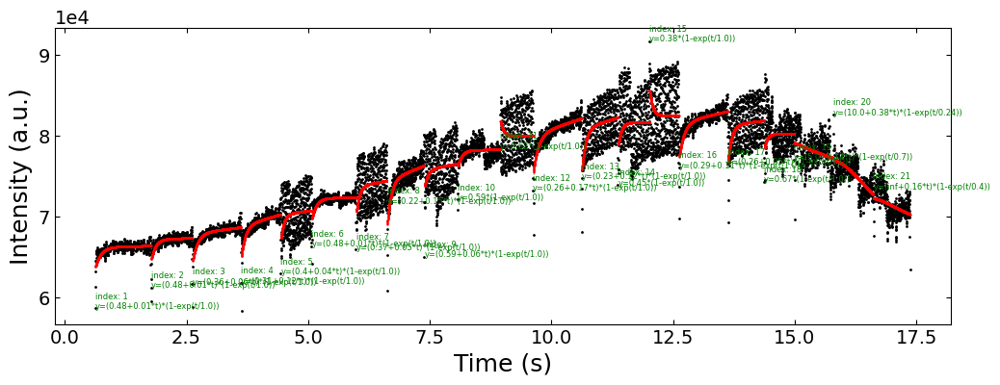

MSE loss:  tensor(0.0289)


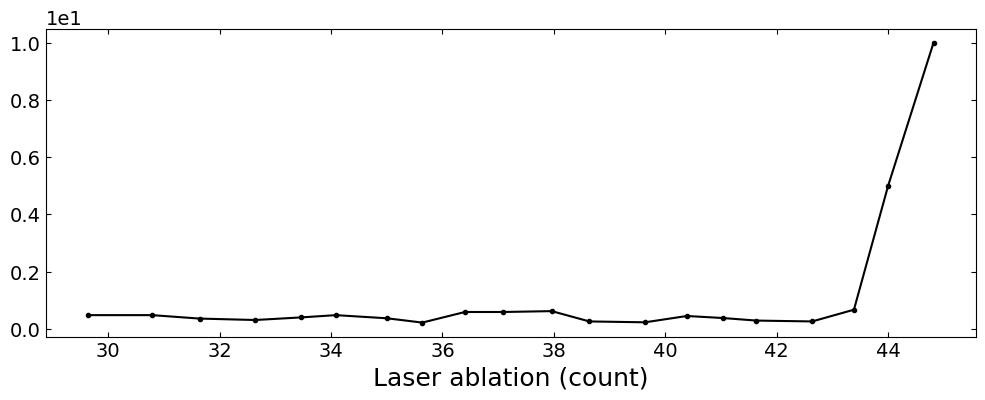

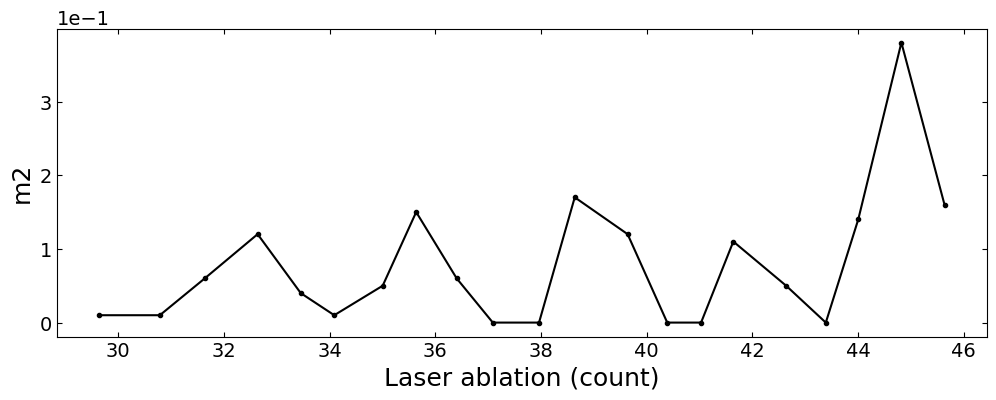

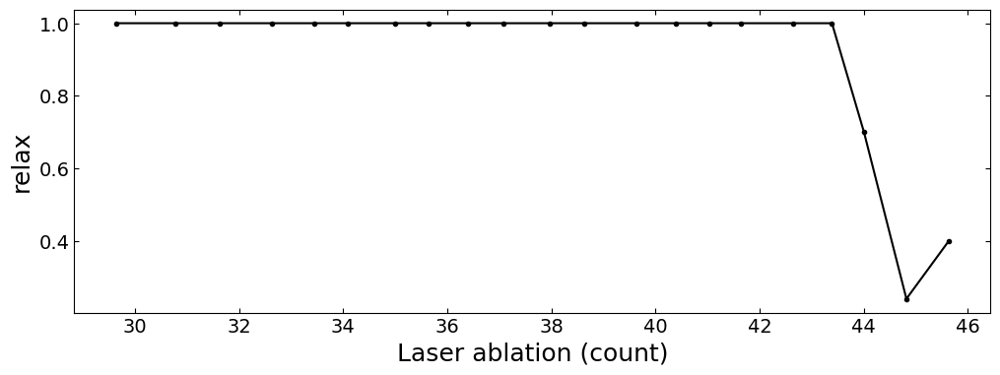

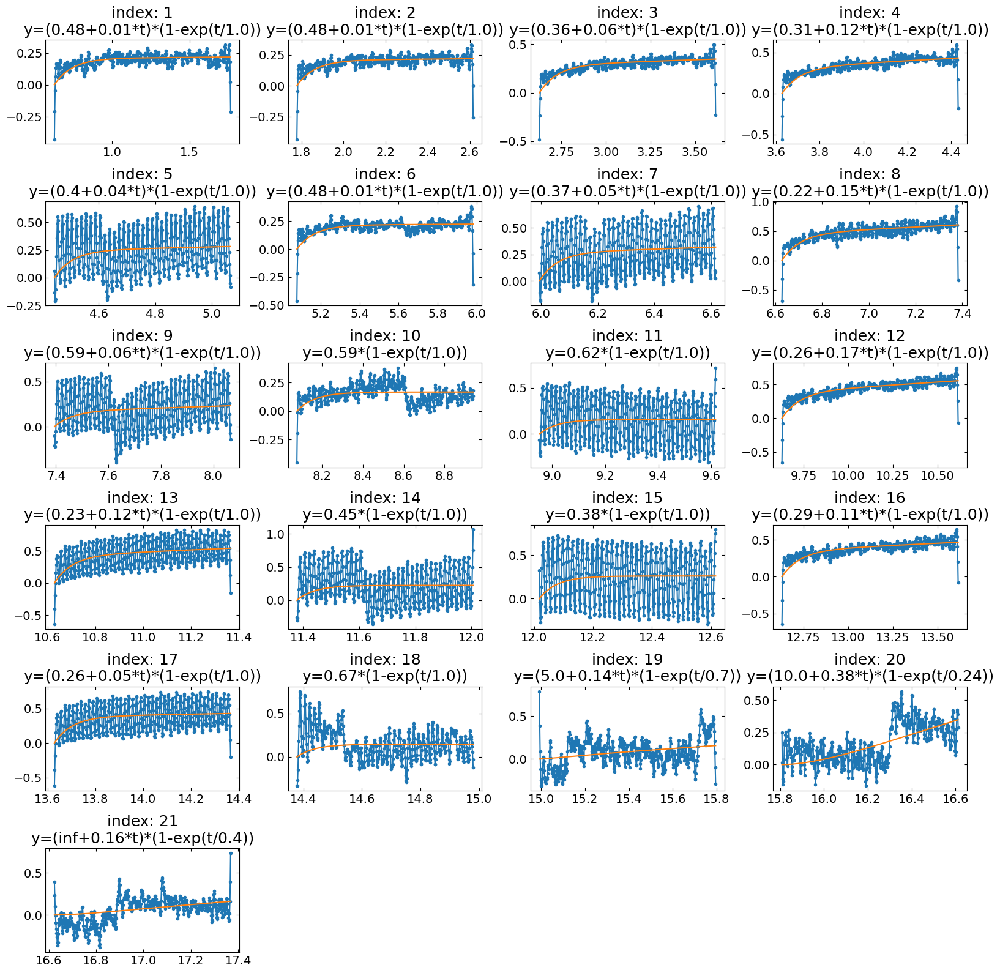

growth_03 :


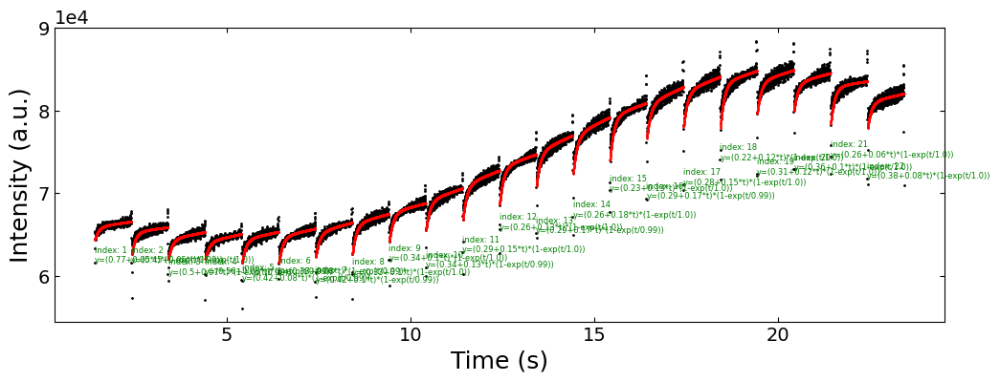

MSE loss:  tensor(0.0035)


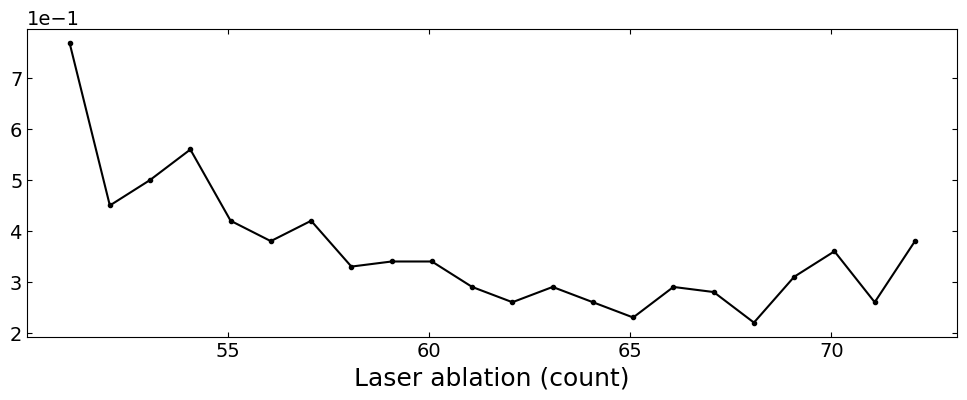

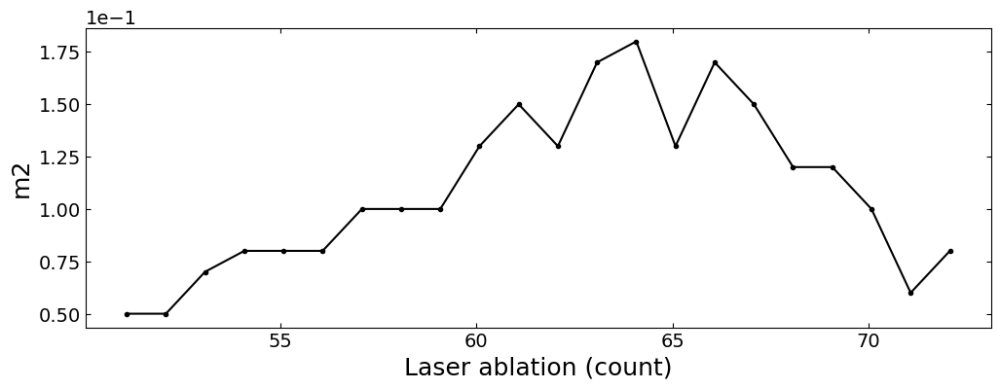

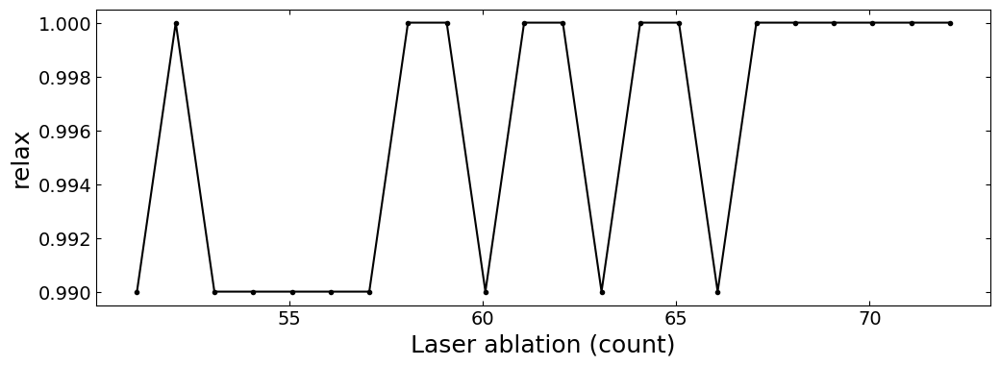

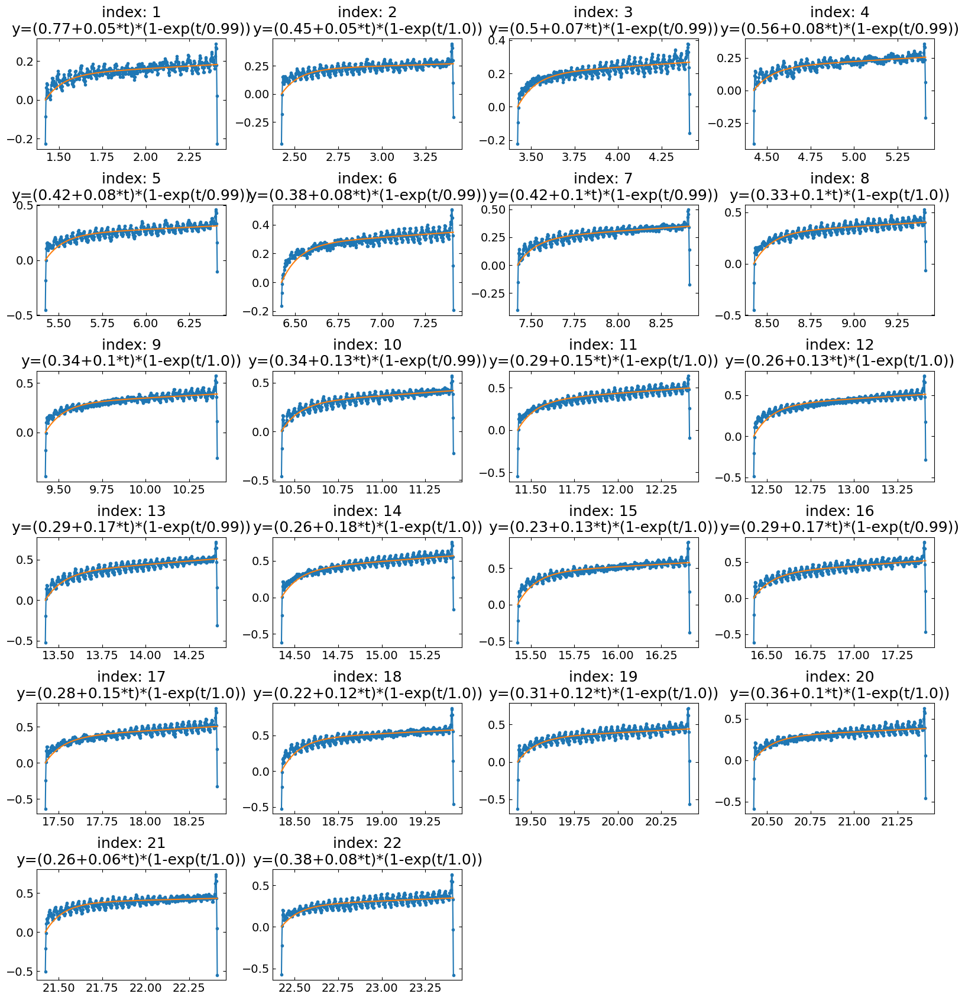

growth_04 :


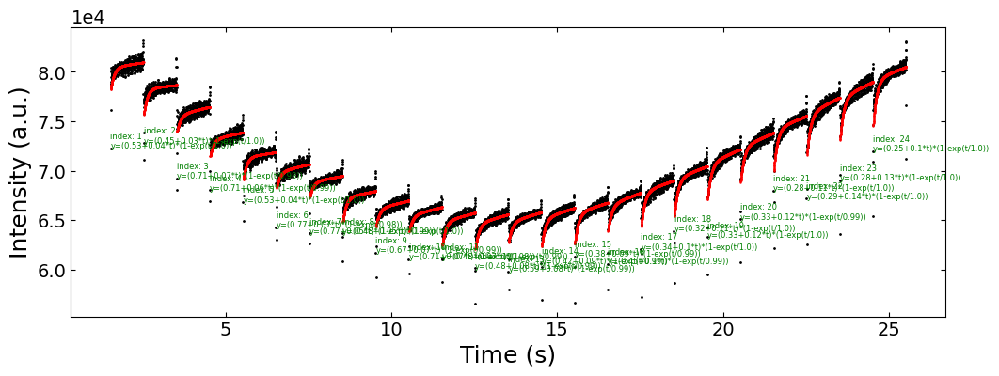

MSE loss:  tensor(0.0026)


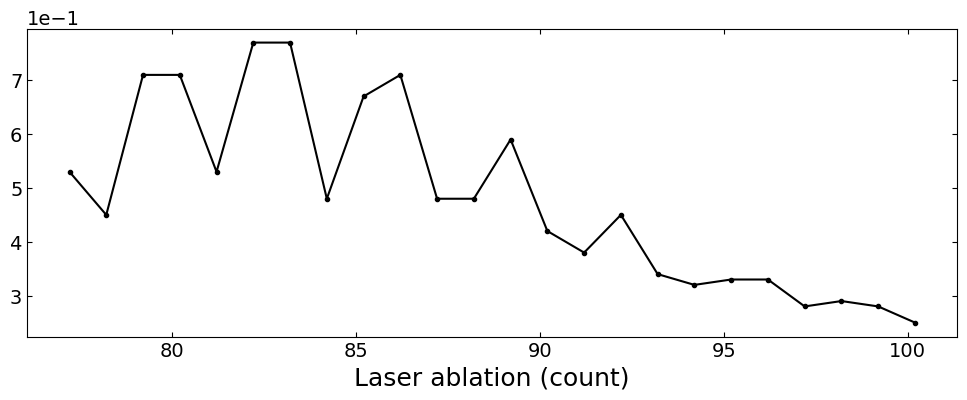

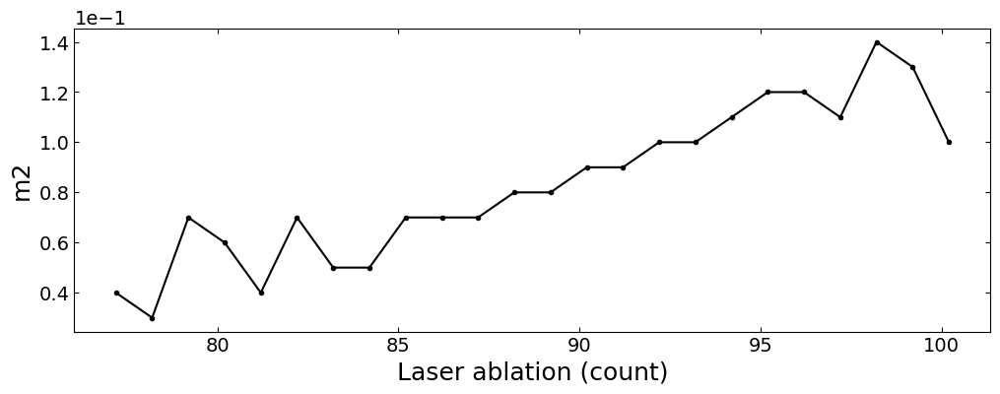

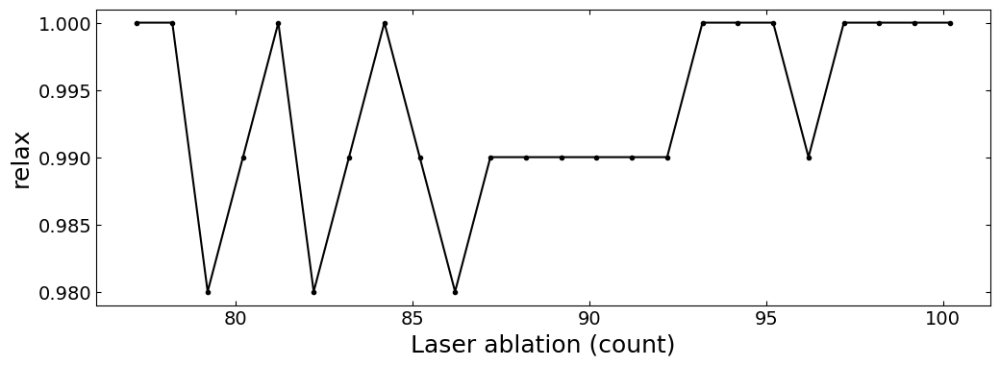

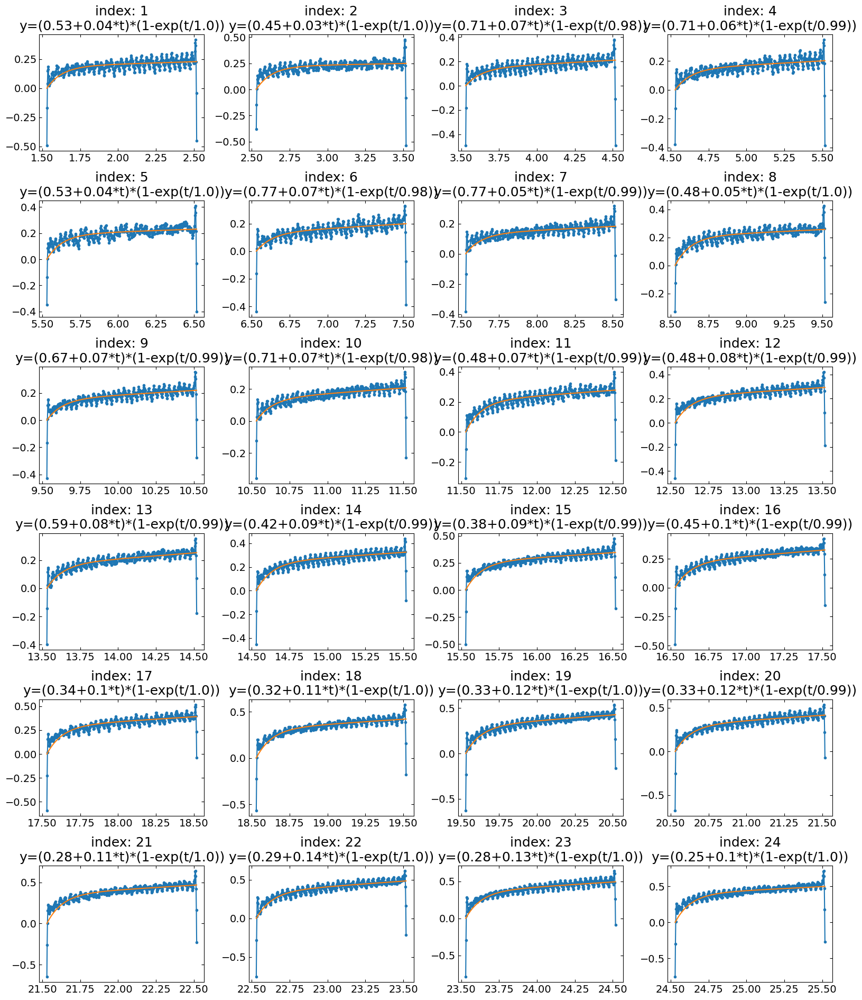

growth_05 :


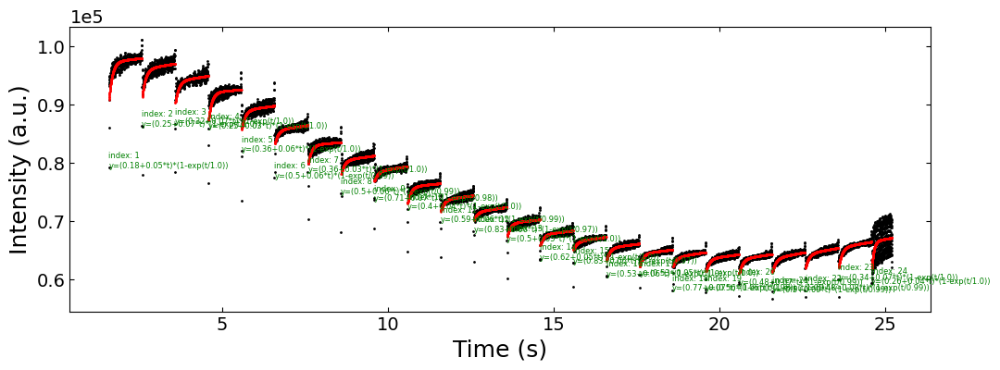

MSE loss:  tensor(0.0053)


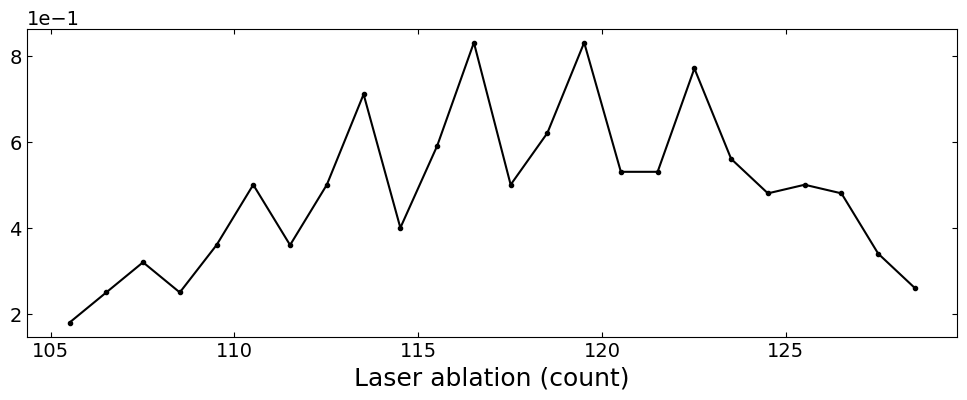

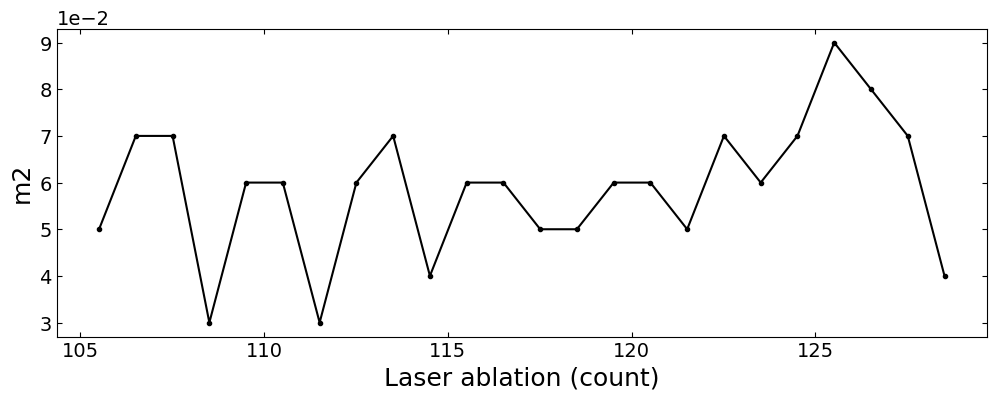

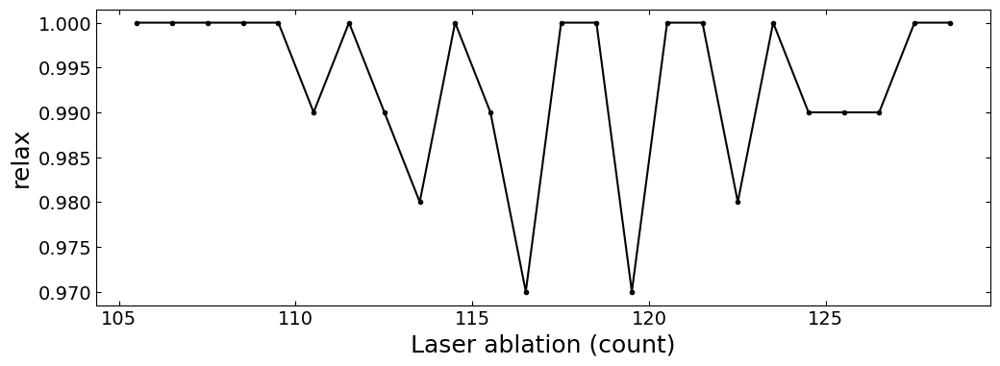

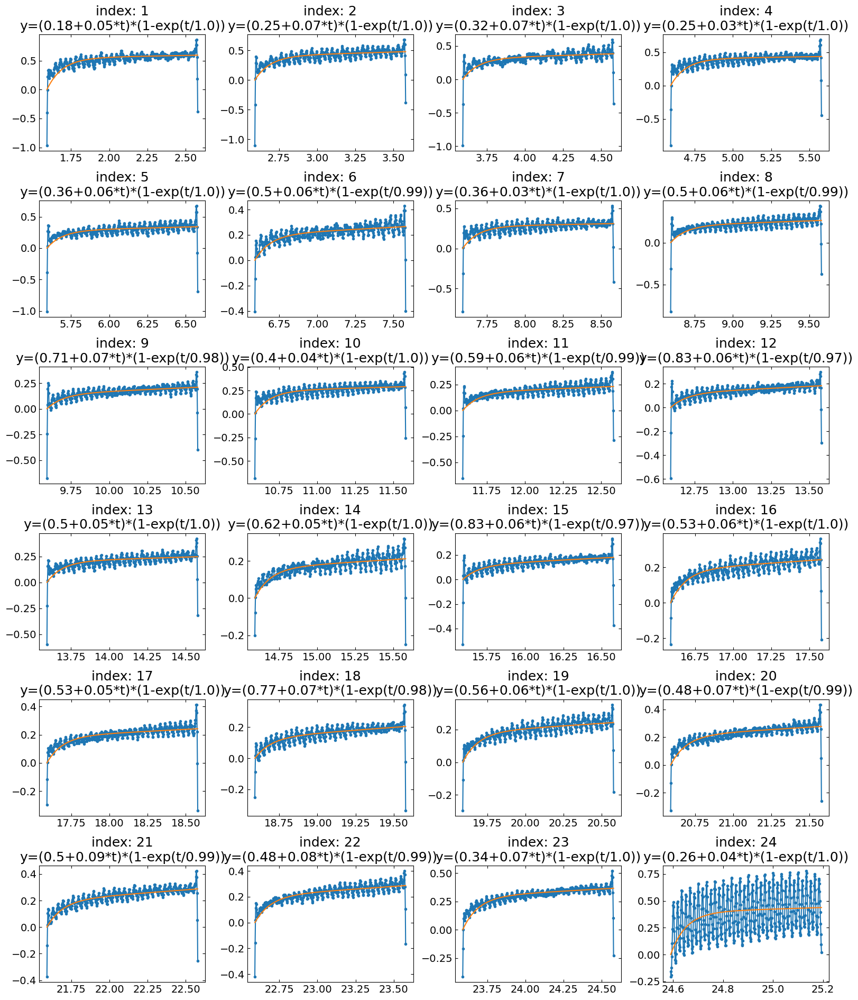

In [18]:
NAME = f'test9_model-baseline'
model_path = '../models/'+NAME+'.pt'

plt.rcParams.update(rc_plot)
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=1000)
parameters_all, x_coor_all, info = analyze_curves_dl(h5_para_file, growth_dict, spot, metric, camera_freq=500, interval=1000, length=500, 
                                                     savgol_window_order=(15,3), pca_component=10,
                                                     visualize=True, I_diff=12000, model_path=model_path)
x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test9_fitting_results(DL).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

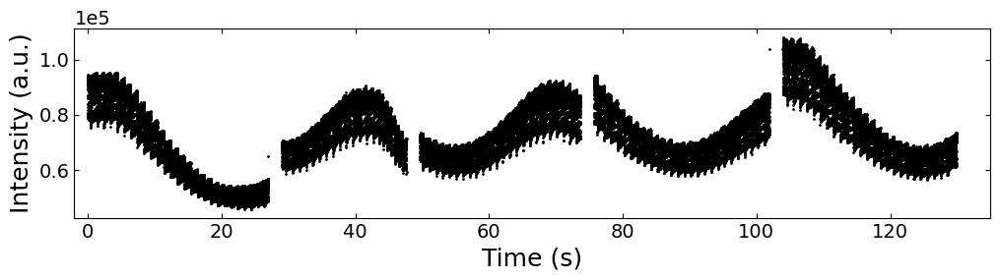

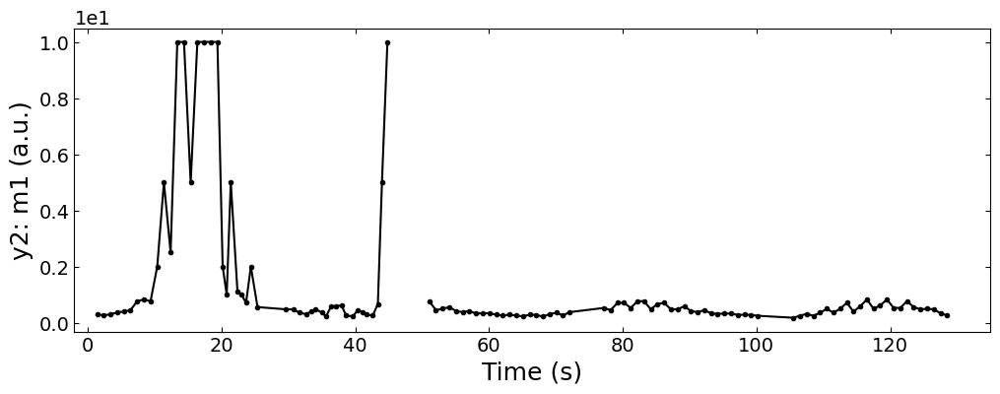

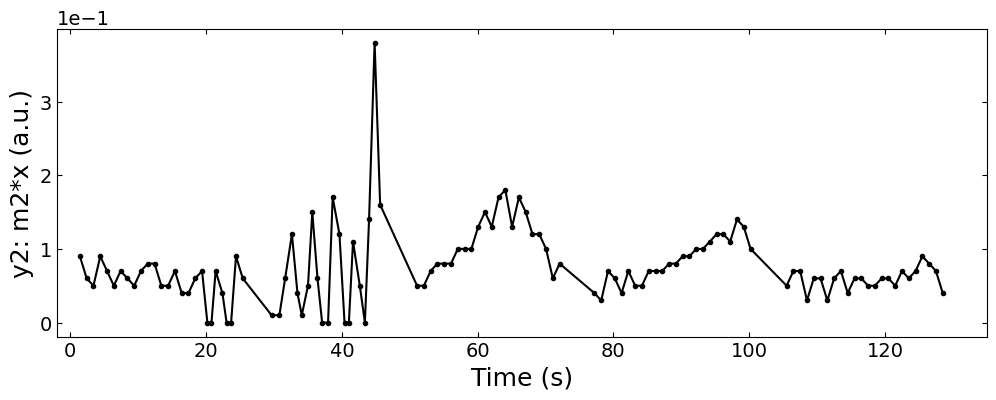

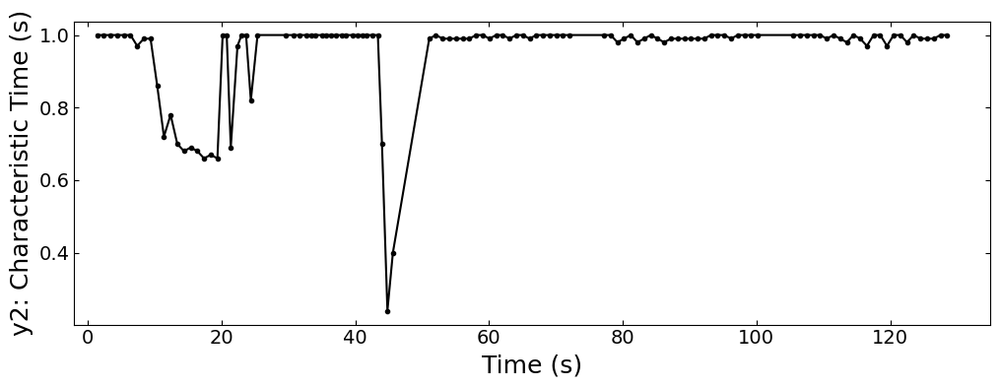

MSE loss for DL model fitting is: 0.00833841044958037


In [19]:
visualize_predictions(x_all, y_all, parameters_all, x_coor_all, info)

# 3. Violinplot of results

In [ ]:
x_test6_sklearn, tau_test6_sklearn = np.swapaxes(np.load('../saved_data/test6_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test7_sklearn, tau_test7_sklearn = np.swapaxes(np.load('../saved_data/test7_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test9_sklearn, tau_test9_sklearn = np.swapaxes(np.load('../saved_data/test9_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]

x_test6_sklearn, tau_test6_sklearn = remove_outlier(x_test6_sklearn, tau_test6_sklearn, 0.9)
x_test7_sklearn, tau_test7_sklearn = remove_outlier(x_test7_sklearn, tau_test7_sklearn, 0.9)
x_test9_sklearn, tau_test9_sklearn = remove_outlier(x_test9_sklearn, tau_test9_sklearn, 0.9)

data = [tau_test6_sklearn, tau_test7_sklearn, tau_test9_sklearn]
fig, ax = plt.subplots(figsize=(12,4))

titles = ['Treated substrate\n(step width=0.43±0.04μm)',
          'Treated substrate\n(step width=0.11±0.01μm)',
          'Untreated substrate\n(step width=0.28±0.03μm)']
ax = sns.violinplot(data=data, palette=[color_green, color_orange, color_purple], linewidth=0.8)
ax.set_xticklabels(titles)

label_violinplot(ax, data, label_type='average', text_pos='right')
ax.set_ylabel('Characteristic Time (s)')
plt.savefig('../figures/4.violinplot_plot(sklearn).svg', bbox_inches='tight', dpi=300)
plt.show()

In [26]:
from scipy.stats import zscore
def remove_outlier(x, y, ub):
    z = zscore(y, axis=0, ddof=0)
    x = np.delete(x, np.where(z>ub))
    y = np.delete(y, np.where(z>ub))
    return x, y

(223,) (211,) (118,)
(177,) (159,) (118,)


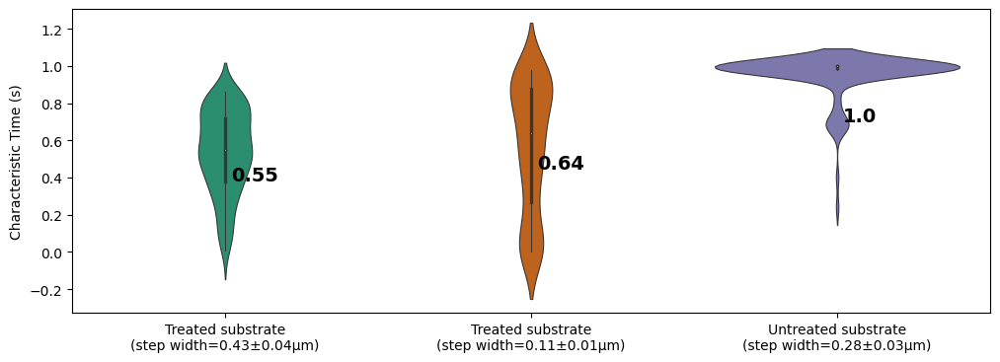

In [31]:
x_test6_DL, tau_test6_DL = np.swapaxes(np.load('../saved_data/test6_fitting_results(DL).npy'), 0, 1)[[0,-1]]
x_test7_DL, tau_test7_DL = np.swapaxes(np.load('../saved_data/test7_fitting_results(DL).npy'), 0, 1)[[0,-1]]
x_test9_DL, tau_test9_DL = np.swapaxes(np.load('../saved_data/test9_fitting_results(DL).npy'), 0, 1)[[0,-1]]

print(tau_test6_DL.shape, tau_test7_DL.shape, tau_test9_DL.shape)
x_test6_DL, tau_test6_DL = remove_outlier(x_test6_DL, tau_test6_DL, 0.9)
x_test7_DL, tau_test7_DL = remove_outlier(x_test7_DL, tau_test7_DL, 0.9)
x_test9_DL, tau_test9_DL = remove_outlier(x_test9_DL, tau_test9_DL, 0.9)
print(tau_test6_DL.shape, tau_test7_DL.shape, tau_test9_DL.shape)

data = [tau_test6_DL, tau_test7_DL, tau_test9_DL]
fig, ax = plt.subplots(figsize=(12,4))

titles = ['Treated substrate\n(step width=0.43±0.04μm)',
          'Treated substrate\n(step width=0.11±0.01μm)',
          'Untreated substrate\n(step width=0.28±0.03μm)']
ax = sns.violinplot(data=data, palette=[color_green, color_orange, color_purple], linewidth=0.8)
ax.set_xticklabels(titles)

label_violinplot(ax, data, label_type='average', text_pos='right')
ax.set_ylabel('Characteristic Time (s)')
plt.savefig('../figures/4.violinplot_plot(DL).svg', bbox_inches='tight', dpi=300)
plt.show()

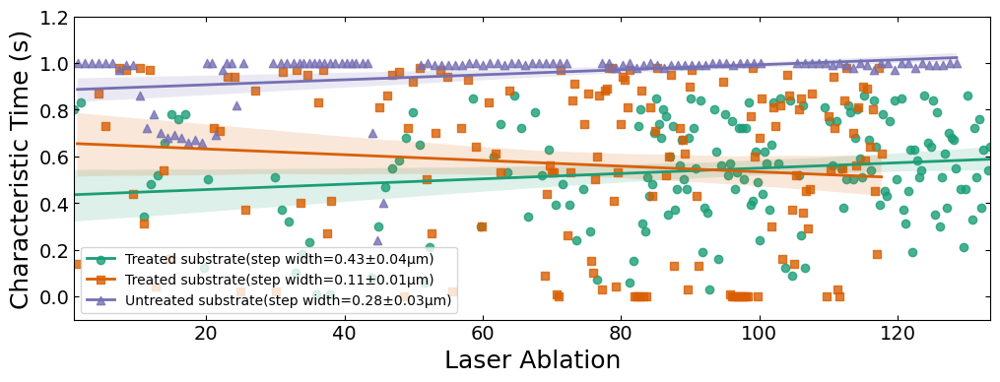

In [33]:
plt.rcParams.update(rc_plot)
titles = ['Treated substrate(step width=0.43±0.04μm)',
          'Treated substrate(step width=0.11±0.01μm)',
          'Untreated substrate(step width=0.28±0.03μm)']


fig, ax = plt.subplots(1, 1, figsize=(12,4))
    
sns.regplot(ax=ax, x=x_test6_DL, y=tau_test6_DL, label=titles[0], 
            line_kws={'lw': 2, 'label': titles[0]},
            scatter=True, marker='o', color=color_green)
sns.regplot(ax=ax, x=x_test7_DL, y=tau_test7_DL, label=titles[1],
            line_kws={'lw': 2, 'label': titles[1]},
            scatter=True, marker='s', color=color_orange)
sns.regplot(ax=ax, x=x_test9_DL, y=tau_test9_DL, label=titles[2],
            line_kws={'lw': 2, 'label': titles[2]},
            scatter=True, marker='^', color=color_purple)
handles, labels = ax.get_legend_handles_labels()

n = 3
plt.legend(handles=[(h1, h2) for h1, h2 in zip(handles[:n], handles[n:])], labels=labels[n:], 
           fontsize=10)

plt.xlabel('Laser Ablation')
plt.ylabel('Characteristic Time (s)')
plt.ylim(-0.1, 1.2)
plt.savefig('../figures/4.linear_trend(sklearn).svg', bbox_inches='tight', dpi=300)
plt.show()